In [487]:
import itertools
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import math

In [5]:
def enumerate2(xs, start=0, step=1):
    for x in xs:
        yield (start, x)
        start += step

# Boolean sentances

In [6]:
class subset:
    # conjucted subset
    def __init__(self,vertexes : set):
        self.subset = vertexes;

In [7]:
class Logical_block:
    #(a1 v a2 v a3 v...v an)
    def __init__(self,subsets : list):
        self.block = subsets;
    def simplify(self):
        self.block.sort(key=len);
        n = len(self.block)
        i = 0
        while i < n:
            j = i + 1
            while j < n:
                if self.block[i] <= self.block[j]:
                    self.block.pop(j)
                    n -= 1
                else:
                    j += 1
            i += 1
    def __mul__(self, other):
        out = Logical_block([x.union(y) for x in self.block for y in other.block])
        out.simplify()
        return out
    def __len__(self):
        return len(self.block)
    def show(self):
        print('(',end='')
        print(*self.block,sep='v',end=')')

In [8]:
class Logical_sentance:
    def __init__(self,subsets : list):
        self.body = subsets;
    def from_cnf_to_dnf(self):
        for i in range(0,len(self.body)-1):
            f = self.body.pop()
            s = self.body.pop()
            self.body.insert(0,f*s)
    def show(self):
        for i in self.body:
            i.show()
    def sort(self):
        self.body.sort(key=len)
    def to_list_for_dnf(self):
        #only for dnf
        return self.body[0].block

In [9]:
list1=Logical_block([{1},{2}])
list2=Logical_block([{2},{3}])

a = (list1*list2)
a.show()

({2}v{1, 3})

In [10]:
a = Logical_sentance([Logical_block([{2},{5}]),Logical_block([{6},{1}]),Logical_block([{4},{3}])])
a.show()

({2}v{5})({6}v{1})({4}v{3})

In [11]:
a.from_cnf_to_dnf()
a.show()

({2, 4, 6}v{1, 2, 4}v{2, 3, 6}v{1, 2, 3}v{4, 5, 6}v{1, 4, 5}v{3, 5, 6}v{1, 3, 5})

In [12]:
a = Logical_sentance([Logical_block([{1},{2}]),Logical_block([{2},{3}]),Logical_block([{3},{4}])])

In [13]:
a.from_cnf_to_dnf()
a.show()

({1, 3}v{2, 3}v{2, 4})

In [14]:
a = Logical_sentance([Logical_block([{1},{2}]),Logical_block([{2},{3},{4}]),Logical_block([{4},{5}])])

In [15]:
a.from_cnf_to_dnf()
a.show()

({1, 4}v{2, 4}v{2, 5}v{1, 3, 5})

In [16]:
a = Logical_sentance([Logical_block([{1},{3}]),Logical_block([{2},{4}]),Logical_block([{4},{1}])])

In [17]:
a.from_cnf_to_dnf()
a.show()

({1, 4}v{1, 2}v{3, 4})

# Graph

In [433]:
""" A Python Class
A simple Python graph class, demonstrating the essential 
facts and functionalities of graphs.
"""


class Graph(object):

    def __init__(self, graph_dict=None):
        """ initializes a graph object 
            If no dictionary or None is given, 
            an empty dictionary will be used
        """
        if graph_dict == None:
            self.__graph_dict = {}
        if type(graph_dict) == dict:
            self.__graph_dict = graph_dict
        elif type(graph_dict) == list:
            self.__graph_dict = {}
            for pair in graph_dict:
                l = list(pair)
                if (l[0] in self.__graph_dict):
                    self.__graph_dict[l[0]].append(l[1])
                else:
                    self.__graph_dict[l[0]] = [l[1]]
                if (l[1] in self.__graph_dict):
                    self.__graph_dict[l[1]].append(l[0])
                else:
                    self.__graph_dict[l[1]] = [l[0]]
    def adjacency_dict(self):
        return self.__graph_dict
    def vertices(self):
        """ returns the vertices of a graph """
        return sorted(list(self.__graph_dict.keys()),key=lambda x: int(x))

    def edges(self):
        """ returns the edges of a graph """
        return self.__generate_edges()
    
    def add_vertex(self, vertex):
        """ If the vertex "vertex" is not in 
            self.__graph_dict, a key "vertex" with an empty
            list as a value is added to the dictionary. 
            Otherwise nothing has to be done. 
        """
        if vertex not in self.__graph_dict:
            self.__graph_dict[vertex] = []

    def add_edge(self, edge):
        """ assumes that edge is of type set, tuple or list; 
            between two vertices can be multiple edges! 
        """
        edge = set(edge)
        (vertex1, vertex2) = tuple(edge)
        if vertex1 in self.__graph_dict:
            self.__graph_dict[vertex1].append(vertex2)
        else:
            self.__graph_dict[vertex1] = [vertex2]

    def __generate_edges(self):
        """ A static method generating the edges of the 
            graph "graph". Edges are represented as sets 
            with one (a loop back to the vertex) or two 
            vertices 
        """
        edges = []
        for vertex in self.__graph_dict:
            for neighbour in self.__graph_dict[vertex]:
                if neighbour != vertex:
                    if sorted([neighbour, vertex],key=lambda x: int(x)) not in edges:
                        edges.append(sorted([vertex, neighbour],key=lambda x: int(x)))
                else:
                    if [neighbour] not in edges:
                        edges.append([neighbour])
        return edges
    
    def __eq__(self, other):
        return self.edges == other.edges
    
    def __eq__(self, other):
        return self.edges != other.edges
    
    def __str__(self):
        res = "vertices: "
        for k in sorted(self.__graph_dict,key=lambda x: int(x)):
            res += str(k) + " "
        res += "\nedges: "
        for edge in sorted(self.__generate_edges()):
            res += str(sorted(edge,key=lambda x: int(x))) + " "
        return res
    def check_connection(self,a,b):
        return b in self.__graph_dict[a]
    def make_antigraph(self):
        out  = {}
        for i in self.vertices():
            out[i] = set(self.vertices()) - set(self.__graph_dict[i]) - {i}
        return Graph(out)
    def make_logical(self):
        sent = []
        for edge in self.edges():
            block = []
            for vertex in edge:
                #block.append(set(vertex))
                block.append(set([vertex]))
            sent.append(Logical_block(block))
        return(Logical_sentance(sent))
    def max_cliques(self):
        anti_graph = self.make_antigraph()
        logical_anti_graph = anti_graph.make_logical()
        logical_anti_graph.from_cnf_to_dnf()
        out = []
        if logical_anti_graph.body == []:
            return [set(self.vertices())]
        for i in logical_anti_graph.body[0].block:
            out.append(set(self.vertices()) - i)
        return out
    def get_subgraph(self,vertices):
        out = {}
        extra = set(self.vertices()) - set(vertices)
        for vertex in vertices:
            out[vertex] = list(set(self.__graph_dict[vertex]) - set(extra))
        return Graph(out)

In [434]:
g = { "1" : ["2","3","4"],
          "2" : ["1","3","5"],
          "3" : ["1","2","6"],
          "4" : ["5","6","1"],
          "5" : ["4","6","2"],
          "6" : ["3","5","4"]
        }
graph = Graph(g)
print(Graph(graph.edges()))
print(graph.edges())
max_cliques = graph.max_cliques()
print(max_cliques)   

vertices: 1 2 3 4 5 6 
edges: ['1', '2'] ['1', '3'] ['1', '4'] ['2', '3'] ['2', '5'] ['3', '6'] ['4', '5'] ['4', '6'] ['5', '6'] 
[['1', '2'], ['1', '3'], ['1', '4'], ['2', '3'], ['2', '5'], ['3', '6'], ['4', '5'], ['4', '6'], ['5', '6']]
[{'5', '4', '6'}, {'2', '3', '1'}, {'5', '2'}, {'6', '3'}, {'4', '1'}]


In [435]:
g = { 1 : [2,3,4],
          2 : [1,3,5],
          3 : [1,2,6],
          4 : [5,6,1],
          5 : [4,6,2],
          6 : [3,5,4]
        }
graph = Graph(g)
print(Graph(graph.edges()))
print(graph.edges())
max_cliques = graph.max_cliques()
print(max_cliques)   

vertices: 1 2 3 4 5 6 
edges: [1, 2] [1, 3] [1, 4] [2, 3] [2, 5] [3, 6] [4, 5] [4, 6] [5, 6] 
[[1, 2], [1, 3], [1, 4], [2, 3], [2, 5], [3, 6], [4, 5], [4, 6], [5, 6]]
[{4, 5, 6}, {1, 2, 3}, {2, 5}, {3, 6}, {1, 4}]


In [640]:
def demonstrate(graphs,cols,tipe='kamada',title=None,with_labels=False):
    n=len(graphs)
    fig = plt.figure(figsize=(cols*3,3*n//cols))
    fig.patch.set_facecolor('white') # To make copying possible (white background)
    if title != None:
        fig.suptitle(title, fontsize="x-large")
    for i in range(n):
        plt.subplot(n//cols,cols,i+1)
        g = nx.Graph() # Generate a Networkx object

        for e in graphs[i]:            
            g.add_edge(e[0],e[1])
        if tipe == 'kamada':
            if with_labels:
                nx.draw(g,with_labels=True, node_size=0.1)
            else:
                nx.draw_kamada_kawai(g, node_size=20)
        elif tipe == 'shell':
            if with_labels:
                nx.draw(g,pos=nx.shell_layout(g),with_labels=True, node_size=0.1)
            else:
                nx.draw_shell(g, node_size=20)
        elif tipe == 'bipartite':
            try:
                nx.draw(g, pos=nx.bipartite_layout(g, nx.bipartite.sets(g)[0]))
            except:
                nx.draw_kamada_kawai(g, node_size=20)
    print('.', end='')

# Cycles

In [21]:
def hypergraph_to_graph(hypergraph):
    out = {}
    for edge in hypergraph:
        e_list = list(edge)
        if len(e_list) == 1:
            out[e_list[0]] = {}
        for i,first in enumerate(e_list):
            for j in range(i+1,len(e_list)):
                if first in out:
                    out[first].add(e_list[j])
                else:
                    out[first] = {e_list[j]}
                if e_list[j] in out:
                    out[e_list[j]].add(first)
                else:
                    out[e_list[j]] = {first}
    return Graph(out)

In [437]:
def dualisation_for_hypergraph(hypergraph):
    sent = []
    for edge in hypergraph:
        block = []
        for vertex in edge:
            block.append(set([vertex]))
        sent.append(Logical_block(block))
    return(Logical_sentance(sent))

In [438]:
g = { "1" : {"2","3","4"},
          "2" : {"1","3","5"},
          "3" : {"1","2","6"},
          "4" : {"5","6","1"},
          "5" : {"4","6","2"},
          "6" : {"3","5","4"}
        }
graph = Graph(g)
print(graph)

vertices: 1 2 3 4 5 6 
edges: ['1', '2'] ['1', '3'] ['1', '4'] ['2', '3'] ['2', '5'] ['3', '6'] ['4', '5'] ['4', '6'] ['5', '6'] 


In [24]:
#hashing as strings!!!

In [25]:
def start_cycles(graph,p=False,out=False,_all=False,debug = False,max_steps=100):
    #structs
    graphs = {str(graph)}
    graphs_to_iter = dict()
    graphs_to_iter[str(graph)] = 0
    iter_to_graphs = [graph]
    #operations
    max_cliques = graph.max_cliques()
    if debug:
        print('h^c',max_cliques)
    d_max_cliques = dualisation_for_hypergraph(max_cliques)
    d_max_cliques.from_cnf_to_dnf()
    if debug:
        print('h^cd')
        d_max_cliques.show()
        print('\n')
    g_n = hypergraph_to_graph(d_max_cliques.to_list_for_dnf())
    steps = 1
    while (str(g_n) not in graphs) and max_steps > steps:
        graphs.add(str(g_n))
        graphs_to_iter[str(g_n)] = steps
        iter_to_graphs.append(g_n)
        max_cliques = g_n.max_cliques()
        if debug:
            print('h^'+'cd'*steps+'c',max_cliques,g_n)
        d_max_cliques = dualisation_for_hypergraph(max_cliques)
        d_max_cliques.from_cnf_to_dnf()
        if debug:
            print('h^'+'cd'*steps+'cd')
            d_max_cliques.show()
            print('\n')
        g_n = hypergraph_to_graph(d_max_cliques.to_list_for_dnf())
        if debug:
            print('h^'+'cd'*steps+'cd',g_n)
        steps+=1
    if p:
        print(g_n)
        print("steps:",steps)
        print("cycle lenth:", steps - graphs_to_iter[str(g_n)],end='\n\n')
        for i in range(steps):
            print("step=",i)
            print(iter_to_graphs[i],end='\n\n')
    if _all:
        for i in iter_to_graphs:
            print(i)
    if out:
        cycle_lenth  = steps - graphs_to_iter[str(g_n)]
        head_lenth = steps - cycle_lenth
        return head_lenth, cycle_lenth, iter_to_graphs[steps - cycle_lenth], iter_to_graphs[steps-1]

In [26]:
head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,True,True)

vertices: 1 2 3 4 5 6 
edges: ['1', '2'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '3'] ['2', '4'] ['2', '6'] ['3', '4'] ['3', '5'] ['4', '5'] ['4', '6'] ['5', '6'] 
steps: 3
cycle lenth: 2

step= 0
vertices: 1 2 3 4 5 6 
edges: ['1', '2'] ['1', '3'] ['1', '4'] ['2', '3'] ['2', '5'] ['3', '6'] ['4', '5'] ['4', '6'] ['5', '6'] 

step= 1
vertices: 1 2 3 4 5 6 
edges: ['1', '2'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '3'] ['2', '4'] ['2', '6'] ['3', '4'] ['3', '5'] ['4', '5'] ['4', '6'] ['5', '6'] 

step= 2
vertices: 1 2 3 4 5 6 
edges: ['1', '4'] ['2', '5'] ['3', '6'] 



In [27]:
print(cycle_lenth)

2


In [28]:
print(cycle_start)

vertices: 1 2 3 4 5 6 
edges: ['1', '2'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '3'] ['2', '4'] ['2', '6'] ['3', '4'] ['3', '5'] ['4', '5'] ['4', '6'] ['5', '6'] 


In [29]:
print(cycle_fin)

vertices: 1 2 3 4 5 6 
edges: ['1', '4'] ['2', '5'] ['3', '6'] 


In [30]:
g = { "1" : {"2"},
          "2" : {"1","3"},
          "3" : {"2","4"},
          "4" : {"3"}
        }
graph = Graph(g)
head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True,True)
print("lenth_of_cycle:",cycle_lenth)
print("cycle_start",cycle_start)
print("cycle_fin",cycle_fin)

vertices: 1 2 3 4 
edges: ['1', '2'] ['2', '3'] ['3', '4'] 
vertices: 1 2 3 4 
edges: ['1', '3'] ['2', '3'] ['2', '4'] 
lenth_of_cycle: 2
cycle_start vertices: 1 2 3 4 
edges: ['1', '2'] ['2', '3'] ['3', '4'] 
cycle_fin vertices: 1 2 3 4 
edges: ['1', '3'] ['2', '3'] ['2', '4'] 


In [31]:
g = [{"1","2"},{"2","3","4"},{"4","5"}]
graph = hypergraph_to_graph(g)
head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True)
print("lenth_of_cycle:",cycle_lenth)
print("cycle_start",cycle_start)
print("cycle_fin",cycle_fin)

lenth_of_cycle: 2
cycle_start vertices: 1 2 3 4 5 
edges: ['1', '2'] ['2', '3'] ['2', '4'] ['3', '4'] ['4', '5'] 
cycle_fin vertices: 1 2 3 4 5 
edges: ['1', '3'] ['1', '4'] ['1', '5'] ['2', '4'] ['2', '5'] ['3', '5'] 


In [32]:
g = [{"1","2","6"},{"1","3","5"},{"2","3","4"}]
graph = hypergraph_to_graph(g)
head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True)
print("lenth_of_cycle:",cycle_lenth)
print("cycle_start",cycle_start)
print("cycle_fin",cycle_fin)

lenth_of_cycle: 2
cycle_start vertices: 1 2 3 4 5 6 
edges: ['1', '2'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '3'] ['2', '4'] ['2', '6'] ['3', '4'] ['3', '5'] ['4', '5'] ['4', '6'] ['5', '6'] 
cycle_fin vertices: 1 2 3 4 5 6 
edges: ['1', '4'] ['2', '5'] ['3', '6'] 


# Graph Generation

In [33]:
def make_graphs(n=2, i=None, j=None):
    """Make a graph recursively, by either including, or skipping each edge.

    Edges are given in lexicographical order by construction."""
    out = []
    if i is None: # First call

        out  = [[(0,1)]+r for r in make_graphs(n=n, i=0, j=1)]
    elif j<n-1:
        out += [[(i,j+1)]+r for r in make_graphs(n=n, i=i, j=j+1)]
        out += [          r for r in make_graphs(n=n, i=i, j=j+1)]
    elif i<n-1:
        out = make_graphs(n=n, i=i+1, j=i+1)
    else:
        out = [[]]
    return out

In [34]:
def perm(n, s=None):
    """All permutations of n elements."""
    if s is None: return perm(n, tuple(range(n)))
    if not s: return [[]]
    return [[i]+p for i in s for p in perm(n, tuple([k for k in s if k!=i]))]


In [35]:
def permute(g, n):
    """Create a set of all possible isomorphic codes for a graph,

    as nice hashable tuples. All edges are i<j, and sorted lexicographically."""
    ps = perm(n)
    out = set([])
    for p in ps:
        out.add(tuple(sorted([(p[i],p[j]) if p[i]<p[j]
                              else (p[j],p[i]) for i,j in g])))
    return list(out)

In [36]:
def connected(g):
    """Check if the graph is fully connected, with Union-Find."""
    nodes = set([i for e in g for i in e])
    roots = {node: node for node in nodes}

    def _root(node, depth=0):
        if node==roots[node]: return (node, depth)
        else: return _root(roots[node], depth+1)

    for i,j in g:
        ri,di = _root(i)
        rj,dj = _root(j)
        if ri==rj: continue
        if di<=dj: roots[ri] = rj
        else:      roots[rj] = ri
    return len(set([_root(node)[0] for node in nodes]))==1

In [37]:
def filter(gs, target_nv):
    """Filter all improper graphs: those with not enough nodes,

    those not fully connected, and those isomorphic to previously considered."""
    mem = set({})
    gs2 = []
    for g in gs:
        #nv = len(set([i for e in g for i in e]))
        #if nv != target_nv:
            #continue
        #if not connected(g):
            #continue
        if tuple(g) not in mem:
            gs2.append(g)
            mem |= set(permute(g, target_nv))
    return gs2

In [38]:
def plot_graphs(graphs, figsize=14, dotsize=20):
    """Utility to plot a lot of graphs from an array of graphs.

    Each graphs is a list of edges; each edge is a tuple."""
    n = len(graphs)
    fig = plt.figure(figsize=(figsize,figsize))
    fig.patch.set_facecolor('white') # To make copying possible (white background)

    k = int(np.sqrt(n))
    for i in range(n):
        plt.subplot(k+1,k+1,i+1)
        g = nx.Graph() # Generate a Networkx object

        for e in graphs[i]:            
            g.add_edge(e[0],e[1])
        nx.draw_kamada_kawai(g, node_size=dotsize)
        print('.', end='')

In [448]:
def full_graph(graph,vertices,tipe='str'):
    for i in range(0,vertices):
        if (tipe=='str'):
            graph.add_vertex(str(i))
        if (tipe=='int'):
            graph.add_vertex(i)
    return graph

...........................................................................................................................................................

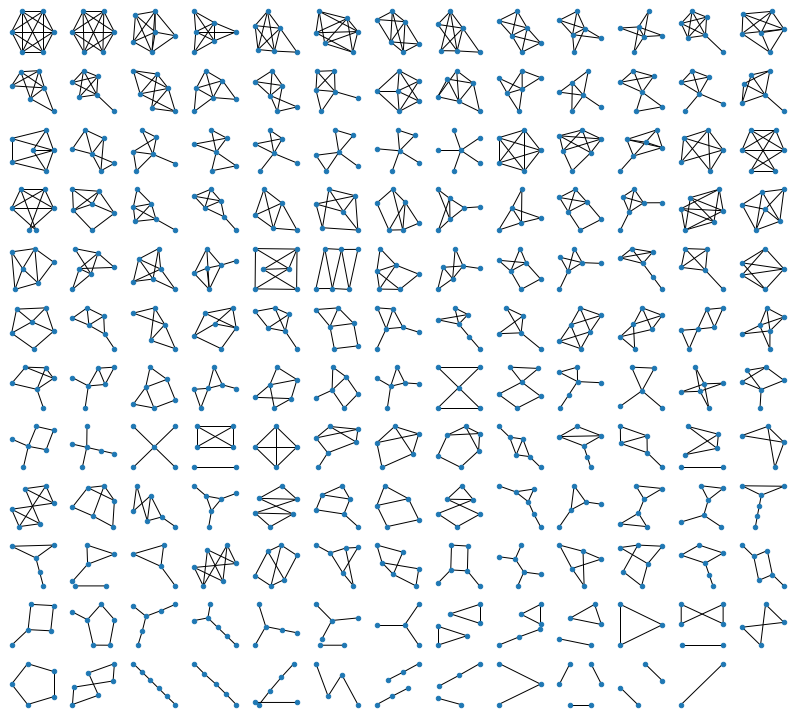

In [40]:
NV = 6
gs = make_graphs(NV)
gs = filter(gs, NV)
plot_graphs(gs, figsize=14, dotsize=20)

# General

In [41]:
#Create list of all graphs on vertices
graphs = []
vertices = 0
def Create_Graphs(vertices):
    vertices = vertices
    f = open('/home/dmitrii/Documents/TI lab/Graphs/graph'+str(vertices), 'r')
    graphs=[]
    cur_graph={}
    for index,line in enumerate(f):
        if index%(vertices+2)==0:
            continue
        if index%(vertices+2)==1:
            cur_graph={}
        if vertices+1>=index%(vertices+2)>=2:
            head,tails = line.split(":")
            cur_graph[str(head.split()[0])] = tails[:-2].split()
        if index%(vertices+2) == vertices+1:
            graphs.append(cur_graph)
    return graphs

In [42]:
#Create list of all bipartite graphs on vertices
def Create_Bigraphs(vertices):
    vertices = vertices
    f = open('/home/dmitrii/Documents/TI lab/Graphs/bigraph'+str(vertices), 'r')
    graphs=[]
    cur_graph={}
    for index,line in enumerate(f):
        if index%(vertices+2)==0:
            continue
        if index%(vertices+2)==1:
            cur_graph={}
        if vertices+1>=index%(vertices+2)>=2:
            head,tails = line.split(":")
            cur_graph[str(head.split()[0])] = tails[:-2].split()
        if index%(vertices+2) == vertices+1:
            graphs.append(cur_graph)
    return graphs

# Cycling for given size graph

vertices: 0 1 2 3 4 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['1', '4'] ['2', '3'] ['2', '4'] ['3', '4'] 
.vertices: 0 1 2 3 4 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['1', '4'] ['2', '3'] ['2', '4'] 
.vertices: 0 1 2 3 4 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['1', '4'] ['2', '3'] 
.vertices: 0 1 2 3 4 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['1', '4'] 
.vertices: 0 1 2 3 4 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['2', '3'] 
.vertices: 0 1 2 3 4 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['2', '4'] ['3', '4'] 
.vertices: 0 1 2 3 4 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['2', '4'] 
.vertices: 0 1 2 3 4 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] 
.vertices: 0 1 2 3 4 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', 

/tmp/ipykernel_220360/2253656736.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(figsize,figsize))


.

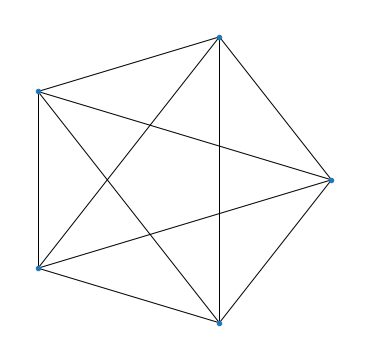

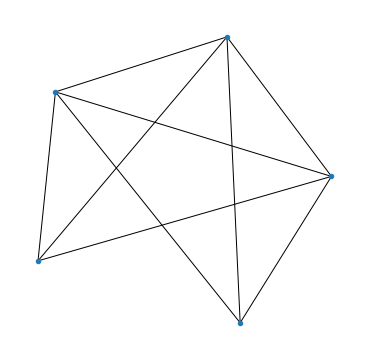

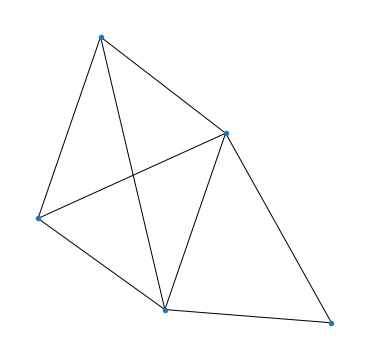

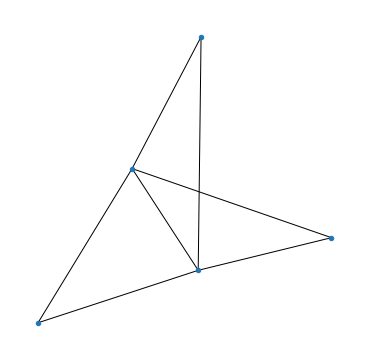

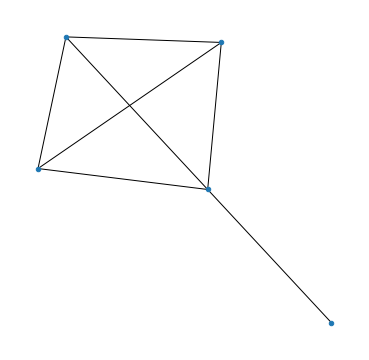

...

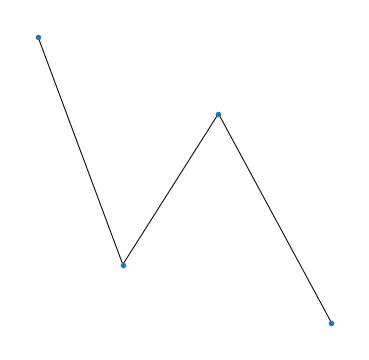

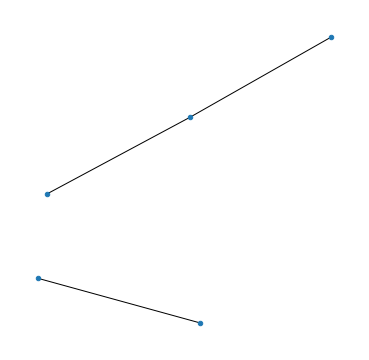

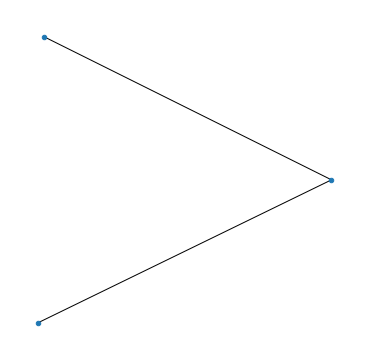

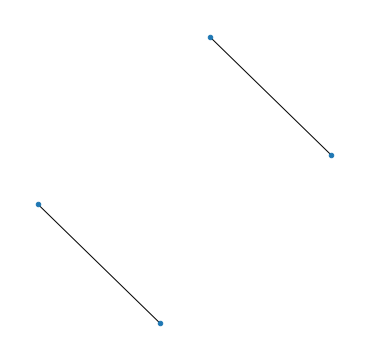

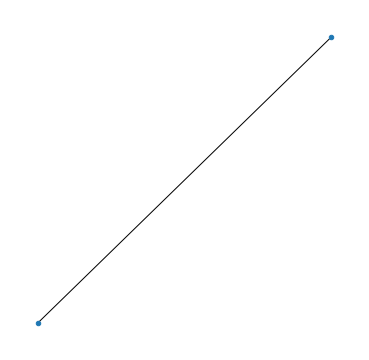

In [43]:
head_lenthes = []
cycle_lenthes = []
NV = 5
gs = make_graphs(NV)
gs = filter(gs, NV)
for starting_graph in gs:
    g = list(map(lambda x: list(map(str,x)),starting_graph))
    graph = full_graph(Graph(g),NV)
    head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True)
    head_lenthes.append(head_lenth)
    cycle_lenthes.append(cycle_lenth)
    if head_lenth == 0 and cycle_lenth == 2:
        print(cycle_start)
        plot_graphs([cycle_start.edges()], figsize=14, dotsize=20)
    #plot_graphs([cycle_start.edges(),cycle_fin.edges()], figsize=14, dotsize=20)

In [44]:
graph = Graph([['0', '1'],['0', '2'],['0', '3'],['0', '4'],['1', '2'],['1', '3'],['2', '3']])
start_cycles(graph,False,False,debug=True)

h^c [{'2', '0', '3', '1'}, {'0', '4'}]
h^cd
({'0'}v{'2', '4'}v{'4', '3'}v{'4', '1'})

h^cdc [{'2', '4'}, {'4', '3'}, {'4', '1'}, {'0'}] vertices: 0 1 2 3 4 
edges: ['1', '4'] ['2', '4'] ['3', '4'] 
h^cdcd
({'0', '4'}v{'0', '3', '2', '1'})

h^cdcd vertices: 0 1 2 3 4 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['2', '3'] 


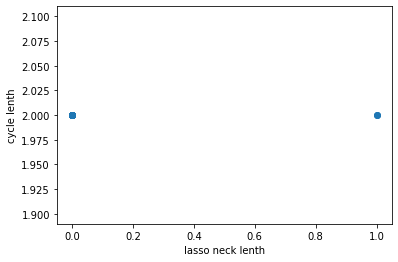

In [45]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
ax.scatter(head_lenthes,cycle_lenthes)
ax.set_xlabel('lasso neck lenth')
ax.set_ylabel('cycle lenth')
plt.show()
fig.savefig('fig2.png', bbox_inches='tight')

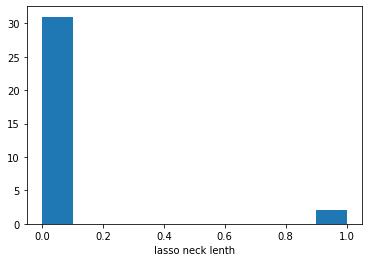

In [46]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
ax.hist(head_lenthes)
ax.set_xlabel('lasso neck lenth')
plt.show()
fig.savefig('lasso_neck.png', bbox_inches='tight')

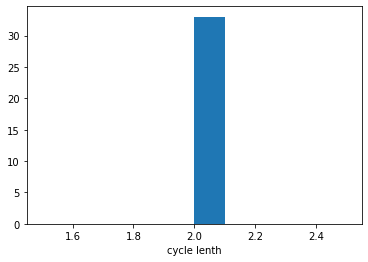

In [47]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
ax.hist(cycle_lenthes)
ax.set_xlabel('cycle lenth')
plt.show()
fig.savefig('cycle_lenth.png', bbox_inches='tight')

# Check conformal theory

In [48]:
def checking_start_cycles(graph,p=False,out=False,_all=False,debug = False,max_steps=100):
    #structs
    graphs = {str(graph)}
    hypergraphs = set()
    graphs_to_iter = dict()
    graphs_to_iter[str(graph)] = 0
    iter_to_graphs = [graph]
    #operations
    max_cliques = graph.max_cliques()
    ####
    hypergraphs.add(str(sorted(list(map(lambda x:sorted(list(x)),max_cliques)))))
    #print(str(max_cliques))
    ####
    if debug:
        print('h^c',max_cliques)
    d_max_cliques = dualisation_for_hypergraph(max_cliques)
    d_max_cliques.from_cnf_to_dnf()
    #######
    hypergraphs.add(str(sorted(list(map(lambda x:sorted(list(x)),d_max_cliques.to_list_for_dnf())))))
    #print(str(d_max_cliques.to_list_for_dnf()))
    ########
    if debug:
        print('h^cd')
        d_max_cliques.show()
        print('\n')
    g_n = hypergraph_to_graph(d_max_cliques.to_list_for_dnf())
    steps = 1
    while (str(g_n) not in graphs) and max_steps > steps:
        graphs.add(str(g_n))
        graphs_to_iter[str(g_n)] = steps
        iter_to_graphs.append(g_n)
        max_cliques = g_n.max_cliques()
        max_cliques.sort(key=len)
        #######
        hypergraphs.add(str(sorted(list(map(lambda x:sorted(list(x)),max_cliques)))))
        #print(str(max_cliques))
        ########
        if debug:
            print('h^'+'cd'*steps+'c',max_cliques,g_n)
        d_max_cliques = dualisation_for_hypergraph(max_cliques)
        d_max_cliques.from_cnf_to_dnf()
        d_max_cliques.sort()
        #######
        hypergraphs.add(str(sorted(list(map(lambda x:sorted(list(x)),d_max_cliques.to_list_for_dnf())))))
        #print(str(d_max_cliques.to_list_for_dnf()))
        ########
        if debug:
            print('h^'+'cd'*steps+'cd')
            d_max_cliques.show()
            print('\n')
        g_n = hypergraph_to_graph(d_max_cliques.to_list_for_dnf())
        if debug:
            print('h^'+'cd'*steps+'cd',g_n)
        steps+=1
    ###
    if len(hypergraphs) > 2:
        print(graph)
        plot_graphs([graph.edges()], figsize=14, dotsize=20)
    ###
    if p:
        print(g_n)
        print("steps:",steps)
        print("cycle lenth:", steps - graphs_to_iter[str(g_n)],end='\n\n')
        for i in range(steps):
            print("step=",i)
            print(iter_to_graphs[i],end='\n\n')
    if _all:
        for i in iter_to_graphs:
            print(i)
    if out:
        cycle_lenth  = steps - graphs_to_iter[str(g_n)]
        head_lenth = steps - cycle_lenth
        return head_lenth, cycle_lenth, iter_to_graphs[steps - cycle_lenth], iter_to_graphs[steps-1]

In [49]:
head_lenthes = []
cycle_lenthes = []
NV = 6
gs = make_graphs(NV)
gs = filter(gs, NV)
for starting_graph in gs:
    g = list(map(lambda x: list(map(str,x)),starting_graph))
    graph = full_graph(Graph(g),NV)
    head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True)
    if cycle_lenth >=2:
        checking_start_cycles(cycle_start,False,True)
    #head_lenthes.append(head_lenth)
    #cycle_lenthes.append(cycle_lenth)
    #print(head_lenth,cycle_lenth)
    #print(cycle_start)
    #plot_graphs([cycle_start.edges()], figsize=14, dotsize=20)
    #print('\n\n')
    #plot_graphs([cycle_start.edges(),cycle_fin.edges()], figsize=14, dotsize=20)

In [50]:
graph = Graph([['0', '1'], ['0', '2'], ['0', '3'], ['0', '4'], ['1', '2'], ['1', '3'], ['1', '5'], ['2', '4'], ['2', '5']])
head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True,debug=True)
print(head_lenth,cycle_lenth)

h^c [{'2', '0', '4'}, {'5', '2', '1'}, {'2', '0', '1'}, {'0', '3', '1'}]
h^cd
({'0', '2'}v{'0', '5'}v{'0', '1'}v{'2', '1'}v{'4', '1'}v{'2', '3'})

h^cdc [{'2', '0', '1'}, {'2', '3'}, {'4', '1'}, {'5', '0'}] vertices: 0 1 2 3 4 5 
edges: ['0', '1'] ['0', '2'] ['0', '5'] ['1', '2'] ['1', '4'] ['2', '3'] 
h^cdcd
({'5', '4', '2'}v{'5', '2', '1'}v{'5', '3', '1'}v{'0', '4', '2'}v{'0', '4', '3'}v{'0', '2', '1'}v{'0', '3', '1'})

h^cdcd vertices: 0 1 2 3 4 5 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['1', '5'] ['2', '4'] ['2', '5'] ['3', '4'] ['3', '5'] ['4', '5'] 
h^cdcdc [{'5', '4', '3'}, {'5', '3', '1'}, {'5', '4', '2'}, {'5', '2', '1'}, {'0', '4', '3'}, {'0', '3', '1'}, {'2', '0', '4'}, {'2', '0', '1'}] vertices: 0 1 2 3 4 5 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['1', '5'] ['2', '4'] ['2', '5'] ['3', '4'] ['3', '5'] ['4', '5'] 
h^cdcdcd
({'0', '5'}v{'2', '3'}v{'4', '1'})

h^cdcdcd vertices: 0 1 2 3 4 5 
edges: ['0', '5'] [

h^c [{'5', '4', '3'}, {'2', '0', '1'}, {'4', '1'}, {'2', '3'}, {'5', '0'}]
h^cd
({'5', '2', '1'}v{'5', '3', '1'}v{'0', '3', '1'}v{'2', '4', '5'}v{'2', '4', '0'}v{'0', '4', '3'})

h^cdc [{'5', '4', '3'}, {'5', '4', '2'}, {'5', '3', '1'}, {'5', '2', '1'}, {'0', '4', '3'}, {'2', '0', '4'}, {'0', '3', '1'}, {'2', '0', '1'}] vertices: 0 1 2 3 4 5 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['1', '5'] ['2', '4'] ['2', '5'] ['3', '4'] ['3', '5'] ['4', '5'] 
h^cdcd
({'0', '5'}v{'4', '1'}v{'2', '3'})

h^cdcd vertices: 0 1 2 3 4 5 
edges: ['0', '5'] ['1', '4'] ['2', '3'] 
h^cdcdc [{'2', '3'}, {'4', '1'}, {'5', '0'}] vertices: 0 1 2 3 4 5 
edges: ['0', '5'] ['1', '4'] ['2', '3'] 
h^cdcdcd
({'2', '5', '4'}v{'2', '5', '1'}v{'2', '0', '4'}v{'2', '0', '1'}v{'5', '3', '4'}v{'5', '3', '1'}v{'0', '3', '4'}v{'0', '3', '1'})

h^cdcdcd vertices: 0 1 2 3 4 5 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['1', '5'] ['2', '4'] ['2', '5'] ['3', '4'] ['3

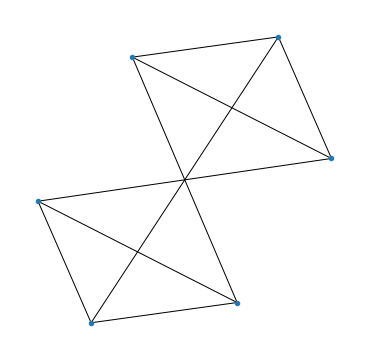

In [51]:
graph = Graph([['0', '1'],['0', '2'],['0', '5'],['1', '2'],['1', '4'],['2', '3'],['3','4'],['3','5'],['4','5']])
head_lenth,cycle_lenth, cycle_start, cycle_fin = checking_start_cycles(graph,False,True,debug=True)

# Another way to check conformal

In [52]:
def check_if_conformal(hypergraph):
    graph = hypergraph_to_graph(hypergraph)
    max_cliques = graph.max_cliques()
    return str(sorted(list(map(lambda x:sorted(list(x)),hypergraph)))) == str(sorted(list(map(lambda x:sorted(list(x)),max_cliques))))

In [53]:
def checking_start_cycles2(graph,debug = False,max_steps=100):
    #structs
    graphs = {str(graph)}
    hypergraphs = set()
    graphs_to_iter = dict()
    graphs_to_iter[str(graph)] = 0
    iter_to_graphs = [graph]
    #operations
    max_cliques = graph.max_cliques()
    ####
    if not check_if_conformal(max_cliques):
        return False
    #print(str(max_cliques))
    ####
    if debug:
        print('h^c',max_cliques)
    d_max_cliques = dualisation_for_hypergraph(max_cliques)
    d_max_cliques.from_cnf_to_dnf()
    #######
    if not check_if_conformal(d_max_cliques.to_list_for_dnf()):
        return False
    #print(str(d_max_cliques.to_list_for_dnf()))
    ########
    if debug:
        print('h^cd')
        d_max_cliques.show()
        print('\n')
    g_n = hypergraph_to_graph(d_max_cliques.to_list_for_dnf())
    steps = 1
    while (str(g_n) not in graphs) and max_steps > steps:
        graphs.add(str(g_n))
        graphs_to_iter[str(g_n)] = steps
        iter_to_graphs.append(g_n)
        max_cliques = g_n.max_cliques()
        max_cliques.sort(key=len)
        #######
        if not check_if_conformal(max_cliques):
            return False
        #print(str(max_cliques))
        ########
        if debug:
            print('h^'+'cd'*steps+'c',max_cliques,g_n)
        d_max_cliques = dualisation_for_hypergraph(max_cliques)
        d_max_cliques.from_cnf_to_dnf()
        d_max_cliques.sort()
        #######
        if not check_if_conformal(d_max_cliques.to_list_for_dnf()):
            return False
        #print(str(d_max_cliques.to_list_for_dnf()))
        ########
        if debug:
            print('h^'+'cd'*steps+'cd')
            d_max_cliques.show()
            print('\n')
        g_n = hypergraph_to_graph(d_max_cliques.to_list_for_dnf())
        if debug:
            print('h^'+'cd'*steps+'cd',g_n)
        steps+=1
    return True

In [54]:
NV = 4
gs = make_graphs(NV)
gs = filter(gs, NV)
for starting_graph in gs:
    g = list(map(lambda x: list(map(str,x)),starting_graph))
    graph = full_graph(Graph(g),NV)
    head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True)
    if cycle_lenth >=2:
        if not checking_start_cycles2(cycle_start):
            print(graph)
            plot_graphs([graph.edges()], figsize=14, dotsize=20)

# FindLongest Neck

In [55]:
def checking_start_cycles(graph,p=False,out=False,_all=False,debug = False,max_steps=100):
    #structs
    graphs = {str(graph)}
    hypergraphs = set()
    graphs_to_iter = dict()
    graphs_to_iter[str(graph)] = 0
    iter_to_graphs = [graph]
    #operations
    max_cliques = graph.max_cliques()
    ####
    hypergraphs.add(str(sorted(list(map(lambda x:sorted(list(x)),max_cliques)))))
    #print(str(max_cliques))
    ####
    if debug:
        print('h^c',max_cliques)
    d_max_cliques = dualisation_for_hypergraph(max_cliques)
    d_max_cliques.from_cnf_to_dnf()
    #######
    hypergraphs.add(str(sorted(list(map(lambda x:sorted(list(x)),d_max_cliques.to_list_for_dnf())))))
    #print(str(d_max_cliques.to_list_for_dnf()))
    ########
    if debug:
        print('h^cd')
        d_max_cliques.show()
        print('\n')
    g_n = hypergraph_to_graph(d_max_cliques.to_list_for_dnf())
    steps = 1
    while (str(g_n) not in graphs) and max_steps > steps:
        graphs.add(str(g_n))
        graphs_to_iter[str(g_n)] = steps
        iter_to_graphs.append(g_n)
        max_cliques = g_n.max_cliques()
        max_cliques.sort(key=len)
        #######
        hypergraphs.add(str(sorted(list(map(lambda x:sorted(list(x)),max_cliques)))))
        #print(str(max_cliques))
        ########
        if debug:
            print('h^'+'cd'*steps+'c',max_cliques,g_n)
        d_max_cliques = dualisation_for_hypergraph(max_cliques)
        d_max_cliques.from_cnf_to_dnf()
        d_max_cliques.sort()
        #######
        hypergraphs.add(str(sorted(list(map(lambda x:sorted(list(x)),d_max_cliques.to_list_for_dnf())))))
        #print(str(d_max_cliques.to_list_for_dnf()))
        ########
        if debug:
            print('h^'+'cd'*steps+'cd')
            d_max_cliques.show()
            print('\n')
        g_n = hypergraph_to_graph(d_max_cliques.to_list_for_dnf())
        if debug:
            print('h^'+'cd'*steps+'cd',g_n)
        steps+=1
    ###
    if len(hypergraphs) > 7:
        print(graph.edges())
        plot_graphs([graph.edges()], figsize=14, dotsize=20)
    ###
    if p:
        print(g_n)
        print("steps:",steps)
        print("cycle lenth:", steps - graphs_to_iter[str(g_n)],end='\n\n')
        for i in range(steps):
            print("step=",i)
            print(iter_to_graphs[i],end='\n\n')
    if _all:
        for i in iter_to_graphs:
            print(i)
    if out:
        cycle_lenth  = steps - graphs_to_iter[str(g_n)]
        head_lenth = steps - cycle_lenth
        return head_lenth, cycle_lenth, iter_to_graphs[steps - cycle_lenth], iter_to_graphs[steps-1]

[['0', '1'], ['0', '2'], ['0', '3'], ['0', '4'], ['1', '2'], ['1', '3'], ['2', '5'], ['4', '5'], ['4', '6'], ['5', '6']]
.[['0', '1'], ['0', '2'], ['0', '3'], ['0', '4'], ['1', '2'], ['1', '5'], ['3', '5'], ['3', '6'], ['5', '6']]
.

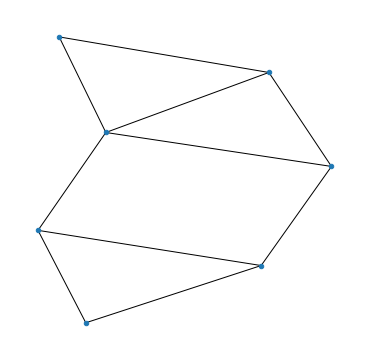

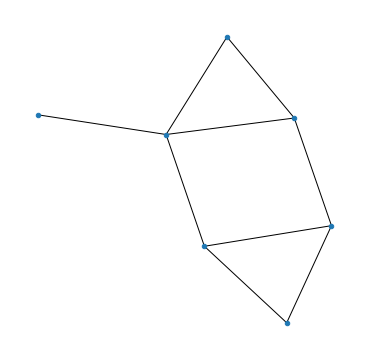

In [56]:
NV = 7
gs = make_graphs(NV)
gs = filter(gs, NV)
for starting_graph in gs:
    g = list(map(lambda x: list(map(str,x)),starting_graph))
    graph = full_graph(Graph(g),NV)
    head_lenth,cycle_lenth, cycle_start, cycle_fin = checking_start_cycles(graph,False,True)

h^c [{'5', '3', '6'}, {'2', '0', '1'}, {'0', '3'}, {'0', '4'}, {'5', '1'}]
h^cd
({'0', '5'}v{'0', '3', '1'}v{'0', '1', '6'}v{'4', '1', '3'}v{'2', '3', '5', '4'})

h^cdc [{'5', '0', '3'}, {'4', '1', '3'}, {'0', '3', '1'}, {'6', '0', '1'}, {'5', '4', '2', '3'}] vertices: 0 1 2 3 4 5 6 
edges: ['0', '1'] ['0', '3'] ['0', '5'] ['0', '6'] ['1', '3'] ['1', '4'] ['1', '6'] ['2', '3'] ['2', '4'] ['2', '5'] ['3', '4'] ['3', '5'] ['4', '5'] 
h^cdcd
({'0', '3'}v{'6', '3'}v{'3', '1'}v{'5', '1'}v{'0', '4'}v{'0', '2', '1'})

h^cdcd vertices: 0 1 2 3 4 5 6 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['1', '5'] ['3', '6'] 
h^cdcdc [{'5', '1'}, {'6', '3'}, {'0', '4'}, {'0', '3', '1'}, {'2', '0', '1'}] vertices: 0 1 2 3 4 5 6 
edges: ['0', '1'] ['0', '2'] ['0', '3'] ['0', '4'] ['1', '2'] ['1', '3'] ['1', '5'] ['3', '6'] 
h^cdcdcd
({'0', '1', '6'}v{'0', '5', '6'}v{'0', '3', '1'}v{'0', '3', '5'}v{'6', '4', '1'}v{'4', '1', '3'}v{'5', '2', '4', '3'})

h^cdcdcd vertices: 0 1 2 3

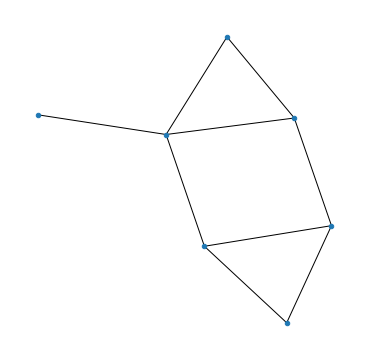

In [57]:
graph = Graph([['0', '1'], ['0', '2'], ['0', '3'], ['0', '4'], ['1', '2'], ['1', '5'], ['3', '5'], ['3', '6'], ['5', '6']])
head_lenth,cycle_lenth, cycle_start, cycle_fin = checking_start_cycles(graph,False,True,debug=True)

# Another Graph Generator

In [58]:
f = open('/home/dmitrii/Documents/TI lab/Graphs/graph8', 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%10==0:
        continue
    if index%10==1:
        cur_graph={}
    if 9>=index%10>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%10 == 9:
        graphs.append(cur_graph)

In [59]:
print(graphs[1000])

{'0': ['4', '6', '7'], '1': ['5'], '2': ['6', '7'], '3': ['7'], '4': ['0', '7'], '5': ['1'], '6': ['0', '2'], '7': ['0', '2', '3', '4']}


# 8 vertices checked

In [60]:
for g in graphs:
    graph = Graph(g)
    print(graph)
    start_cycles(graph,False,True)

vertices: 0 1 2 3 4 5 6 7 
edges: 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '7'] ['1', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '7'] ['1', '7'] ['2', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '7'] ['1', '7'] ['2', '7'] ['3', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '7'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '7'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '7'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '6'] ['1', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '6'] ['1', '7'] ['2', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '6'] ['1', '7'] ['2', '7'] ['3', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '6'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '6'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '6'] ['1', '7'] ['2', '7

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['4', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertice

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '6'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '6'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '6'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '6'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '6'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['2', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '7

edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '6'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '6'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '7'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '6'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['4', '6'] ['4', '7'] ['5', '6'] 
vertices:

edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '6'] ['4', '7'] ['5', '7'] 
ver

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['6', '7'] 


edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['2', '6'] ['2', '7'] ['3', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] 

edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['3', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['3', '7'] ['4', '7'] ['5', '6'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['3', '7'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['4', '7'] ['5', '6'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '7'] ['2', '6'] ['2', '7'] ['

edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['4', '5'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['4', '5'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['4', '5'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['4', '5'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '5'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '5'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '5'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '5'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '5'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 

edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['1', '5'] ['1', '6'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['1', '5'] ['1'

edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2'

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['4', '6'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '5'] ['1', '6']

edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '6'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '7'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '7'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4']

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '5'] ['3', '6'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '5'] ['3', '6'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['4', '6'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '7']

edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '5'] ['3', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '5'] ['3', '7'] ['4', '7'] ['5', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '5'] ['3', '7'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '5'] ['3', '7'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0'

edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['4', '5'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] [

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] [

edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['

edges: ['0', '3'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '7'] ['3', '5'] ['3', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '7'] ['3', '5'] ['3', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '5'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '5'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '5'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '5'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '5'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '5'] ['3', '7']

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7']

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '7'] ['3', '6'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['5', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] [

edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', 

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['3', '6'] ['3', '7'] ['4', '5'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '7'] ['3', '6'] ['4', '5'] ['4', '7'] ['5', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '7'] ['3', '6'] ['4', '5'] ['4', '7'] ['5', '6'] [

edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '7'] ['3', '6'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] 
verti

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '4'] ['3', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '4'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '4'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '6'] ['3', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '6'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '6'] ['3', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '6']

edges: ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '7'] ['4', '6'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '7'] ['4', '6'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '6'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '7'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '6'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0'

edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['1', '4'] ['1', '5'] ['2', 

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '6'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['1', '4'] ['1', '5'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] 


edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] ['3', '5'] ['3', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] ['3', '5'] ['3', '6'] ['3', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] ['3', '5'] ['3', '6'] ['3', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', 

edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', 

edges: ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '7'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0'

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '4'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1

edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '7'] ['2', 

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] ['3', '5'] ['3', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] ['3', '5'] ['3', '6'] ['3', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '4'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '7'] ['5

edges: ['0', '2'] ['0', '4'] ['0', '5'] ['1', '3'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['1', '3'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['4', '6'] ['5', '7'] 
verti

vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '7'] ['4', '5'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '6'] ['1', '3'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '6'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['4', '5'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '5'] ['1', '6'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '6'] ['3', '7'] ['4', '5'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '6'] [

edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '4'] ['0', 

edges: ['0', '2'] ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '3'] ['0', '4'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['2', '5'] ['2', '6'] ['2', '7'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '6'] ['4', '7'] ['5', '6'] ['5', '7'] ['6', '7'] 
vertices: 0 1 2 3 4 5 6 7 
edges: ['0', '2'] ['0', '3'] ['0', '4'] ['0', '5'] ['0', '6'] ['0', '7'] ['1', '3'] ['1', '4'] ['1', '5'] ['1', '6'] ['1', '7'] ['2', '4'] ['3', '5'] ['3', '6'] ['3', '7'] ['4', '5'] ['4', '6

In [61]:
for g in graphs:
    graph = Graph(g)
    head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True,max_steps=100000000)
    if cycle_lenth >=2:
        if not checking_start_cycles2(cycle_start,max_steps=1000000000):
            print(graph)
            plot_graphs([graph.edges()], figsize=14, dotsize=20)

In [62]:
for g in graphs:
    graph = Graph(g)
    head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True,max_steps=100000)
    if cycle_lenth >=2:
        checking_start_cycles(cycle_start,False,True,max_steps=100000)

# 9 vertices graphs checked

In [63]:
f = open('/home/dmitrii/Documents/TI lab/Graphs/graph9', 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%11==0:
        continue
    if index%11==1:
        cur_graph={}
    if 10>=index%11>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%11 == 10:
        graphs.append(cur_graph)

In [64]:
print(graphs[1000])

{'0': ['6', '7', '8'], '1': ['6', '8'], '2': ['7', '8'], '3': ['7'], '4': ['8'], '5': ['8'], '6': ['0', '1', '8'], '7': ['0', '2', '3'], '8': ['0', '1', '2', '4', '5', '6']}


In [65]:
f_cycles = []
f_lenthes = []
for g in graphs:
    graph = Graph(g)
    head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True)
    if cycle_lenth >=2:
        if not checking_start_cycles2(cycle_start):
            #print(graph.edges())
            f_cycles.append(cycle_start.edges())
            f_lenthes.append(cycle_lenth)
            #plot_graphs([graph.edges()], figsize=14, dotsize=20)

KeyboardInterrupt: 

In [ ]:
plot_graphs(f_cycles, figsize=14, dotsize=20)

In [ ]:
indices = [i for i, x in enumerate(f_lenthes) if x >= 4]
indices

In [ ]:
f_lenthes

In [ ]:
p = []
for i in indices:
    p.append(f_cycles[i])
plot_graphs(p, figsize=14, dotsize=20)

In [ ]:
print(p[0])
plot_graphs([p[0]], figsize=14, dotsize=20)

In [ ]:
for g in graphs:
    graph = Graph(g)
    head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True)
    if cycle_lenth >=2:
        checking_start_cycles(cycle_start,False,True)

In [ ]:
graph = Graph(p[0])
plot_graphs([p[0]], figsize=14, dotsize=20)
head_lenth,cycle_lenth, cycle_start, cycle_fin = checking_start_cycles(graph,False,True,debug=True)

In [ ]:
a = [['0', '3'],['0', '4'],['0', '5'],['0', '6'],['0', '7'],['0', '8'],['1', '2'],['1', '3'],['1', '4'],['1', '6'],['1', '7'],['1', '8'],['2', '3'],['2', '5'],['2', '6'],['2', '8'],['3', '6'],['3', '7'],['3', '8'],['4', '5'],['4', '6'],['4', '7'],['4', '8'],['5', '7'],['5', '8']]
b = [['0', '2'], ['0', '3'], ['0', '4'], ['0', '6'], ['0', '7'], ['0', '8'], ['1', '3'], ['1', '4'], ['1', '5'], ['1', '6'], ['1', '7'], ['1', '8'], ['2', '4'], ['2', '5'], ['2', '6'], ['2', '8'], ['3', '5'], ['3', '6'], ['3', '7'], ['3', '8'], ['4', '6'], ['4', '7'], ['4', '8'], ['5', '7'], ['5', '8']]
plot_graphs([b,a], figsize=14, dotsize=20)
print(isomorphic(a,b,9))

# Best 9 vertex graphs

In [ ]:
def print_graph(graph):
    return str(str(sorted(list(map(lambda x: sorted(x),graph)))).replace("'], ['"," ").replace("', '","").split("]], [["))[4:-4]

In [ ]:
def out_cycle(graph,n):
    graph = full_graph(Graph(graph),9)
    print('h=',print_graph(graph.edges()))
    #graphs = [graph.edges()]
    graphs = [graph.edges()]
    #operations
    line = 'h^'
    for i in range(n):
        max_cliques = graph.max_cliques()
        line += 'c'
        #print(line +'=',print_graph(hypergraph_to_graph(max_cliques).edges()),end="\n\n")
        print(line +'=',print_graph(max_cliques),end="\n\n")
        d_max_cliques = dualisation_for_hypergraph(max_cliques)
        d_max_cliques.from_cnf_to_dnf()
        line += 'd'
        print(line +'=',print_graph(d_max_cliques.to_list_for_dnf()),end="\n\n")
        graphs.append(hypergraph_to_graph(d_max_cliques.to_list_for_dnf()).edges())
        graph = hypergraph_to_graph(d_max_cliques.to_list_for_dnf())
    plot_graphs(graphs[:-1], figsize=14, dotsize=20)

In [ ]:
plot_graphs([f_cycles[1]], figsize=14, dotsize=20)

In [ ]:
out_cycle(f_cycles[1],4)

# Out all cycles

In [ ]:
vertices = 7
f = open('/home/dmitrii/Documents/TI lab/Graphs/graph'+str(vertices), 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
        graphs.append(cur_graph)

In [459]:
import pynauty
#def make_automorphic_minimal(graph):
def isomorphic(a,b,n = vertices):
    a = Graph(a).adjacency_dict()
    b = Graph(b).adjacency_dict()
    #print(a)
    a = {int(k):[int(i) for i in v] for k,v in a.items()}
    b = {int(k):[int(i) for i in v] for k,v in b.items()}
    return pynauty.isomorphic(pynauty.Graph(n,adjacency_dict=a),pynauty.Graph(n,adjacency_dict=b))

In [97]:
def add_graph(g_list,n_graph):
    return not any(list(map(lambda x: isomorphic(n_graph,x),g_list)))

In [ ]:
cycles = set()
pic = []
for g in graphs:
    graph = Graph(g)
    head_lenth,cycle_lenth, cycle_start, cycle_fin = start_cycles(graph,False,True)
    if cycle_lenth > 1 and (len(pic) == 0 or add_graph(pic,cycle_start.edges())):
        pre = len(cycles)
        cycles.add(str(sorted([sorted(cycle_start.edges()),sorted(cycle_fin.edges())],key=len)))
        post = len(cycles)
        if pre != post:
            pic.append(cycle_start.edges())
            pic.append(cycle_fin.edges())
#plot_graphs(pic, figsize=14, dotsize=20)
n = len(pic)
fig = plt.figure(figsize=(2,n//2))
fig.patch.set_facecolor('white') # To make copying possible (white background)

for i in range(n):
    plt.subplot(n//2,2,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in pic[i]:            
        g.add_edge(e[0],e[1])
    nx.draw_kamada_kawai(g, node_size=20)
    print('.', end='')

In [ ]:
fig.savefig('all_cycles.png', bbox_inches='tight')

In [ ]:
s_cycles = list(map(lambda x: x.replace("'], ['"," ").replace("', '","").split("]], [["),cycles))

In [ ]:
len(pic)

In [ ]:
list(map(lambda x: isomorphic([['0','1'],['0','2'],['1','2'],['1','4'],['2','3'],['3','4'],['3','5'],['4','5']],x),pic)).index(True)

In [ ]:
graph = Graph([['0','1'],['0','2'],['1','2'],['1','4'],['2','3'],['3','4'],['3','5'],['4','5']])
head_lenth,cycle_lenth, cycle_start, cycle_fin = checking_start_cycles(graph,False,True,debug=True)
print(cycle_start,cycle_fin,cycle_lenth)

In [ ]:
print(s_cycles)

In [ ]:
print(len(s_cycles))
list(map(lambda x: [x[0][4:-1],x[1][1:-4]] if len(x) >= 2 else ['',x[0][2:-4]],s_cycles))

# Sift all 6 vertex graphs

In [84]:
def check_for_anticlique(graph,prob_anticlique):
    for i,k in itertools.combinations(prob_anticlique, 2):
        if graph.check_connection(i,k):
            return False
    return True

In [85]:
def check_split(graph,n):
    actual_g = full_graph(Graph(graph),n)
    max_cliques = actual_g.max_cliques()
    for clique in max_cliques:
        vertics = set(map(str,list(range(0,n))))
        addition = vertics - clique
        #print(clique,vertics,addition)
        if check_for_anticlique(actual_g,addition):
            return True
    return False

In [86]:
def check_for_twin_vertices(graph,n):
    g_dict = full_graph(Graph(graph),n).adjacency_dict()
    for i,k in itertools.combinations(g_dict.values(), 2):
        #print(i,k)
        if sorted(i) == sorted(k):
            return True
    return False

In [1]:
def DFS(G,v,seen=None,path=None):
    if seen is None: seen = []
    if path is None: path = [v]

    seen.append(v)

    paths = []
    for t in G[v]:
        if t not in seen:
            t_path = path + [t]
            paths.append(tuple(t_path))
            paths.extend(DFS(G, t, seen[:], t_path))
    return paths
def find_longest_path(graph,n):
    # Build graph dictionary
    #G = defaultdict(list)
    #print(G)
    G = full_graph(Graph(graph),n).adjacency_dict()
    # Run DFS, compute metrics
    all_paths = DFS(G, '1')
    max_len   = max(len(p) for p in all_paths) if len(all_paths) > 0 else 0
    max_list   = max((p) for p in all_paths)
    #max_paths = [p for p in all_paths if len(p) == max_len]
    return max_len,max_list
    # Output
    #print("All Paths:")
    #print(all_paths)
    #print("Longest Paths:")
    #for p in max_paths: print("  ", p)
    #print("Longest Path Length:")
    #print(max_len)

In [70]:
find_longest_path([['0','4'],['0','3'],['1','2'],['1','3'],['1','4'],['2','3'],['2','4'],['3','4'],['3','5'],['4','5']],6)

6

In [71]:
set(map(str,list(range(1,5+1))))

{'1', '2', '3', '4', '5'}

In [72]:
Graph([['0','1'],['0','2'],['1','2'],['1','4'],['2','3'],['3','4'],['3','5'],['4','5']]).check_connection('0','2')

True

In [73]:
pic_sifted = []
for i,k in zip(pic[0::2], pic[1::2]):
    if not check_split(i,vertices) and not check_split(k,vertices) and not check_for_twin_vertices(i,vertices) and not check_for_twin_vertices(k,vertices) and find_longest_path(i,vertices) >= 4 and find_longest_path(k,vertices) >= 4:
        pic_sifted.append(i)
        pic_sifted.append(k)
n = len(pic_sifted)
fig = plt.figure(figsize=(2,n//2))
fig.patch.set_facecolor('white') # To make copying possible (white background)

for i in range(n):
    plt.subplot(n//2,2,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in pic_sifted[i]:            
        g.add_edge(e[0],e[1])
    nx.draw_kamada_kawai(g, node_size=20)
    print('.', end='')

NameError: name 'pic' is not defined

In [ ]:
pic_p = list(map(lambda x: str(sorted([sorted(x[0]),sorted(x[1])],key=len)),zip(pic_sifted[0::2], pic_sifted[1::2])))

In [ ]:
pic_p_cycles = list(map(lambda x: x.replace("'], ['"," ").replace("', '","").split("]], [["),pic_p))
print(len(pic_p_cycles))
list(map(lambda x: [x[0][4:-1],x[1][1:-4]],pic_p_cycles))

# Sift harder

In [91]:
def powerset(iterable):
    "powerset([1,2,3]) --> () (1,) (2,) (3,) (1,2) (1,3) (2,3) (1,2,3)"
    s = list(iterable)
    return itertools.chain.from_iterable(itertools.combinations(s, r) for r in range(2,len(s)))

In [ ]:
list(powerset([1,2,3,4]))

In [89]:
def check_for_many_twin_vertices(graph,n,out=False):
    g_dict = full_graph(Graph(graph),n).adjacency_dict()
    for subset in powerset(set(g_dict.keys())):
        adjacency_list = []
        for vertex in subset:
            adjacency_list.append(g_dict[vertex])
        x = list(map(lambda x: list(set(x) - set(subset)),adjacency_list))
        if x.count(x[0]) == len(x):
            if out:
                print(subset)
            return True
    return False

In [ ]:
pic_sifted = []
for i,k in zip(pic[0::2], pic[1::2]):
    if not check_split(i,vertices) and not check_split(k,vertices) and not check_for_many_twin_vertices(i,vertices) and not check_for_many_twin_vertices(k,vertices) and find_longest_path(i,vertices) >= 4 and find_longest_path(k,vertices) >= 4:
        pic_sifted.append(i)
        pic_sifted.append(k)
n = len(pic_sifted)
fig = plt.figure(figsize=(2,n//2))
fig.patch.set_facecolor('white') # To make copying possible (white background)

for i in range(n):
    plt.subplot(n//2,2,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in pic_sifted[i]:            
        g.add_edge(e[0],e[1])
    nx.draw_kamada_kawai(g, node_size=20)
    print('.', end='')

In [ ]:
pic_p = list(map(lambda x: str(sorted([sorted(x[0]),sorted(x[1])],key=len)),zip(pic_sifted[0::2], pic_sifted[1::2])))
pic_p_cycles = list(map(lambda x: x.replace("'], ['"," ").replace("', '","").split("]], [["),pic_p))
print(len(pic_p_cycles))
list(map(lambda x: [x[0][4:-1],x[1][1:-4]],pic_p_cycles))

In [ ]:
pic_sifted[4]

In [ ]:
plot_graphs([pic_sifted[4]], figsize=14, dotsize=20)

# Specific Graph is conformal?

### Bipartide

In [93]:
# Function to check whether a graph is
# bipartite or not
def isBipartite(adj, visited, color,started_v='1',v='1'):
    for u in adj[v]:
        # If vertex u is not explored before
        if (visited.get(u) == None):

            # Mark present vertic as visited
            visited[u] = True

            # Mark its color opposite to its parent
            color[u] = not (color.get(v) if color.get(v) != None else False)

            # If the subtree rooted at vertex v
            # is not bipartite
            if (not isBipartite(adj,visited, color,started_v, u)):
                return False
        # If two adjacent are colored with
        # same color then the graph is not
        # bipartite
        elif (color[u] == color[v]):
            return False
    if v == started_v and len(adj.keys()) > len(visited.keys()):
        v = list(set(adj.keys()) - set(visited.keys()))[0]
        visited[v] = True
        color[v] = 0
        return isBipartite(adj,visited, color,v, v)
    return True

In [94]:
def check_cdc(h,return_cdc=False):
    h_d = dualisation_for_hypergraph(Graph(h).max_cliques())
    h_d.from_cnf_to_dnf()
    if return_cdc:
        p = h_d.to_list_for_dnf()
        return check_if_conformal(p), p
    else:
        return check_if_conformal(h_d.to_list_for_dnf())

In [ ]:
vertices = 8
f = open('/home/dmitrii/Documents/TI lab/Graphs/bigraph'+str(vertices), 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
        graphs.append(cur_graph)

In [ ]:
h_s = []
h_cdc_s = []
h_list = []
for h in graphs:
    visited={'1':True}
    color={'1':0}
    #b_t = isBipartite(h,visited,color)
    if check_cdc(h):
        h_s.append(Graph(h).edges())
        h_list.append(Graph(h).edges())
        _,h_d = check_cdc(h,True)
        h_cdc_s.append(hypergraph_to_graph(h_d).edges())
        h_list.append(hypergraph_to_graph(h_d).edges())
plot_graphs(h_s, figsize=14, dotsize=20)
plot_graphs(h_cdc_s, figsize=14, dotsize=20)

In [ ]:
len(h_s)

#### SIFT GRAPHS

In [ ]:
pic_sifted = []
for i,k in zip(h_list[0::2], h_list[1::2]):
    if  not check_for_many_twin_vertices(i,vertices) and not check_for_many_twin_vertices(k,vertices):
        pic_sifted.append(i)
        pic_sifted.append(k)
n = len(pic_sifted)
fig = plt.figure(figsize=(2*3,3*n//2))
fig.patch.set_facecolor('white') # To make copying possible (white background)

for i in range(n):
    plt.subplot(n//2,2,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in pic_sifted[i]:            
        g.add_edge(e[0],e[1])
    nx.draw_kamada_kawai(g, node_size=20)
    print('.', end='')

In [ ]:
for i,k in zip(pic_sifted[0::2], pic_sifted[1::2]):
    c,_,_ = check_two_cliques(k,vertices)
    if  not c:
        print(False)

## ON TWO CLIQUES OPTIMAL V

In [ ]:
vertices = 6
f = open('/home/dmitrii/Documents/TI lab/Graphs/bigraph'+str(vertices), 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
        graphs.append(cur_graph)

In [ ]:
h_s = []
h_cdc_s = []
h_list = []
for h in graphs:
    h = Graph(h).make_antigraph().edges()
    if check_cdc(h):
        h_s.append(Graph(h).edges())
        h_list.append(Graph(h).edges())
        _,h_d = check_cdc(h,True)
        h_cdc_s.append(hypergraph_to_graph(h_d).edges())
        h_list.append(hypergraph_to_graph(h_d).edges())
        h_list.append(Graph(h).make_antigraph().edges())
        h_list.append(hypergraph_to_graph(h_d).make_antigraph().edges())
plot_graphs(h_s, figsize=14, dotsize=20)
plot_graphs(h_cdc_s, figsize=14, dotsize=20)

In [ ]:
pic_sifted = [[] for i in range(vertices)]
for i,k,j,m in zip(h_list[0::4], h_list[1::4],h_list[2::4], h_list[3::4]):
    if  not check_for_many_twin_vertices(i,vertices) and not check_for_many_twin_vertices(k,vertices):
        max_cliques = full_graph(Graph(i),vertices).max_cliques()
        ###
        for clique in max_cliques:
            if len(clique) == 1 or len(clique) >= vertices-1:
                continue
            else:
                pic_sifted[len(clique)].append(i)
                visited={'1':True}
                color={'1':0}
                b_t = isBipartite(full_graph(Graph(i),vertices).make_antigraph().adjacency_dict(),visited,color)
                #print(b_t,color,visited)
                part0 = [k for k,v in color.items() if v == False or v == 0]
                #print(part0)
                part1 = [k for k,v in color.items() if v == True or v == 1]
                pic_sifted[len(clique)].append(bip_from_two_cliques(full_graph(Graph(i),vertices),part0,part1,vertices))
                pic_sifted[len(clique)].append(k)
                pic_sifted[len(clique)].append(j)
                pic_sifted[len(clique)].append(m)
                break
        ###
        #pic_sifted.append(i)
        #pic_sifted.append(k)
        #pic_sifted.append(j)
        #pic_sifted.append(m)
for c_size,graphss in enumerate(pic_sifted):
    print(c_size,vertices-c_size,sep=" ")
    n = len(graphss)
    fig = plt.figure(figsize=(5*3,3*n//5))
    fig.patch.set_facecolor('white') # To make copying possible (white background)

    for i in range(n):
        plt.subplot(n//5,5,i+1)
        if i % 5 == 3 or i % 5 == 2 or i % 5 == 1:
            g = nx.Graph() # Generate a Networkx object
            
            visited={'1':True}
            color={'1':0}
            b_t = isBipartite(Graph(graphss[i]).adjacency_dict(),visited,color)
            #print(b_t,color,visited)
            part0 = [k for k,v in color.items() if v == False or v == 0]
            #print(part0)
            part1 = [k for k,v in color.items() if v == True or v == 1]
            #print(part1)
            g.add_nodes_from(part0, bipartite=0)
            g.add_nodes_from(part1, bipartite=1)
            g.add_edges_from(graphss[i])
            """
            for e in graphss[i]:
                g.add_edge(e[0],e[1])
            """
            try:
                nx.draw(g, pos=nx.bipartite_layout(g, nx.bipartite.sets(g)[0]))
            except:
                nx.draw_kamada_kawai(g, node_size=20)
        else:
            g = nx.Graph() # Generate a Networkx object

            for e in graphss[i]:
                g.add_edge(e[0],e[1])
            nx.draw_kamada_kawai(g, node_size=20)
        print('.', end='')

## General same on top V

In [74]:
vertices = 6
f = open('/home/dmitrii/Documents/TI lab/Graphs/graph'+str(vertices), 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
        graphs.append(cur_graph)

In [75]:
####### TEST BLOCK
for h in graphs:
    if check_cdc(h):
        max_cliques = full_graph(Graph(h),vertices).max_cliques()
        visited={'1':True}
        color={'1':0}
        if isBipartite(h,visited,color):
            continue  
        elif len(sorted(max_cliques,key=len,reverse=True)[0]) >= 3:
            continue
        else: print(h)

NameError: name 'check_cdc' is not defined

In [ ]:
h_list = []
for h in graphs:
    visited={'1':True}
    color={'1':0}
    if isBipartite(h,visited,color):
        continue
    h_bar = Graph(h).make_antigraph().edges()
    if check_cdc(h):
        h_list.append(Graph(h).edges())
        _,h_d = check_cdc(h,True)
        h_list.append(hypergraph_to_graph(h_d).edges())
        h_bar = Graph(h).make_antigraph().edges()
        h_list.append(h_bar)
        _,h_bar_d = check_cdc(h_bar,True)
        h_list.append(hypergraph_to_graph(h_bar_d).edges())
"""
n=len(h_list)
fig = plt.figure(figsize=(4*3,3*n//4))
fig.patch.set_facecolor('white') # To make copying possible (white background)
for i in range(n):
    plt.subplot(n//4,4,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in h_list[i]:            
        g.add_edge(e[0],e[1])
    nx.draw_kamada_kawai(g, node_size=20)
    print('.', end='')
"""

In [ ]:
pic_sifted = []
first = []
second = []
third = []
for i,k,j,m in zip(h_list[0::4], h_list[1::4],h_list[2::4], h_list[3::4]):
    max_cliques = full_graph(Graph(i),vertices).max_cliques()
    if len(sorted(max_cliques,key=len,reverse=True)[0]) >= 3:
        print(sorted(max_cliques,key=len,reverse=True)[0])
        continue
    print("....................")
    if  not check_for_many_twin_vertices(i,vertices):
                pic_sifted.append(i)
                pic_sifted.append(k)
                pic_sifted.append(j)
                pic_sifted.append(m)
                """
                if isomorphic(k,j,vertices) and  isomorphic(i,m,vertices):
                    print('1',end=' ')
                    first.append(i)
                    first.append(k)
                    first.append(j)
                    first.append(m)
                    #plot_graphs([i,k,j,m], figsize=14, dotsize=20)
                """
                """
                elif  isomorphic(i,m,vertices):
                    print('2',end=' ')
                    second.append(i)
                    second.append(k)
                    second.append(j)
                    second.append(m)
                    #plot_graphs([i,k,j,m], figsize=14, dotsize=20)
                """
                if not isomorphic(k,j,vertices):
                    print('3',end=' ')
                    third.append(i)
                    third.append(k)
                    third.append(j)
                    third.append(m)
n=len(third)
fig = plt.figure(figsize=(4*3,3*n//4))
fig.patch.set_facecolor('white') # To make copying possible (white background)
for i in range(n):
    plt.subplot(n//4,4,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in third[i]:            
        g.add_edge(e[0],e[1])
    #nx.draw_kamada_kawai(g, node_size=20)
    nx.draw_shell(g, node_size=20)
    print('.', end='')

In [ ]:
print(Graph(first[8]))
print(Graph(first[11]))

### ON 10 Vertices

In [ ]:
def c_10_v(h):
    if check_cdc(h):
        max_cliques = full_graph(Graph(h),vertices).max_cliques()
        visited={'1':True}
        color={'1':0}
        if isBipartite(h,visited,color):
            return False
        elif len(sorted(max_cliques,key=len,reverse=True)[0]) >= 3:
            return False
        else: 
            print(h)
            return True

In [ ]:
vertices = 10
f = open('/home/dmitrii/Documents/TI lab/Graphs/graph'+str(vertices), 'r')
graphs1=[]
graphs2=[]
cur_graph={}
for index,line in enumerate(f):
    graphs1=[]
    graphs2=[]
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
         if c_10_v(cur_graph):
                if  not check_for_many_twin_vertices(Graph(cur_graph).edges(),vertices,True):
                    _,h_d = check_cdc(cur_graph,True)
                    h_bar = Graph(cur_graph).make_antigraph().edges()
                    h_bar_c = Graph(hypergraph_to_graph(h_d).edges()).make_antigraph().edges()
                    _,h_bar_d = check_cdc(h_bar,True)
                    if isomorphic(hypergraph_to_graph(h_d).edges(),h_bar,vertices):
                        print('isomorphic',end=' ')
                        graphs1.append(Graph(cur_graph).edges())
                        graphs1.append(hypergraph_to_graph(h_d).edges())
                        graphs1.append(h_bar)
                        graphs1.append(hypergraph_to_graph(h_bar_d).edges())
                        graphs1.append(h_bar_c)
                        demonstrate(graphs1,5)
                    else:
                        print('non-isomorphic',end=' ')
                        graphs2.append(Graph(cur_graph).edges())
                        graphs2.append(hypergraph_to_graph(h_d).edges())
                        graphs2.append(h_bar)
                        graphs2.append(hypergraph_to_graph(h_bar_d).edges())
                        graphs2.append(h_bar_c)
                        demonstrate(graphs2,5)

 ### Same but only not bip

In [76]:
from tqdm import tqdm

In [77]:
def check_bip(h):
    visited={'1':True}
    color={'1':0}
    return isBipartite(h,visited,color)

In [78]:
def check_in_isomrphic(h,h_list,v):
    for graph in h_list:
        if isomorphic(graph,h,v):
            return True
    return False
    #return any(list(map(lambda x: isomorphic(x,h,v),h_list)))

In [635]:
vertices = 9
graphs = Create_Graphs(vertices)

In [636]:
h_list = []
for h in tqdm(graphs):
    c,h_d = check_cdc(h,True)
    h_d = hypergraph_to_graph(h_d)
    h_bar = Graph(h).make_antigraph()
    h_c_bar = h_d.make_antigraph()
    if check_for_many_twin_vertices(Graph(h).edges(),vertices)  or check_for_many_twin_vertices(h_d.edges(),vertices) or check_for_many_twin_vertices(h_bar.edges(),vertices) or check_for_many_twin_vertices(h_c_bar.edges(),vertices):
        continue
    if check_bip(h) or check_bip(h_d.adjacency_dict()) or check_bip(h_bar.adjacency_dict()) or check_bip(h_c_bar.adjacency_dict()):
        continue
    if c and not check_in_isomrphic(h,h_list,vertices):
        h_list.append(Graph(h).edges())
        h_list.append(h_d.edges())
        h_list.append(h_bar.edges())
        h_list.append(h_c_bar.edges())

100%|██████████████████████████████████| 274668/274668 [19:56<00:00, 229.54it/s]


In [643]:
pic_sifted = []
first = []
second = []
third = []
for i,k,j,m in zip(h_list[0::4], h_list[1::4],h_list[2::4], h_list[3::4]):
    if  not check_for_many_twin_vertices(i,vertices)  and not check_for_many_twin_vertices(k,vertices)and not check_for_many_twin_vertices(j,vertices) and not check_for_many_twin_vertices(m,vertices):
                pic_sifted.append(i)
                pic_sifted.append(k)
                pic_sifted.append(j)
                pic_sifted.append(m)
                """
                if isomorphic(k,j,vertices) and  isomorphic(i,m,vertices):
                    print('isomorphic',end=' ')
                    first.append(i)
                    first.append(k)
                    first.append(j)
                    first.append(m)
                    #plot_graphs([i,k,j,m], figsize=14, dotsize=20)
                """

                """
                elif  isomorphic(i,m,vertices):
                    print('2',end=' ')
                    second.append(i)
                    second.append(k)
                    second.append(j)
                    second.append(m)
                    #plot_graphs([i,k,j,m], figsize=14, dotsize=20)
                """
                """
                if not isomorphic(k,j,vertices):
                    print('3',end=' ')
                    third.append(i)
                    third.append(k)
                    third.append(j)
                    third.append(m)
                """
                """
                if check_cdc(i) and check_cdc(k):
                    print("first pair")
                    second.append(i)
                    second.append(k)
                    second.append(j)
                    second.append(m)
                """
                if check_cdc(j) and check_cdc(m):
                    if isomorphic(k,j,vertices):
                        second.append(i)
                        second.append(k)
                        second.append(j)
                        second.append(m)
                        if isomorphic(i,k,vertices):
                            first.append(i)
                            first.append(k)
                            first.append(j)
                            first.append(m)
                    else:
                        third.append(i)
                        third.append(k)
                        third.append(j)
                        third.append(m)
"""
n=len(third)
fig = plt.figure(figsize=(4*3,3*n//4))
fig.patch.set_facecolor('white') # To make copying possible (white background)
for i in range(n):
    plt.subplot(n//4,4,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in third[i]:            
        g.add_edge(e[0],e[1])
    #nx.draw_kamada_kawai(g, node_size=20)
    nx.draw_shell(g, node_size=20)
    print('.', end='')
"""

"\nn=len(third)\nfig = plt.figure(figsize=(4*3,3*n//4))\nfig.patch.set_facecolor('white') # To make copying possible (white background)\nfor i in range(n):\n    plt.subplot(n//4,4,i+1)\n    g = nx.Graph() # Generate a Networkx object\n\n    for e in third[i]:            \n        g.add_edge(e[0],e[1])\n    #nx.draw_kamada_kawai(g, node_size=20)\n    nx.draw_shell(g, node_size=20)\n    print('.', end='')\n"

.

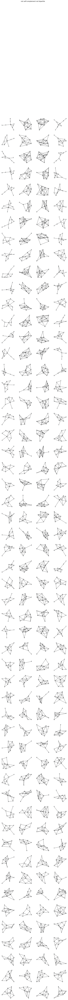

In [638]:
demonstrate(third,4,title='not self-complement not bipartite',with_labels=True)

In [2]:
demonstrate(first,4,tipe='shell',title='all 4 isomorphic',with_labels=True)

NameError: name 'demonstrate' is not defined

In [642]:
isomorphic(second[-3],second[-4],9)

True

### same on specific graphs

In [282]:
for i in itertools.permutations(Graph(g1).vertices()):
    print(i)

('0', '1', '2', '3', '4', '5', '6', '7', '8', '9')
('0', '1', '2', '3', '4', '5', '6', '7', '9', '8')
('0', '1', '2', '3', '4', '5', '6', '8', '7', '9')
('0', '1', '2', '3', '4', '5', '6', '8', '9', '7')
('0', '1', '2', '3', '4', '5', '6', '9', '7', '8')
('0', '1', '2', '3', '4', '5', '6', '9', '8', '7')
('0', '1', '2', '3', '4', '5', '7', '6', '8', '9')
('0', '1', '2', '3', '4', '5', '7', '6', '9', '8')
('0', '1', '2', '3', '4', '5', '7', '8', '6', '9')
('0', '1', '2', '3', '4', '5', '7', '8', '9', '6')
('0', '1', '2', '3', '4', '5', '7', '9', '6', '8')
('0', '1', '2', '3', '4', '5', '7', '9', '8', '6')
('0', '1', '2', '3', '4', '5', '8', '6', '7', '9')
('0', '1', '2', '3', '4', '5', '8', '6', '9', '7')
('0', '1', '2', '3', '4', '5', '8', '7', '6', '9')
('0', '1', '2', '3', '4', '5', '8', '7', '9', '6')
('0', '1', '2', '3', '4', '5', '8', '9', '6', '7')
('0', '1', '2', '3', '4', '5', '8', '9', '7', '6')
('0', '1', '2', '3', '4', '5', '9', '6', '7', '8')
('0', '1', '2', '3', '4', '5', 

('0', '1', '2', '6', '9', '8', '4', '3', '5', '7')
('0', '1', '2', '6', '9', '8', '4', '3', '7', '5')
('0', '1', '2', '6', '9', '8', '4', '5', '3', '7')
('0', '1', '2', '6', '9', '8', '4', '5', '7', '3')
('0', '1', '2', '6', '9', '8', '4', '7', '3', '5')
('0', '1', '2', '6', '9', '8', '4', '7', '5', '3')
('0', '1', '2', '6', '9', '8', '5', '3', '4', '7')
('0', '1', '2', '6', '9', '8', '5', '3', '7', '4')
('0', '1', '2', '6', '9', '8', '5', '4', '3', '7')
('0', '1', '2', '6', '9', '8', '5', '4', '7', '3')
('0', '1', '2', '6', '9', '8', '5', '7', '3', '4')
('0', '1', '2', '6', '9', '8', '5', '7', '4', '3')
('0', '1', '2', '6', '9', '8', '7', '3', '4', '5')
('0', '1', '2', '6', '9', '8', '7', '3', '5', '4')
('0', '1', '2', '6', '9', '8', '7', '4', '3', '5')
('0', '1', '2', '6', '9', '8', '7', '4', '5', '3')
('0', '1', '2', '6', '9', '8', '7', '5', '3', '4')
('0', '1', '2', '6', '9', '8', '7', '5', '4', '3')
('0', '1', '2', '7', '3', '4', '5', '6', '8', '9')
('0', '1', '2', '7', '3', '4', 

('0', '1', '2', '9', '8', '7', '3', '6', '4', '5')
('0', '1', '2', '9', '8', '7', '3', '6', '5', '4')
('0', '1', '2', '9', '8', '7', '4', '3', '5', '6')
('0', '1', '2', '9', '8', '7', '4', '3', '6', '5')
('0', '1', '2', '9', '8', '7', '4', '5', '3', '6')
('0', '1', '2', '9', '8', '7', '4', '5', '6', '3')
('0', '1', '2', '9', '8', '7', '4', '6', '3', '5')
('0', '1', '2', '9', '8', '7', '4', '6', '5', '3')
('0', '1', '2', '9', '8', '7', '5', '3', '4', '6')
('0', '1', '2', '9', '8', '7', '5', '3', '6', '4')
('0', '1', '2', '9', '8', '7', '5', '4', '3', '6')
('0', '1', '2', '9', '8', '7', '5', '4', '6', '3')
('0', '1', '2', '9', '8', '7', '5', '6', '3', '4')
('0', '1', '2', '9', '8', '7', '5', '6', '4', '3')
('0', '1', '2', '9', '8', '7', '6', '3', '4', '5')
('0', '1', '2', '9', '8', '7', '6', '3', '5', '4')
('0', '1', '2', '9', '8', '7', '6', '4', '3', '5')
('0', '1', '2', '9', '8', '7', '6', '4', '5', '3')
('0', '1', '2', '9', '8', '7', '6', '5', '3', '4')
('0', '1', '2', '9', '8', '7', 

('0', '1', '3', '6', '8', '5', '4', '7', '2', '9')
('0', '1', '3', '6', '8', '5', '4', '7', '9', '2')
('0', '1', '3', '6', '8', '5', '4', '9', '2', '7')
('0', '1', '3', '6', '8', '5', '4', '9', '7', '2')
('0', '1', '3', '6', '8', '5', '7', '2', '4', '9')
('0', '1', '3', '6', '8', '5', '7', '2', '9', '4')
('0', '1', '3', '6', '8', '5', '7', '4', '2', '9')
('0', '1', '3', '6', '8', '5', '7', '4', '9', '2')
('0', '1', '3', '6', '8', '5', '7', '9', '2', '4')
('0', '1', '3', '6', '8', '5', '7', '9', '4', '2')
('0', '1', '3', '6', '8', '5', '9', '2', '4', '7')
('0', '1', '3', '6', '8', '5', '9', '2', '7', '4')
('0', '1', '3', '6', '8', '5', '9', '4', '2', '7')
('0', '1', '3', '6', '8', '5', '9', '4', '7', '2')
('0', '1', '3', '6', '8', '5', '9', '7', '2', '4')
('0', '1', '3', '6', '8', '5', '9', '7', '4', '2')
('0', '1', '3', '6', '8', '7', '2', '4', '5', '9')
('0', '1', '3', '6', '8', '7', '2', '4', '9', '5')
('0', '1', '3', '6', '8', '7', '2', '5', '4', '9')
('0', '1', '3', '6', '8', '7', 

('0', '1', '3', '9', '8', '2', '6', '7', '5', '4')
('0', '1', '3', '9', '8', '2', '7', '4', '5', '6')
('0', '1', '3', '9', '8', '2', '7', '4', '6', '5')
('0', '1', '3', '9', '8', '2', '7', '5', '4', '6')
('0', '1', '3', '9', '8', '2', '7', '5', '6', '4')
('0', '1', '3', '9', '8', '2', '7', '6', '4', '5')
('0', '1', '3', '9', '8', '2', '7', '6', '5', '4')
('0', '1', '3', '9', '8', '4', '2', '5', '6', '7')
('0', '1', '3', '9', '8', '4', '2', '5', '7', '6')
('0', '1', '3', '9', '8', '4', '2', '6', '5', '7')
('0', '1', '3', '9', '8', '4', '2', '6', '7', '5')
('0', '1', '3', '9', '8', '4', '2', '7', '5', '6')
('0', '1', '3', '9', '8', '4', '2', '7', '6', '5')
('0', '1', '3', '9', '8', '4', '5', '2', '6', '7')
('0', '1', '3', '9', '8', '4', '5', '2', '7', '6')
('0', '1', '3', '9', '8', '4', '5', '6', '2', '7')
('0', '1', '3', '9', '8', '4', '5', '6', '7', '2')
('0', '1', '3', '9', '8', '4', '5', '7', '2', '6')
('0', '1', '3', '9', '8', '4', '5', '7', '6', '2')
('0', '1', '3', '9', '8', '4', 

('0', '1', '4', '6', '9', '8', '2', '3', '7', '5')
('0', '1', '4', '6', '9', '8', '2', '5', '3', '7')
('0', '1', '4', '6', '9', '8', '2', '5', '7', '3')
('0', '1', '4', '6', '9', '8', '2', '7', '3', '5')
('0', '1', '4', '6', '9', '8', '2', '7', '5', '3')
('0', '1', '4', '6', '9', '8', '3', '2', '5', '7')
('0', '1', '4', '6', '9', '8', '3', '2', '7', '5')
('0', '1', '4', '6', '9', '8', '3', '5', '2', '7')
('0', '1', '4', '6', '9', '8', '3', '5', '7', '2')
('0', '1', '4', '6', '9', '8', '3', '7', '2', '5')
('0', '1', '4', '6', '9', '8', '3', '7', '5', '2')
('0', '1', '4', '6', '9', '8', '5', '2', '3', '7')
('0', '1', '4', '6', '9', '8', '5', '2', '7', '3')
('0', '1', '4', '6', '9', '8', '5', '3', '2', '7')
('0', '1', '4', '6', '9', '8', '5', '3', '7', '2')
('0', '1', '4', '6', '9', '8', '5', '7', '2', '3')
('0', '1', '4', '6', '9', '8', '5', '7', '3', '2')
('0', '1', '4', '6', '9', '8', '7', '2', '3', '5')
('0', '1', '4', '6', '9', '8', '7', '2', '5', '3')
('0', '1', '4', '6', '9', '8', 

('0', '1', '5', '2', '6', '8', '3', '9', '7', '4')
('0', '1', '5', '2', '6', '8', '4', '3', '7', '9')
('0', '1', '5', '2', '6', '8', '4', '3', '9', '7')
('0', '1', '5', '2', '6', '8', '4', '7', '3', '9')
('0', '1', '5', '2', '6', '8', '4', '7', '9', '3')
('0', '1', '5', '2', '6', '8', '4', '9', '3', '7')
('0', '1', '5', '2', '6', '8', '4', '9', '7', '3')
('0', '1', '5', '2', '6', '8', '7', '3', '4', '9')
('0', '1', '5', '2', '6', '8', '7', '3', '9', '4')
('0', '1', '5', '2', '6', '8', '7', '4', '3', '9')
('0', '1', '5', '2', '6', '8', '7', '4', '9', '3')
('0', '1', '5', '2', '6', '8', '7', '9', '3', '4')
('0', '1', '5', '2', '6', '8', '7', '9', '4', '3')
('0', '1', '5', '2', '6', '8', '9', '3', '4', '7')
('0', '1', '5', '2', '6', '8', '9', '3', '7', '4')
('0', '1', '5', '2', '6', '8', '9', '4', '3', '7')
('0', '1', '5', '2', '6', '8', '9', '4', '7', '3')
('0', '1', '5', '2', '6', '8', '9', '7', '3', '4')
('0', '1', '5', '2', '6', '8', '9', '7', '4', '3')
('0', '1', '5', '2', '6', '9', 

('0', '1', '5', '6', '8', '9', '3', '4', '2', '7')
('0', '1', '5', '6', '8', '9', '3', '4', '7', '2')
('0', '1', '5', '6', '8', '9', '3', '7', '2', '4')
('0', '1', '5', '6', '8', '9', '3', '7', '4', '2')
('0', '1', '5', '6', '8', '9', '4', '2', '3', '7')
('0', '1', '5', '6', '8', '9', '4', '2', '7', '3')
('0', '1', '5', '6', '8', '9', '4', '3', '2', '7')
('0', '1', '5', '6', '8', '9', '4', '3', '7', '2')
('0', '1', '5', '6', '8', '9', '4', '7', '2', '3')
('0', '1', '5', '6', '8', '9', '4', '7', '3', '2')
('0', '1', '5', '6', '8', '9', '7', '2', '3', '4')
('0', '1', '5', '6', '8', '9', '7', '2', '4', '3')
('0', '1', '5', '6', '8', '9', '7', '3', '2', '4')
('0', '1', '5', '6', '8', '9', '7', '3', '4', '2')
('0', '1', '5', '6', '8', '9', '7', '4', '2', '3')
('0', '1', '5', '6', '8', '9', '7', '4', '3', '2')
('0', '1', '5', '6', '9', '2', '3', '4', '7', '8')
('0', '1', '5', '6', '9', '2', '3', '4', '8', '7')
('0', '1', '5', '6', '9', '2', '3', '7', '4', '8')
('0', '1', '5', '6', '9', '2', 

('0', '1', '6', '2', '9', '4', '5', '8', '7', '3')
('0', '1', '6', '2', '9', '4', '7', '3', '5', '8')
('0', '1', '6', '2', '9', '4', '7', '3', '8', '5')
('0', '1', '6', '2', '9', '4', '7', '5', '3', '8')
('0', '1', '6', '2', '9', '4', '7', '5', '8', '3')
('0', '1', '6', '2', '9', '4', '7', '8', '3', '5')
('0', '1', '6', '2', '9', '4', '7', '8', '5', '3')
('0', '1', '6', '2', '9', '4', '8', '3', '5', '7')
('0', '1', '6', '2', '9', '4', '8', '3', '7', '5')
('0', '1', '6', '2', '9', '4', '8', '5', '3', '7')
('0', '1', '6', '2', '9', '4', '8', '5', '7', '3')
('0', '1', '6', '2', '9', '4', '8', '7', '3', '5')
('0', '1', '6', '2', '9', '4', '8', '7', '5', '3')
('0', '1', '6', '2', '9', '5', '3', '4', '7', '8')
('0', '1', '6', '2', '9', '5', '3', '4', '8', '7')
('0', '1', '6', '2', '9', '5', '3', '7', '4', '8')
('0', '1', '6', '2', '9', '5', '3', '7', '8', '4')
('0', '1', '6', '2', '9', '5', '3', '8', '4', '7')
('0', '1', '6', '2', '9', '5', '3', '8', '7', '4')
('0', '1', '6', '2', '9', '5', 

('0', '1', '6', '7', '4', '2', '8', '5', '9', '3')
('0', '1', '6', '7', '4', '2', '8', '9', '3', '5')
('0', '1', '6', '7', '4', '2', '8', '9', '5', '3')
('0', '1', '6', '7', '4', '2', '9', '3', '5', '8')
('0', '1', '6', '7', '4', '2', '9', '3', '8', '5')
('0', '1', '6', '7', '4', '2', '9', '5', '3', '8')
('0', '1', '6', '7', '4', '2', '9', '5', '8', '3')
('0', '1', '6', '7', '4', '2', '9', '8', '3', '5')
('0', '1', '6', '7', '4', '2', '9', '8', '5', '3')
('0', '1', '6', '7', '4', '3', '2', '5', '8', '9')
('0', '1', '6', '7', '4', '3', '2', '5', '9', '8')
('0', '1', '6', '7', '4', '3', '2', '8', '5', '9')
('0', '1', '6', '7', '4', '3', '2', '8', '9', '5')
('0', '1', '6', '7', '4', '3', '2', '9', '5', '8')
('0', '1', '6', '7', '4', '3', '2', '9', '8', '5')
('0', '1', '6', '7', '4', '3', '5', '2', '8', '9')
('0', '1', '6', '7', '4', '3', '5', '2', '9', '8')
('0', '1', '6', '7', '4', '3', '5', '8', '2', '9')
('0', '1', '6', '7', '4', '3', '5', '8', '9', '2')
('0', '1', '6', '7', '4', '3', 

('0', '1', '7', '3', '2', '6', '4', '9', '8', '5')
('0', '1', '7', '3', '2', '6', '5', '4', '8', '9')
('0', '1', '7', '3', '2', '6', '5', '4', '9', '8')
('0', '1', '7', '3', '2', '6', '5', '8', '4', '9')
('0', '1', '7', '3', '2', '6', '5', '8', '9', '4')
('0', '1', '7', '3', '2', '6', '5', '9', '4', '8')
('0', '1', '7', '3', '2', '6', '5', '9', '8', '4')
('0', '1', '7', '3', '2', '6', '8', '4', '5', '9')
('0', '1', '7', '3', '2', '6', '8', '4', '9', '5')
('0', '1', '7', '3', '2', '6', '8', '5', '4', '9')
('0', '1', '7', '3', '2', '6', '8', '5', '9', '4')
('0', '1', '7', '3', '2', '6', '8', '9', '4', '5')
('0', '1', '7', '3', '2', '6', '8', '9', '5', '4')
('0', '1', '7', '3', '2', '6', '9', '4', '5', '8')
('0', '1', '7', '3', '2', '6', '9', '4', '8', '5')
('0', '1', '7', '3', '2', '6', '9', '5', '4', '8')
('0', '1', '7', '3', '2', '6', '9', '5', '8', '4')
('0', '1', '7', '3', '2', '6', '9', '8', '4', '5')
('0', '1', '7', '3', '2', '6', '9', '8', '5', '4')
('0', '1', '7', '3', '2', '8', 

('0', '1', '7', '6', '3', '4', '5', '9', '2', '8')
('0', '1', '7', '6', '3', '4', '5', '9', '8', '2')
('0', '1', '7', '6', '3', '4', '8', '2', '5', '9')
('0', '1', '7', '6', '3', '4', '8', '2', '9', '5')
('0', '1', '7', '6', '3', '4', '8', '5', '2', '9')
('0', '1', '7', '6', '3', '4', '8', '5', '9', '2')
('0', '1', '7', '6', '3', '4', '8', '9', '2', '5')
('0', '1', '7', '6', '3', '4', '8', '9', '5', '2')
('0', '1', '7', '6', '3', '4', '9', '2', '5', '8')
('0', '1', '7', '6', '3', '4', '9', '2', '8', '5')
('0', '1', '7', '6', '3', '4', '9', '5', '2', '8')
('0', '1', '7', '6', '3', '4', '9', '5', '8', '2')
('0', '1', '7', '6', '3', '4', '9', '8', '2', '5')
('0', '1', '7', '6', '3', '4', '9', '8', '5', '2')
('0', '1', '7', '6', '3', '5', '2', '4', '8', '9')
('0', '1', '7', '6', '3', '5', '2', '4', '9', '8')
('0', '1', '7', '6', '3', '5', '2', '8', '4', '9')
('0', '1', '7', '6', '3', '5', '2', '8', '9', '4')
('0', '1', '7', '6', '3', '5', '2', '9', '4', '8')
('0', '1', '7', '6', '3', '5', 

('0', '1', '8', '3', '4', '5', '9', '6', '7', '2')
('0', '1', '8', '3', '4', '5', '9', '7', '2', '6')
('0', '1', '8', '3', '4', '5', '9', '7', '6', '2')
('0', '1', '8', '3', '4', '6', '2', '5', '7', '9')
('0', '1', '8', '3', '4', '6', '2', '5', '9', '7')
('0', '1', '8', '3', '4', '6', '2', '7', '5', '9')
('0', '1', '8', '3', '4', '6', '2', '7', '9', '5')
('0', '1', '8', '3', '4', '6', '2', '9', '5', '7')
('0', '1', '8', '3', '4', '6', '2', '9', '7', '5')
('0', '1', '8', '3', '4', '6', '5', '2', '7', '9')
('0', '1', '8', '3', '4', '6', '5', '2', '9', '7')
('0', '1', '8', '3', '4', '6', '5', '7', '2', '9')
('0', '1', '8', '3', '4', '6', '5', '7', '9', '2')
('0', '1', '8', '3', '4', '6', '5', '9', '2', '7')
('0', '1', '8', '3', '4', '6', '5', '9', '7', '2')
('0', '1', '8', '3', '4', '6', '7', '2', '5', '9')
('0', '1', '8', '3', '4', '6', '7', '2', '9', '5')
('0', '1', '8', '3', '4', '6', '7', '5', '2', '9')
('0', '1', '8', '3', '4', '6', '7', '5', '9', '2')
('0', '1', '8', '3', '4', '6', 

('0', '1', '8', '6', '5', '2', '3', '7', '4', '9')
('0', '1', '8', '6', '5', '2', '3', '7', '9', '4')
('0', '1', '8', '6', '5', '2', '3', '9', '4', '7')
('0', '1', '8', '6', '5', '2', '3', '9', '7', '4')
('0', '1', '8', '6', '5', '2', '4', '3', '7', '9')
('0', '1', '8', '6', '5', '2', '4', '3', '9', '7')
('0', '1', '8', '6', '5', '2', '4', '7', '3', '9')
('0', '1', '8', '6', '5', '2', '4', '7', '9', '3')
('0', '1', '8', '6', '5', '2', '4', '9', '3', '7')
('0', '1', '8', '6', '5', '2', '4', '9', '7', '3')
('0', '1', '8', '6', '5', '2', '7', '3', '4', '9')
('0', '1', '8', '6', '5', '2', '7', '3', '9', '4')
('0', '1', '8', '6', '5', '2', '7', '4', '3', '9')
('0', '1', '8', '6', '5', '2', '7', '4', '9', '3')
('0', '1', '8', '6', '5', '2', '7', '9', '3', '4')
('0', '1', '8', '6', '5', '2', '7', '9', '4', '3')
('0', '1', '8', '6', '5', '2', '9', '3', '4', '7')
('0', '1', '8', '6', '5', '2', '9', '3', '7', '4')
('0', '1', '8', '6', '5', '2', '9', '4', '3', '7')
('0', '1', '8', '6', '5', '2', 

('0', '1', '9', '2', '7', '6', '8', '4', '3', '5')
('0', '1', '9', '2', '7', '6', '8', '4', '5', '3')
('0', '1', '9', '2', '7', '6', '8', '5', '3', '4')
('0', '1', '9', '2', '7', '6', '8', '5', '4', '3')
('0', '1', '9', '2', '7', '8', '3', '4', '5', '6')
('0', '1', '9', '2', '7', '8', '3', '4', '6', '5')
('0', '1', '9', '2', '7', '8', '3', '5', '4', '6')
('0', '1', '9', '2', '7', '8', '3', '5', '6', '4')
('0', '1', '9', '2', '7', '8', '3', '6', '4', '5')
('0', '1', '9', '2', '7', '8', '3', '6', '5', '4')
('0', '1', '9', '2', '7', '8', '4', '3', '5', '6')
('0', '1', '9', '2', '7', '8', '4', '3', '6', '5')
('0', '1', '9', '2', '7', '8', '4', '5', '3', '6')
('0', '1', '9', '2', '7', '8', '4', '5', '6', '3')
('0', '1', '9', '2', '7', '8', '4', '6', '3', '5')
('0', '1', '9', '2', '7', '8', '4', '6', '5', '3')
('0', '1', '9', '2', '7', '8', '5', '3', '4', '6')
('0', '1', '9', '2', '7', '8', '5', '3', '6', '4')
('0', '1', '9', '2', '7', '8', '5', '4', '3', '6')
('0', '1', '9', '2', '7', '8', 

('0', '1', '9', '6', '4', '5', '2', '7', '3', '8')
('0', '1', '9', '6', '4', '5', '2', '7', '8', '3')
('0', '1', '9', '6', '4', '5', '2', '8', '3', '7')
('0', '1', '9', '6', '4', '5', '2', '8', '7', '3')
('0', '1', '9', '6', '4', '5', '3', '2', '7', '8')
('0', '1', '9', '6', '4', '5', '3', '2', '8', '7')
('0', '1', '9', '6', '4', '5', '3', '7', '2', '8')
('0', '1', '9', '6', '4', '5', '3', '7', '8', '2')
('0', '1', '9', '6', '4', '5', '3', '8', '2', '7')
('0', '1', '9', '6', '4', '5', '3', '8', '7', '2')
('0', '1', '9', '6', '4', '5', '7', '2', '3', '8')
('0', '1', '9', '6', '4', '5', '7', '2', '8', '3')
('0', '1', '9', '6', '4', '5', '7', '3', '2', '8')
('0', '1', '9', '6', '4', '5', '7', '3', '8', '2')
('0', '1', '9', '6', '4', '5', '7', '8', '2', '3')
('0', '1', '9', '6', '4', '5', '7', '8', '3', '2')
('0', '1', '9', '6', '4', '5', '8', '2', '3', '7')
('0', '1', '9', '6', '4', '5', '8', '2', '7', '3')
('0', '1', '9', '6', '4', '5', '8', '3', '2', '7')
('0', '1', '9', '6', '4', '5', 

('0', '2', '1', '3', '8', '7', '5', '6', '9', '4')
('0', '2', '1', '3', '8', '7', '5', '9', '4', '6')
('0', '2', '1', '3', '8', '7', '5', '9', '6', '4')
('0', '2', '1', '3', '8', '7', '6', '4', '5', '9')
('0', '2', '1', '3', '8', '7', '6', '4', '9', '5')
('0', '2', '1', '3', '8', '7', '6', '5', '4', '9')
('0', '2', '1', '3', '8', '7', '6', '5', '9', '4')
('0', '2', '1', '3', '8', '7', '6', '9', '4', '5')
('0', '2', '1', '3', '8', '7', '6', '9', '5', '4')
('0', '2', '1', '3', '8', '7', '9', '4', '5', '6')
('0', '2', '1', '3', '8', '7', '9', '4', '6', '5')
('0', '2', '1', '3', '8', '7', '9', '5', '4', '6')
('0', '2', '1', '3', '8', '7', '9', '5', '6', '4')
('0', '2', '1', '3', '8', '7', '9', '6', '4', '5')
('0', '2', '1', '3', '8', '7', '9', '6', '5', '4')
('0', '2', '1', '3', '8', '9', '4', '5', '6', '7')
('0', '2', '1', '3', '8', '9', '4', '5', '7', '6')
('0', '2', '1', '3', '8', '9', '4', '6', '5', '7')
('0', '2', '1', '3', '8', '9', '4', '6', '7', '5')
('0', '2', '1', '3', '8', '9', 

('0', '2', '1', '6', '9', '3', '4', '8', '5', '7')
('0', '2', '1', '6', '9', '3', '4', '8', '7', '5')
('0', '2', '1', '6', '9', '3', '5', '4', '7', '8')
('0', '2', '1', '6', '9', '3', '5', '4', '8', '7')
('0', '2', '1', '6', '9', '3', '5', '7', '4', '8')
('0', '2', '1', '6', '9', '3', '5', '7', '8', '4')
('0', '2', '1', '6', '9', '3', '5', '8', '4', '7')
('0', '2', '1', '6', '9', '3', '5', '8', '7', '4')
('0', '2', '1', '6', '9', '3', '7', '4', '5', '8')
('0', '2', '1', '6', '9', '3', '7', '4', '8', '5')
('0', '2', '1', '6', '9', '3', '7', '5', '4', '8')
('0', '2', '1', '6', '9', '3', '7', '5', '8', '4')
('0', '2', '1', '6', '9', '3', '7', '8', '4', '5')
('0', '2', '1', '6', '9', '3', '7', '8', '5', '4')
('0', '2', '1', '6', '9', '3', '8', '4', '5', '7')
('0', '2', '1', '6', '9', '3', '8', '4', '7', '5')
('0', '2', '1', '6', '9', '3', '8', '5', '4', '7')
('0', '2', '1', '6', '9', '3', '8', '5', '7', '4')
('0', '2', '1', '6', '9', '3', '8', '7', '4', '5')
('0', '2', '1', '6', '9', '3', 

('0', '2', '3', '1', '6', '5', '7', '4', '9', '8')
('0', '2', '3', '1', '6', '5', '7', '8', '4', '9')
('0', '2', '3', '1', '6', '5', '7', '8', '9', '4')
('0', '2', '3', '1', '6', '5', '7', '9', '4', '8')
('0', '2', '3', '1', '6', '5', '7', '9', '8', '4')
('0', '2', '3', '1', '6', '5', '8', '4', '7', '9')
('0', '2', '3', '1', '6', '5', '8', '4', '9', '7')
('0', '2', '3', '1', '6', '5', '8', '7', '4', '9')
('0', '2', '3', '1', '6', '5', '8', '7', '9', '4')
('0', '2', '3', '1', '6', '5', '8', '9', '4', '7')
('0', '2', '3', '1', '6', '5', '8', '9', '7', '4')
('0', '2', '3', '1', '6', '5', '9', '4', '7', '8')
('0', '2', '3', '1', '6', '5', '9', '4', '8', '7')
('0', '2', '3', '1', '6', '5', '9', '7', '4', '8')
('0', '2', '3', '1', '6', '5', '9', '7', '8', '4')
('0', '2', '3', '1', '6', '5', '9', '8', '4', '7')
('0', '2', '3', '1', '6', '5', '9', '8', '7', '4')
('0', '2', '3', '1', '6', '7', '4', '5', '8', '9')
('0', '2', '3', '1', '6', '7', '4', '5', '9', '8')
('0', '2', '3', '1', '6', '7', 

('0', '2', '3', '6', '9', '5', '4', '7', '1', '8')
('0', '2', '3', '6', '9', '5', '4', '7', '8', '1')
('0', '2', '3', '6', '9', '5', '4', '8', '1', '7')
('0', '2', '3', '6', '9', '5', '4', '8', '7', '1')
('0', '2', '3', '6', '9', '5', '7', '1', '4', '8')
('0', '2', '3', '6', '9', '5', '7', '1', '8', '4')
('0', '2', '3', '6', '9', '5', '7', '4', '1', '8')
('0', '2', '3', '6', '9', '5', '7', '4', '8', '1')
('0', '2', '3', '6', '9', '5', '7', '8', '1', '4')
('0', '2', '3', '6', '9', '5', '7', '8', '4', '1')
('0', '2', '3', '6', '9', '5', '8', '1', '4', '7')
('0', '2', '3', '6', '9', '5', '8', '1', '7', '4')
('0', '2', '3', '6', '9', '5', '8', '4', '1', '7')
('0', '2', '3', '6', '9', '5', '8', '4', '7', '1')
('0', '2', '3', '6', '9', '5', '8', '7', '1', '4')
('0', '2', '3', '6', '9', '5', '8', '7', '4', '1')
('0', '2', '3', '6', '9', '7', '1', '4', '5', '8')
('0', '2', '3', '6', '9', '7', '1', '4', '8', '5')
('0', '2', '3', '6', '9', '7', '1', '5', '4', '8')
('0', '2', '3', '6', '9', '7', 

('0', '2', '4', '1', '5', '9', '6', '7', '3', '8')
('0', '2', '4', '1', '5', '9', '6', '7', '8', '3')
('0', '2', '4', '1', '5', '9', '6', '8', '3', '7')
('0', '2', '4', '1', '5', '9', '6', '8', '7', '3')
('0', '2', '4', '1', '5', '9', '7', '3', '6', '8')
('0', '2', '4', '1', '5', '9', '7', '3', '8', '6')
('0', '2', '4', '1', '5', '9', '7', '6', '3', '8')
('0', '2', '4', '1', '5', '9', '7', '6', '8', '3')
('0', '2', '4', '1', '5', '9', '7', '8', '3', '6')
('0', '2', '4', '1', '5', '9', '7', '8', '6', '3')
('0', '2', '4', '1', '5', '9', '8', '3', '6', '7')
('0', '2', '4', '1', '5', '9', '8', '3', '7', '6')
('0', '2', '4', '1', '5', '9', '8', '6', '3', '7')
('0', '2', '4', '1', '5', '9', '8', '6', '7', '3')
('0', '2', '4', '1', '5', '9', '8', '7', '3', '6')
('0', '2', '4', '1', '5', '9', '8', '7', '6', '3')
('0', '2', '4', '1', '6', '3', '5', '7', '8', '9')
('0', '2', '4', '1', '6', '3', '5', '7', '9', '8')
('0', '2', '4', '1', '6', '3', '5', '8', '7', '9')
('0', '2', '4', '1', '6', '3', 

('0', '2', '4', '7', '1', '9', '8', '5', '6', '3')
('0', '2', '4', '7', '1', '9', '8', '6', '3', '5')
('0', '2', '4', '7', '1', '9', '8', '6', '5', '3')
('0', '2', '4', '7', '3', '1', '5', '6', '8', '9')
('0', '2', '4', '7', '3', '1', '5', '6', '9', '8')
('0', '2', '4', '7', '3', '1', '5', '8', '6', '9')
('0', '2', '4', '7', '3', '1', '5', '8', '9', '6')
('0', '2', '4', '7', '3', '1', '5', '9', '6', '8')
('0', '2', '4', '7', '3', '1', '5', '9', '8', '6')
('0', '2', '4', '7', '3', '1', '6', '5', '8', '9')
('0', '2', '4', '7', '3', '1', '6', '5', '9', '8')
('0', '2', '4', '7', '3', '1', '6', '8', '5', '9')
('0', '2', '4', '7', '3', '1', '6', '8', '9', '5')
('0', '2', '4', '7', '3', '1', '6', '9', '5', '8')
('0', '2', '4', '7', '3', '1', '6', '9', '8', '5')
('0', '2', '4', '7', '3', '1', '8', '5', '6', '9')
('0', '2', '4', '7', '3', '1', '8', '5', '9', '6')
('0', '2', '4', '7', '3', '1', '8', '6', '5', '9')
('0', '2', '4', '7', '3', '1', '8', '6', '9', '5')
('0', '2', '4', '7', '3', '1', 

('0', '2', '5', '1', '8', '9', '3', '7', '6', '4')
('0', '2', '5', '1', '8', '9', '4', '3', '6', '7')
('0', '2', '5', '1', '8', '9', '4', '3', '7', '6')
('0', '2', '5', '1', '8', '9', '4', '6', '3', '7')
('0', '2', '5', '1', '8', '9', '4', '6', '7', '3')
('0', '2', '5', '1', '8', '9', '4', '7', '3', '6')
('0', '2', '5', '1', '8', '9', '4', '7', '6', '3')
('0', '2', '5', '1', '8', '9', '6', '3', '4', '7')
('0', '2', '5', '1', '8', '9', '6', '3', '7', '4')
('0', '2', '5', '1', '8', '9', '6', '4', '3', '7')
('0', '2', '5', '1', '8', '9', '6', '4', '7', '3')
('0', '2', '5', '1', '8', '9', '6', '7', '3', '4')
('0', '2', '5', '1', '8', '9', '6', '7', '4', '3')
('0', '2', '5', '1', '8', '9', '7', '3', '4', '6')
('0', '2', '5', '1', '8', '9', '7', '3', '6', '4')
('0', '2', '5', '1', '8', '9', '7', '4', '3', '6')
('0', '2', '5', '1', '8', '9', '7', '4', '6', '3')
('0', '2', '5', '1', '8', '9', '7', '6', '3', '4')
('0', '2', '5', '1', '8', '9', '7', '6', '4', '3')
('0', '2', '5', '1', '9', '3', 

('0', '2', '5', '6', '8', '9', '3', '7', '1', '4')
('0', '2', '5', '6', '8', '9', '3', '7', '4', '1')
('0', '2', '5', '6', '8', '9', '4', '1', '3', '7')
('0', '2', '5', '6', '8', '9', '4', '1', '7', '3')
('0', '2', '5', '6', '8', '9', '4', '3', '1', '7')
('0', '2', '5', '6', '8', '9', '4', '3', '7', '1')
('0', '2', '5', '6', '8', '9', '4', '7', '1', '3')
('0', '2', '5', '6', '8', '9', '4', '7', '3', '1')
('0', '2', '5', '6', '8', '9', '7', '1', '3', '4')
('0', '2', '5', '6', '8', '9', '7', '1', '4', '3')
('0', '2', '5', '6', '8', '9', '7', '3', '1', '4')
('0', '2', '5', '6', '8', '9', '7', '3', '4', '1')
('0', '2', '5', '6', '8', '9', '7', '4', '1', '3')
('0', '2', '5', '6', '8', '9', '7', '4', '3', '1')
('0', '2', '5', '6', '9', '1', '3', '4', '7', '8')
('0', '2', '5', '6', '9', '1', '3', '4', '8', '7')
('0', '2', '5', '6', '9', '1', '3', '7', '4', '8')
('0', '2', '5', '6', '9', '1', '3', '7', '8', '4')
('0', '2', '5', '6', '9', '1', '3', '8', '4', '7')
('0', '2', '5', '6', '9', '1', 

('0', '2', '6', '1', '3', '9', '7', '5', '8', '4')
('0', '2', '6', '1', '3', '9', '7', '8', '4', '5')
('0', '2', '6', '1', '3', '9', '7', '8', '5', '4')
('0', '2', '6', '1', '3', '9', '8', '4', '5', '7')
('0', '2', '6', '1', '3', '9', '8', '4', '7', '5')
('0', '2', '6', '1', '3', '9', '8', '5', '4', '7')
('0', '2', '6', '1', '3', '9', '8', '5', '7', '4')
('0', '2', '6', '1', '3', '9', '8', '7', '4', '5')
('0', '2', '6', '1', '3', '9', '8', '7', '5', '4')
('0', '2', '6', '1', '4', '3', '5', '7', '8', '9')
('0', '2', '6', '1', '4', '3', '5', '7', '9', '8')
('0', '2', '6', '1', '4', '3', '5', '8', '7', '9')
('0', '2', '6', '1', '4', '3', '5', '8', '9', '7')
('0', '2', '6', '1', '4', '3', '5', '9', '7', '8')
('0', '2', '6', '1', '4', '3', '5', '9', '8', '7')
('0', '2', '6', '1', '4', '3', '7', '5', '8', '9')
('0', '2', '6', '1', '4', '3', '7', '5', '9', '8')
('0', '2', '6', '1', '4', '3', '7', '8', '5', '9')
('0', '2', '6', '1', '4', '3', '7', '8', '9', '5')
('0', '2', '6', '1', '4', '3', 

('0', '2', '6', '5', '7', '1', '9', '4', '8', '3')
('0', '2', '6', '5', '7', '1', '9', '8', '3', '4')
('0', '2', '6', '5', '7', '1', '9', '8', '4', '3')
('0', '2', '6', '5', '7', '3', '1', '4', '8', '9')
('0', '2', '6', '5', '7', '3', '1', '4', '9', '8')
('0', '2', '6', '5', '7', '3', '1', '8', '4', '9')
('0', '2', '6', '5', '7', '3', '1', '8', '9', '4')
('0', '2', '6', '5', '7', '3', '1', '9', '4', '8')
('0', '2', '6', '5', '7', '3', '1', '9', '8', '4')
('0', '2', '6', '5', '7', '3', '4', '1', '8', '9')
('0', '2', '6', '5', '7', '3', '4', '1', '9', '8')
('0', '2', '6', '5', '7', '3', '4', '8', '1', '9')
('0', '2', '6', '5', '7', '3', '4', '8', '9', '1')
('0', '2', '6', '5', '7', '3', '4', '9', '1', '8')
('0', '2', '6', '5', '7', '3', '4', '9', '8', '1')
('0', '2', '6', '5', '7', '3', '8', '1', '4', '9')
('0', '2', '6', '5', '7', '3', '8', '1', '9', '4')
('0', '2', '6', '5', '7', '3', '8', '4', '1', '9')
('0', '2', '6', '5', '7', '3', '8', '4', '9', '1')
('0', '2', '6', '5', '7', '3', 

('0', '2', '7', '1', '3', '5', '8', '9', '6', '4')
('0', '2', '7', '1', '3', '5', '9', '4', '6', '8')
('0', '2', '7', '1', '3', '5', '9', '4', '8', '6')
('0', '2', '7', '1', '3', '5', '9', '6', '4', '8')
('0', '2', '7', '1', '3', '5', '9', '6', '8', '4')
('0', '2', '7', '1', '3', '5', '9', '8', '4', '6')
('0', '2', '7', '1', '3', '5', '9', '8', '6', '4')
('0', '2', '7', '1', '3', '6', '4', '5', '8', '9')
('0', '2', '7', '1', '3', '6', '4', '5', '9', '8')
('0', '2', '7', '1', '3', '6', '4', '8', '5', '9')
('0', '2', '7', '1', '3', '6', '4', '8', '9', '5')
('0', '2', '7', '1', '3', '6', '4', '9', '5', '8')
('0', '2', '7', '1', '3', '6', '4', '9', '8', '5')
('0', '2', '7', '1', '3', '6', '5', '4', '8', '9')
('0', '2', '7', '1', '3', '6', '5', '4', '9', '8')
('0', '2', '7', '1', '3', '6', '5', '8', '4', '9')
('0', '2', '7', '1', '3', '6', '5', '8', '9', '4')
('0', '2', '7', '1', '3', '6', '5', '9', '4', '8')
('0', '2', '7', '1', '3', '6', '5', '9', '8', '4')
('0', '2', '7', '1', '3', '6', 

('0', '2', '7', '6', '1', '5', '8', '9', '4', '3')
('0', '2', '7', '6', '1', '5', '9', '3', '4', '8')
('0', '2', '7', '6', '1', '5', '9', '3', '8', '4')
('0', '2', '7', '6', '1', '5', '9', '4', '3', '8')
('0', '2', '7', '6', '1', '5', '9', '4', '8', '3')
('0', '2', '7', '6', '1', '5', '9', '8', '3', '4')
('0', '2', '7', '6', '1', '5', '9', '8', '4', '3')
('0', '2', '7', '6', '1', '8', '3', '4', '5', '9')
('0', '2', '7', '6', '1', '8', '3', '4', '9', '5')
('0', '2', '7', '6', '1', '8', '3', '5', '4', '9')
('0', '2', '7', '6', '1', '8', '3', '5', '9', '4')
('0', '2', '7', '6', '1', '8', '3', '9', '4', '5')
('0', '2', '7', '6', '1', '8', '3', '9', '5', '4')
('0', '2', '7', '6', '1', '8', '4', '3', '5', '9')
('0', '2', '7', '6', '1', '8', '4', '3', '9', '5')
('0', '2', '7', '6', '1', '8', '4', '5', '3', '9')
('0', '2', '7', '6', '1', '8', '4', '5', '9', '3')
('0', '2', '7', '6', '1', '8', '4', '9', '3', '5')
('0', '2', '7', '6', '1', '8', '4', '9', '5', '3')
('0', '2', '7', '6', '1', '8', 

('0', '2', '8', '3', '1', '7', '5', '6', '9', '4')
('0', '2', '8', '3', '1', '7', '5', '9', '4', '6')
('0', '2', '8', '3', '1', '7', '5', '9', '6', '4')
('0', '2', '8', '3', '1', '7', '6', '4', '5', '9')
('0', '2', '8', '3', '1', '7', '6', '4', '9', '5')
('0', '2', '8', '3', '1', '7', '6', '5', '4', '9')
('0', '2', '8', '3', '1', '7', '6', '5', '9', '4')
('0', '2', '8', '3', '1', '7', '6', '9', '4', '5')
('0', '2', '8', '3', '1', '7', '6', '9', '5', '4')
('0', '2', '8', '3', '1', '7', '9', '4', '5', '6')
('0', '2', '8', '3', '1', '7', '9', '4', '6', '5')
('0', '2', '8', '3', '1', '7', '9', '5', '4', '6')
('0', '2', '8', '3', '1', '7', '9', '5', '6', '4')
('0', '2', '8', '3', '1', '7', '9', '6', '4', '5')
('0', '2', '8', '3', '1', '7', '9', '6', '5', '4')
('0', '2', '8', '3', '1', '9', '4', '5', '6', '7')
('0', '2', '8', '3', '1', '9', '4', '5', '7', '6')
('0', '2', '8', '3', '1', '9', '4', '6', '5', '7')
('0', '2', '8', '3', '1', '9', '4', '6', '7', '5')
('0', '2', '8', '3', '1', '9', 

('0', '2', '8', '7', '3', '9', '5', '1', '4', '6')
('0', '2', '8', '7', '3', '9', '5', '1', '6', '4')
('0', '2', '8', '7', '3', '9', '5', '4', '1', '6')
('0', '2', '8', '7', '3', '9', '5', '4', '6', '1')
('0', '2', '8', '7', '3', '9', '5', '6', '1', '4')
('0', '2', '8', '7', '3', '9', '5', '6', '4', '1')
('0', '2', '8', '7', '3', '9', '6', '1', '4', '5')
('0', '2', '8', '7', '3', '9', '6', '1', '5', '4')
('0', '2', '8', '7', '3', '9', '6', '4', '1', '5')
('0', '2', '8', '7', '3', '9', '6', '4', '5', '1')
('0', '2', '8', '7', '3', '9', '6', '5', '1', '4')
('0', '2', '8', '7', '3', '9', '6', '5', '4', '1')
('0', '2', '8', '7', '4', '1', '3', '5', '6', '9')
('0', '2', '8', '7', '4', '1', '3', '5', '9', '6')
('0', '2', '8', '7', '4', '1', '3', '6', '5', '9')
('0', '2', '8', '7', '4', '1', '3', '6', '9', '5')
('0', '2', '8', '7', '4', '1', '3', '9', '5', '6')
('0', '2', '8', '7', '4', '1', '3', '9', '6', '5')
('0', '2', '8', '7', '4', '1', '5', '3', '6', '9')
('0', '2', '8', '7', '4', '1', 

('0', '2', '9', '3', '8', '6', '1', '7', '4', '5')
('0', '2', '9', '3', '8', '6', '1', '7', '5', '4')
('0', '2', '9', '3', '8', '6', '4', '1', '5', '7')
('0', '2', '9', '3', '8', '6', '4', '1', '7', '5')
('0', '2', '9', '3', '8', '6', '4', '5', '1', '7')
('0', '2', '9', '3', '8', '6', '4', '5', '7', '1')
('0', '2', '9', '3', '8', '6', '4', '7', '1', '5')
('0', '2', '9', '3', '8', '6', '4', '7', '5', '1')
('0', '2', '9', '3', '8', '6', '5', '1', '4', '7')
('0', '2', '9', '3', '8', '6', '5', '1', '7', '4')
('0', '2', '9', '3', '8', '6', '5', '4', '1', '7')
('0', '2', '9', '3', '8', '6', '5', '4', '7', '1')
('0', '2', '9', '3', '8', '6', '5', '7', '1', '4')
('0', '2', '9', '3', '8', '6', '5', '7', '4', '1')
('0', '2', '9', '3', '8', '6', '7', '1', '4', '5')
('0', '2', '9', '3', '8', '6', '7', '1', '5', '4')
('0', '2', '9', '3', '8', '6', '7', '4', '1', '5')
('0', '2', '9', '3', '8', '6', '7', '4', '5', '1')
('0', '2', '9', '3', '8', '6', '7', '5', '1', '4')
('0', '2', '9', '3', '8', '6', 

('0', '2', '9', '7', '5', '3', '4', '1', '6', '8')
('0', '2', '9', '7', '5', '3', '4', '1', '8', '6')
('0', '2', '9', '7', '5', '3', '4', '6', '1', '8')
('0', '2', '9', '7', '5', '3', '4', '6', '8', '1')
('0', '2', '9', '7', '5', '3', '4', '8', '1', '6')
('0', '2', '9', '7', '5', '3', '4', '8', '6', '1')
('0', '2', '9', '7', '5', '3', '6', '1', '4', '8')
('0', '2', '9', '7', '5', '3', '6', '1', '8', '4')
('0', '2', '9', '7', '5', '3', '6', '4', '1', '8')
('0', '2', '9', '7', '5', '3', '6', '4', '8', '1')
('0', '2', '9', '7', '5', '3', '6', '8', '1', '4')
('0', '2', '9', '7', '5', '3', '6', '8', '4', '1')
('0', '2', '9', '7', '5', '3', '8', '1', '4', '6')
('0', '2', '9', '7', '5', '3', '8', '1', '6', '4')
('0', '2', '9', '7', '5', '3', '8', '4', '1', '6')
('0', '2', '9', '7', '5', '3', '8', '4', '6', '1')
('0', '2', '9', '7', '5', '3', '8', '6', '1', '4')
('0', '2', '9', '7', '5', '3', '8', '6', '4', '1')
('0', '2', '9', '7', '5', '4', '1', '3', '6', '8')
('0', '2', '9', '7', '5', '4', 

('0', '3', '1', '5', '4', '8', '6', '7', '2', '9')
('0', '3', '1', '5', '4', '8', '6', '7', '9', '2')
('0', '3', '1', '5', '4', '8', '6', '9', '2', '7')
('0', '3', '1', '5', '4', '8', '6', '9', '7', '2')
('0', '3', '1', '5', '4', '8', '7', '2', '6', '9')
('0', '3', '1', '5', '4', '8', '7', '2', '9', '6')
('0', '3', '1', '5', '4', '8', '7', '6', '2', '9')
('0', '3', '1', '5', '4', '8', '7', '6', '9', '2')
('0', '3', '1', '5', '4', '8', '7', '9', '2', '6')
('0', '3', '1', '5', '4', '8', '7', '9', '6', '2')
('0', '3', '1', '5', '4', '8', '9', '2', '6', '7')
('0', '3', '1', '5', '4', '8', '9', '2', '7', '6')
('0', '3', '1', '5', '4', '8', '9', '6', '2', '7')
('0', '3', '1', '5', '4', '8', '9', '6', '7', '2')
('0', '3', '1', '5', '4', '8', '9', '7', '2', '6')
('0', '3', '1', '5', '4', '8', '9', '7', '6', '2')
('0', '3', '1', '5', '4', '9', '2', '6', '7', '8')
('0', '3', '1', '5', '4', '9', '2', '6', '8', '7')
('0', '3', '1', '5', '4', '9', '2', '7', '6', '8')
('0', '3', '1', '5', '4', '9', 

('0', '3', '1', '9', '2', '7', '6', '5', '4', '8')
('0', '3', '1', '9', '2', '7', '6', '5', '8', '4')
('0', '3', '1', '9', '2', '7', '6', '8', '4', '5')
('0', '3', '1', '9', '2', '7', '6', '8', '5', '4')
('0', '3', '1', '9', '2', '7', '8', '4', '5', '6')
('0', '3', '1', '9', '2', '7', '8', '4', '6', '5')
('0', '3', '1', '9', '2', '7', '8', '5', '4', '6')
('0', '3', '1', '9', '2', '7', '8', '5', '6', '4')
('0', '3', '1', '9', '2', '7', '8', '6', '4', '5')
('0', '3', '1', '9', '2', '7', '8', '6', '5', '4')
('0', '3', '1', '9', '2', '8', '4', '5', '6', '7')
('0', '3', '1', '9', '2', '8', '4', '5', '7', '6')
('0', '3', '1', '9', '2', '8', '4', '6', '5', '7')
('0', '3', '1', '9', '2', '8', '4', '6', '7', '5')
('0', '3', '1', '9', '2', '8', '4', '7', '5', '6')
('0', '3', '1', '9', '2', '8', '4', '7', '6', '5')
('0', '3', '1', '9', '2', '8', '5', '4', '6', '7')
('0', '3', '1', '9', '2', '8', '5', '4', '7', '6')
('0', '3', '1', '9', '2', '8', '5', '6', '4', '7')
('0', '3', '1', '9', '2', '8', 

('0', '3', '2', '6', '4', '1', '8', '9', '5', '7')
('0', '3', '2', '6', '4', '1', '8', '9', '7', '5')
('0', '3', '2', '6', '4', '1', '9', '5', '7', '8')
('0', '3', '2', '6', '4', '1', '9', '5', '8', '7')
('0', '3', '2', '6', '4', '1', '9', '7', '5', '8')
('0', '3', '2', '6', '4', '1', '9', '7', '8', '5')
('0', '3', '2', '6', '4', '1', '9', '8', '5', '7')
('0', '3', '2', '6', '4', '1', '9', '8', '7', '5')
('0', '3', '2', '6', '4', '5', '1', '7', '8', '9')
('0', '3', '2', '6', '4', '5', '1', '7', '9', '8')
('0', '3', '2', '6', '4', '5', '1', '8', '7', '9')
('0', '3', '2', '6', '4', '5', '1', '8', '9', '7')
('0', '3', '2', '6', '4', '5', '1', '9', '7', '8')
('0', '3', '2', '6', '4', '5', '1', '9', '8', '7')
('0', '3', '2', '6', '4', '5', '7', '1', '8', '9')
('0', '3', '2', '6', '4', '5', '7', '1', '9', '8')
('0', '3', '2', '6', '4', '5', '7', '8', '1', '9')
('0', '3', '2', '6', '4', '5', '7', '8', '9', '1')
('0', '3', '2', '6', '4', '5', '7', '9', '1', '8')
('0', '3', '2', '6', '4', '5', 

('0', '3', '2', '9', '8', '7', '4', '5', '6', '1')
('0', '3', '2', '9', '8', '7', '4', '6', '1', '5')
('0', '3', '2', '9', '8', '7', '4', '6', '5', '1')
('0', '3', '2', '9', '8', '7', '5', '1', '4', '6')
('0', '3', '2', '9', '8', '7', '5', '1', '6', '4')
('0', '3', '2', '9', '8', '7', '5', '4', '1', '6')
('0', '3', '2', '9', '8', '7', '5', '4', '6', '1')
('0', '3', '2', '9', '8', '7', '5', '6', '1', '4')
('0', '3', '2', '9', '8', '7', '5', '6', '4', '1')
('0', '3', '2', '9', '8', '7', '6', '1', '4', '5')
('0', '3', '2', '9', '8', '7', '6', '1', '5', '4')
('0', '3', '2', '9', '8', '7', '6', '4', '1', '5')
('0', '3', '2', '9', '8', '7', '6', '4', '5', '1')
('0', '3', '2', '9', '8', '7', '6', '5', '1', '4')
('0', '3', '2', '9', '8', '7', '6', '5', '4', '1')
('0', '3', '4', '1', '2', '5', '6', '7', '8', '9')
('0', '3', '4', '1', '2', '5', '6', '7', '9', '8')
('0', '3', '4', '1', '2', '5', '6', '8', '7', '9')
('0', '3', '4', '1', '2', '5', '6', '8', '9', '7')
('0', '3', '4', '1', '2', '5', 

('0', '3', '4', '7', '6', '1', '2', '5', '8', '9')
('0', '3', '4', '7', '6', '1', '2', '5', '9', '8')
('0', '3', '4', '7', '6', '1', '2', '8', '5', '9')
('0', '3', '4', '7', '6', '1', '2', '8', '9', '5')
('0', '3', '4', '7', '6', '1', '2', '9', '5', '8')
('0', '3', '4', '7', '6', '1', '2', '9', '8', '5')
('0', '3', '4', '7', '6', '1', '5', '2', '8', '9')
('0', '3', '4', '7', '6', '1', '5', '2', '9', '8')
('0', '3', '4', '7', '6', '1', '5', '8', '2', '9')
('0', '3', '4', '7', '6', '1', '5', '8', '9', '2')
('0', '3', '4', '7', '6', '1', '5', '9', '2', '8')
('0', '3', '4', '7', '6', '1', '5', '9', '8', '2')
('0', '3', '4', '7', '6', '1', '8', '2', '5', '9')
('0', '3', '4', '7', '6', '1', '8', '2', '9', '5')
('0', '3', '4', '7', '6', '1', '8', '5', '2', '9')
('0', '3', '4', '7', '6', '1', '8', '5', '9', '2')
('0', '3', '4', '7', '6', '1', '8', '9', '2', '5')
('0', '3', '4', '7', '6', '1', '8', '9', '5', '2')
('0', '3', '4', '7', '6', '1', '9', '2', '5', '8')
('0', '3', '4', '7', '6', '1', 

('0', '3', '5', '2', '8', '1', '4', '6', '7', '9')
('0', '3', '5', '2', '8', '1', '4', '6', '9', '7')
('0', '3', '5', '2', '8', '1', '4', '7', '6', '9')
('0', '3', '5', '2', '8', '1', '4', '7', '9', '6')
('0', '3', '5', '2', '8', '1', '4', '9', '6', '7')
('0', '3', '5', '2', '8', '1', '4', '9', '7', '6')
('0', '3', '5', '2', '8', '1', '6', '4', '7', '9')
('0', '3', '5', '2', '8', '1', '6', '4', '9', '7')
('0', '3', '5', '2', '8', '1', '6', '7', '4', '9')
('0', '3', '5', '2', '8', '1', '6', '7', '9', '4')
('0', '3', '5', '2', '8', '1', '6', '9', '4', '7')
('0', '3', '5', '2', '8', '1', '6', '9', '7', '4')
('0', '3', '5', '2', '8', '1', '7', '4', '6', '9')
('0', '3', '5', '2', '8', '1', '7', '4', '9', '6')
('0', '3', '5', '2', '8', '1', '7', '6', '4', '9')
('0', '3', '5', '2', '8', '1', '7', '6', '9', '4')
('0', '3', '5', '2', '8', '1', '7', '9', '4', '6')
('0', '3', '5', '2', '8', '1', '7', '9', '6', '4')
('0', '3', '5', '2', '8', '1', '9', '4', '6', '7')
('0', '3', '5', '2', '8', '1', 

('0', '3', '5', '7', '8', '9', '6', '2', '1', '4')
('0', '3', '5', '7', '8', '9', '6', '2', '4', '1')
('0', '3', '5', '7', '8', '9', '6', '4', '1', '2')
('0', '3', '5', '7', '8', '9', '6', '4', '2', '1')
('0', '3', '5', '7', '9', '1', '2', '4', '6', '8')
('0', '3', '5', '7', '9', '1', '2', '4', '8', '6')
('0', '3', '5', '7', '9', '1', '2', '6', '4', '8')
('0', '3', '5', '7', '9', '1', '2', '6', '8', '4')
('0', '3', '5', '7', '9', '1', '2', '8', '4', '6')
('0', '3', '5', '7', '9', '1', '2', '8', '6', '4')
('0', '3', '5', '7', '9', '1', '4', '2', '6', '8')
('0', '3', '5', '7', '9', '1', '4', '2', '8', '6')
('0', '3', '5', '7', '9', '1', '4', '6', '2', '8')
('0', '3', '5', '7', '9', '1', '4', '6', '8', '2')
('0', '3', '5', '7', '9', '1', '4', '8', '2', '6')
('0', '3', '5', '7', '9', '1', '4', '8', '6', '2')
('0', '3', '5', '7', '9', '1', '6', '2', '4', '8')
('0', '3', '5', '7', '9', '1', '6', '2', '8', '4')
('0', '3', '5', '7', '9', '1', '6', '4', '2', '8')
('0', '3', '5', '7', '9', '1', 

('0', '3', '6', '4', '2', '7', '9', '5', '1', '8')
('0', '3', '6', '4', '2', '7', '9', '5', '8', '1')
('0', '3', '6', '4', '2', '7', '9', '8', '1', '5')
('0', '3', '6', '4', '2', '7', '9', '8', '5', '1')
('0', '3', '6', '4', '2', '8', '1', '5', '7', '9')
('0', '3', '6', '4', '2', '8', '1', '5', '9', '7')
('0', '3', '6', '4', '2', '8', '1', '7', '5', '9')
('0', '3', '6', '4', '2', '8', '1', '7', '9', '5')
('0', '3', '6', '4', '2', '8', '1', '9', '5', '7')
('0', '3', '6', '4', '2', '8', '1', '9', '7', '5')
('0', '3', '6', '4', '2', '8', '5', '1', '7', '9')
('0', '3', '6', '4', '2', '8', '5', '1', '9', '7')
('0', '3', '6', '4', '2', '8', '5', '7', '1', '9')
('0', '3', '6', '4', '2', '8', '5', '7', '9', '1')
('0', '3', '6', '4', '2', '8', '5', '9', '1', '7')
('0', '3', '6', '4', '2', '8', '5', '9', '7', '1')
('0', '3', '6', '4', '2', '8', '7', '1', '5', '9')
('0', '3', '6', '4', '2', '8', '7', '1', '9', '5')
('0', '3', '6', '4', '2', '8', '7', '5', '1', '9')
('0', '3', '6', '4', '2', '8', 

('0', '3', '6', '9', '2', '1', '7', '4', '8', '5')
('0', '3', '6', '9', '2', '1', '7', '5', '4', '8')
('0', '3', '6', '9', '2', '1', '7', '5', '8', '4')
('0', '3', '6', '9', '2', '1', '7', '8', '4', '5')
('0', '3', '6', '9', '2', '1', '7', '8', '5', '4')
('0', '3', '6', '9', '2', '1', '8', '4', '5', '7')
('0', '3', '6', '9', '2', '1', '8', '4', '7', '5')
('0', '3', '6', '9', '2', '1', '8', '5', '4', '7')
('0', '3', '6', '9', '2', '1', '8', '5', '7', '4')
('0', '3', '6', '9', '2', '1', '8', '7', '4', '5')
('0', '3', '6', '9', '2', '1', '8', '7', '5', '4')
('0', '3', '6', '9', '2', '4', '1', '5', '7', '8')
('0', '3', '6', '9', '2', '4', '1', '5', '8', '7')
('0', '3', '6', '9', '2', '4', '1', '7', '5', '8')
('0', '3', '6', '9', '2', '4', '1', '7', '8', '5')
('0', '3', '6', '9', '2', '4', '1', '8', '5', '7')
('0', '3', '6', '9', '2', '4', '1', '8', '7', '5')
('0', '3', '6', '9', '2', '4', '5', '1', '7', '8')
('0', '3', '6', '9', '2', '4', '5', '1', '8', '7')
('0', '3', '6', '9', '2', '4', 

('0', '3', '7', '4', '9', '1', '5', '2', '8', '6')
('0', '3', '7', '4', '9', '1', '5', '6', '2', '8')
('0', '3', '7', '4', '9', '1', '5', '6', '8', '2')
('0', '3', '7', '4', '9', '1', '5', '8', '2', '6')
('0', '3', '7', '4', '9', '1', '5', '8', '6', '2')
('0', '3', '7', '4', '9', '1', '6', '2', '5', '8')
('0', '3', '7', '4', '9', '1', '6', '2', '8', '5')
('0', '3', '7', '4', '9', '1', '6', '5', '2', '8')
('0', '3', '7', '4', '9', '1', '6', '5', '8', '2')
('0', '3', '7', '4', '9', '1', '6', '8', '2', '5')
('0', '3', '7', '4', '9', '1', '6', '8', '5', '2')
('0', '3', '7', '4', '9', '1', '8', '2', '5', '6')
('0', '3', '7', '4', '9', '1', '8', '2', '6', '5')
('0', '3', '7', '4', '9', '1', '8', '5', '2', '6')
('0', '3', '7', '4', '9', '1', '8', '5', '6', '2')
('0', '3', '7', '4', '9', '1', '8', '6', '2', '5')
('0', '3', '7', '4', '9', '1', '8', '6', '5', '2')
('0', '3', '7', '4', '9', '2', '1', '5', '6', '8')
('0', '3', '7', '4', '9', '2', '1', '5', '8', '6')
('0', '3', '7', '4', '9', '2', 

('0', '3', '7', '9', '1', '6', '5', '2', '4', '8')
('0', '3', '7', '9', '1', '6', '5', '2', '8', '4')
('0', '3', '7', '9', '1', '6', '5', '4', '2', '8')
('0', '3', '7', '9', '1', '6', '5', '4', '8', '2')
('0', '3', '7', '9', '1', '6', '5', '8', '2', '4')
('0', '3', '7', '9', '1', '6', '5', '8', '4', '2')
('0', '3', '7', '9', '1', '6', '8', '2', '4', '5')
('0', '3', '7', '9', '1', '6', '8', '2', '5', '4')
('0', '3', '7', '9', '1', '6', '8', '4', '2', '5')
('0', '3', '7', '9', '1', '6', '8', '4', '5', '2')
('0', '3', '7', '9', '1', '6', '8', '5', '2', '4')
('0', '3', '7', '9', '1', '6', '8', '5', '4', '2')
('0', '3', '7', '9', '1', '8', '2', '4', '5', '6')
('0', '3', '7', '9', '1', '8', '2', '4', '6', '5')
('0', '3', '7', '9', '1', '8', '2', '5', '4', '6')
('0', '3', '7', '9', '1', '8', '2', '5', '6', '4')
('0', '3', '7', '9', '1', '8', '2', '6', '4', '5')
('0', '3', '7', '9', '1', '8', '2', '6', '5', '4')
('0', '3', '7', '9', '1', '8', '4', '2', '5', '6')
('0', '3', '7', '9', '1', '8', 

('0', '3', '8', '4', '9', '2', '6', '1', '7', '5')
('0', '3', '8', '4', '9', '2', '6', '5', '1', '7')
('0', '3', '8', '4', '9', '2', '6', '5', '7', '1')
('0', '3', '8', '4', '9', '2', '6', '7', '1', '5')
('0', '3', '8', '4', '9', '2', '6', '7', '5', '1')
('0', '3', '8', '4', '9', '2', '7', '1', '5', '6')
('0', '3', '8', '4', '9', '2', '7', '1', '6', '5')
('0', '3', '8', '4', '9', '2', '7', '5', '1', '6')
('0', '3', '8', '4', '9', '2', '7', '5', '6', '1')
('0', '3', '8', '4', '9', '2', '7', '6', '1', '5')
('0', '3', '8', '4', '9', '2', '7', '6', '5', '1')
('0', '3', '8', '4', '9', '5', '1', '2', '6', '7')
('0', '3', '8', '4', '9', '5', '1', '2', '7', '6')
('0', '3', '8', '4', '9', '5', '1', '6', '2', '7')
('0', '3', '8', '4', '9', '5', '1', '6', '7', '2')
('0', '3', '8', '4', '9', '5', '1', '7', '2', '6')
('0', '3', '8', '4', '9', '5', '1', '7', '6', '2')
('0', '3', '8', '4', '9', '5', '2', '1', '6', '7')
('0', '3', '8', '4', '9', '5', '2', '1', '7', '6')
('0', '3', '8', '4', '9', '5', 

('0', '3', '8', '9', '5', '1', '2', '4', '6', '7')
('0', '3', '8', '9', '5', '1', '2', '4', '7', '6')
('0', '3', '8', '9', '5', '1', '2', '6', '4', '7')
('0', '3', '8', '9', '5', '1', '2', '6', '7', '4')
('0', '3', '8', '9', '5', '1', '2', '7', '4', '6')
('0', '3', '8', '9', '5', '1', '2', '7', '6', '4')
('0', '3', '8', '9', '5', '1', '4', '2', '6', '7')
('0', '3', '8', '9', '5', '1', '4', '2', '7', '6')
('0', '3', '8', '9', '5', '1', '4', '6', '2', '7')
('0', '3', '8', '9', '5', '1', '4', '6', '7', '2')
('0', '3', '8', '9', '5', '1', '4', '7', '2', '6')
('0', '3', '8', '9', '5', '1', '4', '7', '6', '2')
('0', '3', '8', '9', '5', '1', '6', '2', '4', '7')
('0', '3', '8', '9', '5', '1', '6', '2', '7', '4')
('0', '3', '8', '9', '5', '1', '6', '4', '2', '7')
('0', '3', '8', '9', '5', '1', '6', '4', '7', '2')
('0', '3', '8', '9', '5', '1', '6', '7', '2', '4')
('0', '3', '8', '9', '5', '1', '6', '7', '4', '2')
('0', '3', '8', '9', '5', '1', '7', '2', '4', '6')
('0', '3', '8', '9', '5', '1', 

('0', '3', '9', '5', '4', '8', '7', '1', '6', '2')
('0', '3', '9', '5', '4', '8', '7', '2', '1', '6')
('0', '3', '9', '5', '4', '8', '7', '2', '6', '1')
('0', '3', '9', '5', '4', '8', '7', '6', '1', '2')
('0', '3', '9', '5', '4', '8', '7', '6', '2', '1')
('0', '3', '9', '5', '6', '1', '2', '4', '7', '8')
('0', '3', '9', '5', '6', '1', '2', '4', '8', '7')
('0', '3', '9', '5', '6', '1', '2', '7', '4', '8')
('0', '3', '9', '5', '6', '1', '2', '7', '8', '4')
('0', '3', '9', '5', '6', '1', '2', '8', '4', '7')
('0', '3', '9', '5', '6', '1', '2', '8', '7', '4')
('0', '3', '9', '5', '6', '1', '4', '2', '7', '8')
('0', '3', '9', '5', '6', '1', '4', '2', '8', '7')
('0', '3', '9', '5', '6', '1', '4', '7', '2', '8')
('0', '3', '9', '5', '6', '1', '4', '7', '8', '2')
('0', '3', '9', '5', '6', '1', '4', '8', '2', '7')
('0', '3', '9', '5', '6', '1', '4', '8', '7', '2')
('0', '3', '9', '5', '6', '1', '7', '2', '4', '8')
('0', '3', '9', '5', '6', '1', '7', '2', '8', '4')
('0', '3', '9', '5', '6', '1', 

('0', '3', '9', '8', '6', '7', '5', '2', '4', '1')
('0', '3', '9', '8', '6', '7', '5', '4', '1', '2')
('0', '3', '9', '8', '6', '7', '5', '4', '2', '1')
('0', '3', '9', '8', '7', '1', '2', '4', '5', '6')
('0', '3', '9', '8', '7', '1', '2', '4', '6', '5')
('0', '3', '9', '8', '7', '1', '2', '5', '4', '6')
('0', '3', '9', '8', '7', '1', '2', '5', '6', '4')
('0', '3', '9', '8', '7', '1', '2', '6', '4', '5')
('0', '3', '9', '8', '7', '1', '2', '6', '5', '4')
('0', '3', '9', '8', '7', '1', '4', '2', '5', '6')
('0', '3', '9', '8', '7', '1', '4', '2', '6', '5')
('0', '3', '9', '8', '7', '1', '4', '5', '2', '6')
('0', '3', '9', '8', '7', '1', '4', '5', '6', '2')
('0', '3', '9', '8', '7', '1', '4', '6', '2', '5')
('0', '3', '9', '8', '7', '1', '4', '6', '5', '2')
('0', '3', '9', '8', '7', '1', '5', '2', '4', '6')
('0', '3', '9', '8', '7', '1', '5', '2', '6', '4')
('0', '3', '9', '8', '7', '1', '5', '4', '2', '6')
('0', '3', '9', '8', '7', '1', '5', '4', '6', '2')
('0', '3', '9', '8', '7', '1', 

('0', '4', '1', '6', '9', '2', '5', '3', '8', '7')
('0', '4', '1', '6', '9', '2', '5', '7', '3', '8')
('0', '4', '1', '6', '9', '2', '5', '7', '8', '3')
('0', '4', '1', '6', '9', '2', '5', '8', '3', '7')
('0', '4', '1', '6', '9', '2', '5', '8', '7', '3')
('0', '4', '1', '6', '9', '2', '7', '3', '5', '8')
('0', '4', '1', '6', '9', '2', '7', '3', '8', '5')
('0', '4', '1', '6', '9', '2', '7', '5', '3', '8')
('0', '4', '1', '6', '9', '2', '7', '5', '8', '3')
('0', '4', '1', '6', '9', '2', '7', '8', '3', '5')
('0', '4', '1', '6', '9', '2', '7', '8', '5', '3')
('0', '4', '1', '6', '9', '2', '8', '3', '5', '7')
('0', '4', '1', '6', '9', '2', '8', '3', '7', '5')
('0', '4', '1', '6', '9', '2', '8', '5', '3', '7')
('0', '4', '1', '6', '9', '2', '8', '5', '7', '3')
('0', '4', '1', '6', '9', '2', '8', '7', '3', '5')
('0', '4', '1', '6', '9', '2', '8', '7', '5', '3')
('0', '4', '1', '6', '9', '3', '2', '5', '7', '8')
('0', '4', '1', '6', '9', '3', '2', '5', '8', '7')
('0', '4', '1', '6', '9', '3', 

('0', '4', '2', '1', '9', '8', '3', '6', '5', '7')
('0', '4', '2', '1', '9', '8', '3', '6', '7', '5')
('0', '4', '2', '1', '9', '8', '3', '7', '5', '6')
('0', '4', '2', '1', '9', '8', '3', '7', '6', '5')
('0', '4', '2', '1', '9', '8', '5', '3', '6', '7')
('0', '4', '2', '1', '9', '8', '5', '3', '7', '6')
('0', '4', '2', '1', '9', '8', '5', '6', '3', '7')
('0', '4', '2', '1', '9', '8', '5', '6', '7', '3')
('0', '4', '2', '1', '9', '8', '5', '7', '3', '6')
('0', '4', '2', '1', '9', '8', '5', '7', '6', '3')
('0', '4', '2', '1', '9', '8', '6', '3', '5', '7')
('0', '4', '2', '1', '9', '8', '6', '3', '7', '5')
('0', '4', '2', '1', '9', '8', '6', '5', '3', '7')
('0', '4', '2', '1', '9', '8', '6', '5', '7', '3')
('0', '4', '2', '1', '9', '8', '6', '7', '3', '5')
('0', '4', '2', '1', '9', '8', '6', '7', '5', '3')
('0', '4', '2', '1', '9', '8', '7', '3', '5', '6')
('0', '4', '2', '1', '9', '8', '7', '3', '6', '5')
('0', '4', '2', '1', '9', '8', '7', '5', '3', '6')
('0', '4', '2', '1', '9', '8', 

('0', '4', '2', '7', '1', '8', '9', '3', '5', '6')
('0', '4', '2', '7', '1', '8', '9', '3', '6', '5')
('0', '4', '2', '7', '1', '8', '9', '5', '3', '6')
('0', '4', '2', '7', '1', '8', '9', '5', '6', '3')
('0', '4', '2', '7', '1', '8', '9', '6', '3', '5')
('0', '4', '2', '7', '1', '8', '9', '6', '5', '3')
('0', '4', '2', '7', '1', '9', '3', '5', '6', '8')
('0', '4', '2', '7', '1', '9', '3', '5', '8', '6')
('0', '4', '2', '7', '1', '9', '3', '6', '5', '8')
('0', '4', '2', '7', '1', '9', '3', '6', '8', '5')
('0', '4', '2', '7', '1', '9', '3', '8', '5', '6')
('0', '4', '2', '7', '1', '9', '3', '8', '6', '5')
('0', '4', '2', '7', '1', '9', '5', '3', '6', '8')
('0', '4', '2', '7', '1', '9', '5', '3', '8', '6')
('0', '4', '2', '7', '1', '9', '5', '6', '3', '8')
('0', '4', '2', '7', '1', '9', '5', '6', '8', '3')
('0', '4', '2', '7', '1', '9', '5', '8', '3', '6')
('0', '4', '2', '7', '1', '9', '5', '8', '6', '3')
('0', '4', '2', '7', '1', '9', '6', '3', '5', '8')
('0', '4', '2', '7', '1', '9', 

('0', '4', '3', '1', '9', '8', '5', '6', '2', '7')
('0', '4', '3', '1', '9', '8', '5', '6', '7', '2')
('0', '4', '3', '1', '9', '8', '5', '7', '2', '6')
('0', '4', '3', '1', '9', '8', '5', '7', '6', '2')
('0', '4', '3', '1', '9', '8', '6', '2', '5', '7')
('0', '4', '3', '1', '9', '8', '6', '2', '7', '5')
('0', '4', '3', '1', '9', '8', '6', '5', '2', '7')
('0', '4', '3', '1', '9', '8', '6', '5', '7', '2')
('0', '4', '3', '1', '9', '8', '6', '7', '2', '5')
('0', '4', '3', '1', '9', '8', '6', '7', '5', '2')
('0', '4', '3', '1', '9', '8', '7', '2', '5', '6')
('0', '4', '3', '1', '9', '8', '7', '2', '6', '5')
('0', '4', '3', '1', '9', '8', '7', '5', '2', '6')
('0', '4', '3', '1', '9', '8', '7', '5', '6', '2')
('0', '4', '3', '1', '9', '8', '7', '6', '2', '5')
('0', '4', '3', '1', '9', '8', '7', '6', '5', '2')
('0', '4', '3', '2', '1', '5', '6', '7', '8', '9')
('0', '4', '3', '2', '1', '5', '6', '7', '9', '8')
('0', '4', '3', '2', '1', '5', '6', '8', '7', '9')
('0', '4', '3', '2', '1', '5', 

('0', '4', '3', '8', '1', '6', '2', '5', '7', '9')
('0', '4', '3', '8', '1', '6', '2', '5', '9', '7')
('0', '4', '3', '8', '1', '6', '2', '7', '5', '9')
('0', '4', '3', '8', '1', '6', '2', '7', '9', '5')
('0', '4', '3', '8', '1', '6', '2', '9', '5', '7')
('0', '4', '3', '8', '1', '6', '2', '9', '7', '5')
('0', '4', '3', '8', '1', '6', '5', '2', '7', '9')
('0', '4', '3', '8', '1', '6', '5', '2', '9', '7')
('0', '4', '3', '8', '1', '6', '5', '7', '2', '9')
('0', '4', '3', '8', '1', '6', '5', '7', '9', '2')
('0', '4', '3', '8', '1', '6', '5', '9', '2', '7')
('0', '4', '3', '8', '1', '6', '5', '9', '7', '2')
('0', '4', '3', '8', '1', '6', '7', '2', '5', '9')
('0', '4', '3', '8', '1', '6', '7', '2', '9', '5')
('0', '4', '3', '8', '1', '6', '7', '5', '2', '9')
('0', '4', '3', '8', '1', '6', '7', '5', '9', '2')
('0', '4', '3', '8', '1', '6', '7', '9', '2', '5')
('0', '4', '3', '8', '1', '6', '7', '9', '5', '2')
('0', '4', '3', '8', '1', '6', '9', '2', '5', '7')
('0', '4', '3', '8', '1', '6', 

('0', '4', '5', '2', '7', '8', '6', '3', '9', '1')
('0', '4', '5', '2', '7', '8', '6', '9', '1', '3')
('0', '4', '5', '2', '7', '8', '6', '9', '3', '1')
('0', '4', '5', '2', '7', '8', '9', '1', '3', '6')
('0', '4', '5', '2', '7', '8', '9', '1', '6', '3')
('0', '4', '5', '2', '7', '8', '9', '3', '1', '6')
('0', '4', '5', '2', '7', '8', '9', '3', '6', '1')
('0', '4', '5', '2', '7', '8', '9', '6', '1', '3')
('0', '4', '5', '2', '7', '8', '9', '6', '3', '1')
('0', '4', '5', '2', '7', '9', '1', '3', '6', '8')
('0', '4', '5', '2', '7', '9', '1', '3', '8', '6')
('0', '4', '5', '2', '7', '9', '1', '6', '3', '8')
('0', '4', '5', '2', '7', '9', '1', '6', '8', '3')
('0', '4', '5', '2', '7', '9', '1', '8', '3', '6')
('0', '4', '5', '2', '7', '9', '1', '8', '6', '3')
('0', '4', '5', '2', '7', '9', '3', '1', '6', '8')
('0', '4', '5', '2', '7', '9', '3', '1', '8', '6')
('0', '4', '5', '2', '7', '9', '3', '6', '1', '8')
('0', '4', '5', '2', '7', '9', '3', '6', '8', '1')
('0', '4', '5', '2', '7', '9', 

('0', '4', '5', '9', '1', '6', '2', '8', '3', '7')
('0', '4', '5', '9', '1', '6', '2', '8', '7', '3')
('0', '4', '5', '9', '1', '6', '3', '2', '7', '8')
('0', '4', '5', '9', '1', '6', '3', '2', '8', '7')
('0', '4', '5', '9', '1', '6', '3', '7', '2', '8')
('0', '4', '5', '9', '1', '6', '3', '7', '8', '2')
('0', '4', '5', '9', '1', '6', '3', '8', '2', '7')
('0', '4', '5', '9', '1', '6', '3', '8', '7', '2')
('0', '4', '5', '9', '1', '6', '7', '2', '3', '8')
('0', '4', '5', '9', '1', '6', '7', '2', '8', '3')
('0', '4', '5', '9', '1', '6', '7', '3', '2', '8')
('0', '4', '5', '9', '1', '6', '7', '3', '8', '2')
('0', '4', '5', '9', '1', '6', '7', '8', '2', '3')
('0', '4', '5', '9', '1', '6', '7', '8', '3', '2')
('0', '4', '5', '9', '1', '6', '8', '2', '3', '7')
('0', '4', '5', '9', '1', '6', '8', '2', '7', '3')
('0', '4', '5', '9', '1', '6', '8', '3', '2', '7')
('0', '4', '5', '9', '1', '6', '8', '3', '7', '2')
('0', '4', '5', '9', '1', '6', '8', '7', '2', '3')
('0', '4', '5', '9', '1', '6', 

('0', '4', '6', '3', '8', '5', '7', '9', '2', '1')
('0', '4', '6', '3', '8', '5', '9', '1', '2', '7')
('0', '4', '6', '3', '8', '5', '9', '1', '7', '2')
('0', '4', '6', '3', '8', '5', '9', '2', '1', '7')
('0', '4', '6', '3', '8', '5', '9', '2', '7', '1')
('0', '4', '6', '3', '8', '5', '9', '7', '1', '2')
('0', '4', '6', '3', '8', '5', '9', '7', '2', '1')
('0', '4', '6', '3', '8', '7', '1', '2', '5', '9')
('0', '4', '6', '3', '8', '7', '1', '2', '9', '5')
('0', '4', '6', '3', '8', '7', '1', '5', '2', '9')
('0', '4', '6', '3', '8', '7', '1', '5', '9', '2')
('0', '4', '6', '3', '8', '7', '1', '9', '2', '5')
('0', '4', '6', '3', '8', '7', '1', '9', '5', '2')
('0', '4', '6', '3', '8', '7', '2', '1', '5', '9')
('0', '4', '6', '3', '8', '7', '2', '1', '9', '5')
('0', '4', '6', '3', '8', '7', '2', '5', '1', '9')
('0', '4', '6', '3', '8', '7', '2', '5', '9', '1')
('0', '4', '6', '3', '8', '7', '2', '9', '1', '5')
('0', '4', '6', '3', '8', '7', '2', '9', '5', '1')
('0', '4', '6', '3', '8', '7', 

('0', '4', '6', '9', '1', '2', '7', '3', '5', '8')
('0', '4', '6', '9', '1', '2', '7', '3', '8', '5')
('0', '4', '6', '9', '1', '2', '7', '5', '3', '8')
('0', '4', '6', '9', '1', '2', '7', '5', '8', '3')
('0', '4', '6', '9', '1', '2', '7', '8', '3', '5')
('0', '4', '6', '9', '1', '2', '7', '8', '5', '3')
('0', '4', '6', '9', '1', '2', '8', '3', '5', '7')
('0', '4', '6', '9', '1', '2', '8', '3', '7', '5')
('0', '4', '6', '9', '1', '2', '8', '5', '3', '7')
('0', '4', '6', '9', '1', '2', '8', '5', '7', '3')
('0', '4', '6', '9', '1', '2', '8', '7', '3', '5')
('0', '4', '6', '9', '1', '2', '8', '7', '5', '3')
('0', '4', '6', '9', '1', '3', '2', '5', '7', '8')
('0', '4', '6', '9', '1', '3', '2', '5', '8', '7')
('0', '4', '6', '9', '1', '3', '2', '7', '5', '8')
('0', '4', '6', '9', '1', '3', '2', '7', '8', '5')
('0', '4', '6', '9', '1', '3', '2', '8', '5', '7')
('0', '4', '6', '9', '1', '3', '2', '8', '7', '5')
('0', '4', '6', '9', '1', '3', '5', '2', '7', '8')
('0', '4', '6', '9', '1', '3', 

('0', '4', '7', '3', '6', '5', '1', '9', '8', '2')
('0', '4', '7', '3', '6', '5', '2', '1', '8', '9')
('0', '4', '7', '3', '6', '5', '2', '1', '9', '8')
('0', '4', '7', '3', '6', '5', '2', '8', '1', '9')
('0', '4', '7', '3', '6', '5', '2', '8', '9', '1')
('0', '4', '7', '3', '6', '5', '2', '9', '1', '8')
('0', '4', '7', '3', '6', '5', '2', '9', '8', '1')
('0', '4', '7', '3', '6', '5', '8', '1', '2', '9')
('0', '4', '7', '3', '6', '5', '8', '1', '9', '2')
('0', '4', '7', '3', '6', '5', '8', '2', '1', '9')
('0', '4', '7', '3', '6', '5', '8', '2', '9', '1')
('0', '4', '7', '3', '6', '5', '8', '9', '1', '2')
('0', '4', '7', '3', '6', '5', '8', '9', '2', '1')
('0', '4', '7', '3', '6', '5', '9', '1', '2', '8')
('0', '4', '7', '3', '6', '5', '9', '1', '8', '2')
('0', '4', '7', '3', '6', '5', '9', '2', '1', '8')
('0', '4', '7', '3', '6', '5', '9', '2', '8', '1')
('0', '4', '7', '3', '6', '5', '9', '8', '1', '2')
('0', '4', '7', '3', '6', '5', '9', '8', '2', '1')
('0', '4', '7', '3', '6', '8', 

('0', '4', '7', '9', '1', '3', '5', '6', '2', '8')
('0', '4', '7', '9', '1', '3', '5', '6', '8', '2')
('0', '4', '7', '9', '1', '3', '5', '8', '2', '6')
('0', '4', '7', '9', '1', '3', '5', '8', '6', '2')
('0', '4', '7', '9', '1', '3', '6', '2', '5', '8')
('0', '4', '7', '9', '1', '3', '6', '2', '8', '5')
('0', '4', '7', '9', '1', '3', '6', '5', '2', '8')
('0', '4', '7', '9', '1', '3', '6', '5', '8', '2')
('0', '4', '7', '9', '1', '3', '6', '8', '2', '5')
('0', '4', '7', '9', '1', '3', '6', '8', '5', '2')
('0', '4', '7', '9', '1', '3', '8', '2', '5', '6')
('0', '4', '7', '9', '1', '3', '8', '2', '6', '5')
('0', '4', '7', '9', '1', '3', '8', '5', '2', '6')
('0', '4', '7', '9', '1', '3', '8', '5', '6', '2')
('0', '4', '7', '9', '1', '3', '8', '6', '2', '5')
('0', '4', '7', '9', '1', '3', '8', '6', '5', '2')
('0', '4', '7', '9', '1', '5', '2', '3', '6', '8')
('0', '4', '7', '9', '1', '5', '2', '3', '8', '6')
('0', '4', '7', '9', '1', '5', '2', '6', '3', '8')
('0', '4', '7', '9', '1', '5', 

('0', '4', '8', '5', '1', '2', '3', '6', '9', '7')
('0', '4', '8', '5', '1', '2', '3', '7', '6', '9')
('0', '4', '8', '5', '1', '2', '3', '7', '9', '6')
('0', '4', '8', '5', '1', '2', '3', '9', '6', '7')
('0', '4', '8', '5', '1', '2', '3', '9', '7', '6')
('0', '4', '8', '5', '1', '2', '6', '3', '7', '9')
('0', '4', '8', '5', '1', '2', '6', '3', '9', '7')
('0', '4', '8', '5', '1', '2', '6', '7', '3', '9')
('0', '4', '8', '5', '1', '2', '6', '7', '9', '3')
('0', '4', '8', '5', '1', '2', '6', '9', '3', '7')
('0', '4', '8', '5', '1', '2', '6', '9', '7', '3')
('0', '4', '8', '5', '1', '2', '7', '3', '6', '9')
('0', '4', '8', '5', '1', '2', '7', '3', '9', '6')
('0', '4', '8', '5', '1', '2', '7', '6', '3', '9')
('0', '4', '8', '5', '1', '2', '7', '6', '9', '3')
('0', '4', '8', '5', '1', '2', '7', '9', '3', '6')
('0', '4', '8', '5', '1', '2', '7', '9', '6', '3')
('0', '4', '8', '5', '1', '2', '9', '3', '6', '7')
('0', '4', '8', '5', '1', '2', '9', '3', '7', '6')
('0', '4', '8', '5', '1', '2', 

('0', '4', '8', '9', '3', '1', '2', '5', '6', '7')
('0', '4', '8', '9', '3', '1', '2', '5', '7', '6')
('0', '4', '8', '9', '3', '1', '2', '6', '5', '7')
('0', '4', '8', '9', '3', '1', '2', '6', '7', '5')
('0', '4', '8', '9', '3', '1', '2', '7', '5', '6')
('0', '4', '8', '9', '3', '1', '2', '7', '6', '5')
('0', '4', '8', '9', '3', '1', '5', '2', '6', '7')
('0', '4', '8', '9', '3', '1', '5', '2', '7', '6')
('0', '4', '8', '9', '3', '1', '5', '6', '2', '7')
('0', '4', '8', '9', '3', '1', '5', '6', '7', '2')
('0', '4', '8', '9', '3', '1', '5', '7', '2', '6')
('0', '4', '8', '9', '3', '1', '5', '7', '6', '2')
('0', '4', '8', '9', '3', '1', '6', '2', '5', '7')
('0', '4', '8', '9', '3', '1', '6', '2', '7', '5')
('0', '4', '8', '9', '3', '1', '6', '5', '2', '7')
('0', '4', '8', '9', '3', '1', '6', '5', '7', '2')
('0', '4', '8', '9', '3', '1', '6', '7', '2', '5')
('0', '4', '8', '9', '3', '1', '6', '7', '5', '2')
('0', '4', '8', '9', '3', '1', '7', '2', '5', '6')
('0', '4', '8', '9', '3', '1', 

('0', '4', '9', '5', '1', '2', '8', '3', '7', '6')
('0', '4', '9', '5', '1', '2', '8', '6', '3', '7')
('0', '4', '9', '5', '1', '2', '8', '6', '7', '3')
('0', '4', '9', '5', '1', '2', '8', '7', '3', '6')
('0', '4', '9', '5', '1', '2', '8', '7', '6', '3')
('0', '4', '9', '5', '1', '3', '2', '6', '7', '8')
('0', '4', '9', '5', '1', '3', '2', '6', '8', '7')
('0', '4', '9', '5', '1', '3', '2', '7', '6', '8')
('0', '4', '9', '5', '1', '3', '2', '7', '8', '6')
('0', '4', '9', '5', '1', '3', '2', '8', '6', '7')
('0', '4', '9', '5', '1', '3', '2', '8', '7', '6')
('0', '4', '9', '5', '1', '3', '6', '2', '7', '8')
('0', '4', '9', '5', '1', '3', '6', '2', '8', '7')
('0', '4', '9', '5', '1', '3', '6', '7', '2', '8')
('0', '4', '9', '5', '1', '3', '6', '7', '8', '2')
('0', '4', '9', '5', '1', '3', '6', '8', '2', '7')
('0', '4', '9', '5', '1', '3', '6', '8', '7', '2')
('0', '4', '9', '5', '1', '3', '7', '2', '6', '8')
('0', '4', '9', '5', '1', '3', '7', '2', '8', '6')
('0', '4', '9', '5', '1', '3', 

('0', '4', '9', '8', '5', '7', '6', '1', '2', '3')
('0', '4', '9', '8', '5', '7', '6', '1', '3', '2')
('0', '4', '9', '8', '5', '7', '6', '2', '1', '3')
('0', '4', '9', '8', '5', '7', '6', '2', '3', '1')
('0', '4', '9', '8', '5', '7', '6', '3', '1', '2')
('0', '4', '9', '8', '5', '7', '6', '3', '2', '1')
('0', '4', '9', '8', '6', '1', '2', '3', '5', '7')
('0', '4', '9', '8', '6', '1', '2', '3', '7', '5')
('0', '4', '9', '8', '6', '1', '2', '5', '3', '7')
('0', '4', '9', '8', '6', '1', '2', '5', '7', '3')
('0', '4', '9', '8', '6', '1', '2', '7', '3', '5')
('0', '4', '9', '8', '6', '1', '2', '7', '5', '3')
('0', '4', '9', '8', '6', '1', '3', '2', '5', '7')
('0', '4', '9', '8', '6', '1', '3', '2', '7', '5')
('0', '4', '9', '8', '6', '1', '3', '5', '2', '7')
('0', '4', '9', '8', '6', '1', '3', '5', '7', '2')
('0', '4', '9', '8', '6', '1', '3', '7', '2', '5')
('0', '4', '9', '8', '6', '1', '3', '7', '5', '2')
('0', '4', '9', '8', '6', '1', '5', '2', '3', '7')
('0', '4', '9', '8', '6', '1', 

('0', '5', '1', '6', '3', '2', '7', '9', '8', '4')
('0', '5', '1', '6', '3', '2', '8', '4', '7', '9')
('0', '5', '1', '6', '3', '2', '8', '4', '9', '7')
('0', '5', '1', '6', '3', '2', '8', '7', '4', '9')
('0', '5', '1', '6', '3', '2', '8', '7', '9', '4')
('0', '5', '1', '6', '3', '2', '8', '9', '4', '7')
('0', '5', '1', '6', '3', '2', '8', '9', '7', '4')
('0', '5', '1', '6', '3', '2', '9', '4', '7', '8')
('0', '5', '1', '6', '3', '2', '9', '4', '8', '7')
('0', '5', '1', '6', '3', '2', '9', '7', '4', '8')
('0', '5', '1', '6', '3', '2', '9', '7', '8', '4')
('0', '5', '1', '6', '3', '2', '9', '8', '4', '7')
('0', '5', '1', '6', '3', '2', '9', '8', '7', '4')
('0', '5', '1', '6', '3', '4', '2', '7', '8', '9')
('0', '5', '1', '6', '3', '4', '2', '7', '9', '8')
('0', '5', '1', '6', '3', '4', '2', '8', '7', '9')
('0', '5', '1', '6', '3', '4', '2', '8', '9', '7')
('0', '5', '1', '6', '3', '4', '2', '9', '7', '8')
('0', '5', '1', '6', '3', '4', '2', '9', '8', '7')
('0', '5', '1', '6', '3', '4', 

('0', '5', '1', '9', '6', '8', '4', '7', '2', '3')
('0', '5', '1', '9', '6', '8', '4', '7', '3', '2')
('0', '5', '1', '9', '6', '8', '7', '2', '3', '4')
('0', '5', '1', '9', '6', '8', '7', '2', '4', '3')
('0', '5', '1', '9', '6', '8', '7', '3', '2', '4')
('0', '5', '1', '9', '6', '8', '7', '3', '4', '2')
('0', '5', '1', '9', '6', '8', '7', '4', '2', '3')
('0', '5', '1', '9', '6', '8', '7', '4', '3', '2')
('0', '5', '1', '9', '7', '2', '3', '4', '6', '8')
('0', '5', '1', '9', '7', '2', '3', '4', '8', '6')
('0', '5', '1', '9', '7', '2', '3', '6', '4', '8')
('0', '5', '1', '9', '7', '2', '3', '6', '8', '4')
('0', '5', '1', '9', '7', '2', '3', '8', '4', '6')
('0', '5', '1', '9', '7', '2', '3', '8', '6', '4')
('0', '5', '1', '9', '7', '2', '4', '3', '6', '8')
('0', '5', '1', '9', '7', '2', '4', '3', '8', '6')
('0', '5', '1', '9', '7', '2', '4', '6', '3', '8')
('0', '5', '1', '9', '7', '2', '4', '6', '8', '3')
('0', '5', '1', '9', '7', '2', '4', '8', '3', '6')
('0', '5', '1', '9', '7', '2', 

('0', '5', '2', '6', '3', '1', '7', '8', '9', '4')
('0', '5', '2', '6', '3', '1', '7', '9', '4', '8')
('0', '5', '2', '6', '3', '1', '7', '9', '8', '4')
('0', '5', '2', '6', '3', '1', '8', '4', '7', '9')
('0', '5', '2', '6', '3', '1', '8', '4', '9', '7')
('0', '5', '2', '6', '3', '1', '8', '7', '4', '9')
('0', '5', '2', '6', '3', '1', '8', '7', '9', '4')
('0', '5', '2', '6', '3', '1', '8', '9', '4', '7')
('0', '5', '2', '6', '3', '1', '8', '9', '7', '4')
('0', '5', '2', '6', '3', '1', '9', '4', '7', '8')
('0', '5', '2', '6', '3', '1', '9', '4', '8', '7')
('0', '5', '2', '6', '3', '1', '9', '7', '4', '8')
('0', '5', '2', '6', '3', '1', '9', '7', '8', '4')
('0', '5', '2', '6', '3', '1', '9', '8', '4', '7')
('0', '5', '2', '6', '3', '1', '9', '8', '7', '4')
('0', '5', '2', '6', '3', '4', '1', '7', '8', '9')
('0', '5', '2', '6', '3', '4', '1', '7', '9', '8')
('0', '5', '2', '6', '3', '4', '1', '8', '7', '9')
('0', '5', '2', '6', '3', '4', '1', '8', '9', '7')
('0', '5', '2', '6', '3', '4', 

('0', '5', '2', '9', '1', '3', '8', '4', '7', '6')
('0', '5', '2', '9', '1', '3', '8', '6', '4', '7')
('0', '5', '2', '9', '1', '3', '8', '6', '7', '4')
('0', '5', '2', '9', '1', '3', '8', '7', '4', '6')
('0', '5', '2', '9', '1', '3', '8', '7', '6', '4')
('0', '5', '2', '9', '1', '4', '3', '6', '7', '8')
('0', '5', '2', '9', '1', '4', '3', '6', '8', '7')
('0', '5', '2', '9', '1', '4', '3', '7', '6', '8')
('0', '5', '2', '9', '1', '4', '3', '7', '8', '6')
('0', '5', '2', '9', '1', '4', '3', '8', '6', '7')
('0', '5', '2', '9', '1', '4', '3', '8', '7', '6')
('0', '5', '2', '9', '1', '4', '6', '3', '7', '8')
('0', '5', '2', '9', '1', '4', '6', '3', '8', '7')
('0', '5', '2', '9', '1', '4', '6', '7', '3', '8')
('0', '5', '2', '9', '1', '4', '6', '7', '8', '3')
('0', '5', '2', '9', '1', '4', '6', '8', '3', '7')
('0', '5', '2', '9', '1', '4', '6', '8', '7', '3')
('0', '5', '2', '9', '1', '4', '7', '3', '6', '8')
('0', '5', '2', '9', '1', '4', '7', '3', '8', '6')
('0', '5', '2', '9', '1', '4', 

('0', '5', '3', '4', '6', '8', '1', '9', '2', '7')
('0', '5', '3', '4', '6', '8', '1', '9', '7', '2')
('0', '5', '3', '4', '6', '8', '2', '1', '7', '9')
('0', '5', '3', '4', '6', '8', '2', '1', '9', '7')
('0', '5', '3', '4', '6', '8', '2', '7', '1', '9')
('0', '5', '3', '4', '6', '8', '2', '7', '9', '1')
('0', '5', '3', '4', '6', '8', '2', '9', '1', '7')
('0', '5', '3', '4', '6', '8', '2', '9', '7', '1')
('0', '5', '3', '4', '6', '8', '7', '1', '2', '9')
('0', '5', '3', '4', '6', '8', '7', '1', '9', '2')
('0', '5', '3', '4', '6', '8', '7', '2', '1', '9')
('0', '5', '3', '4', '6', '8', '7', '2', '9', '1')
('0', '5', '3', '4', '6', '8', '7', '9', '1', '2')
('0', '5', '3', '4', '6', '8', '7', '9', '2', '1')
('0', '5', '3', '4', '6', '8', '9', '1', '2', '7')
('0', '5', '3', '4', '6', '8', '9', '1', '7', '2')
('0', '5', '3', '4', '6', '8', '9', '2', '1', '7')
('0', '5', '3', '4', '6', '8', '9', '2', '7', '1')
('0', '5', '3', '4', '6', '8', '9', '7', '1', '2')
('0', '5', '3', '4', '6', '8', 

('0', '5', '3', '8', '9', '2', '7', '6', '1', '4')
('0', '5', '3', '8', '9', '2', '7', '6', '4', '1')
('0', '5', '3', '8', '9', '4', '1', '2', '6', '7')
('0', '5', '3', '8', '9', '4', '1', '2', '7', '6')
('0', '5', '3', '8', '9', '4', '1', '6', '2', '7')
('0', '5', '3', '8', '9', '4', '1', '6', '7', '2')
('0', '5', '3', '8', '9', '4', '1', '7', '2', '6')
('0', '5', '3', '8', '9', '4', '1', '7', '6', '2')
('0', '5', '3', '8', '9', '4', '2', '1', '6', '7')
('0', '5', '3', '8', '9', '4', '2', '1', '7', '6')
('0', '5', '3', '8', '9', '4', '2', '6', '1', '7')
('0', '5', '3', '8', '9', '4', '2', '6', '7', '1')
('0', '5', '3', '8', '9', '4', '2', '7', '1', '6')
('0', '5', '3', '8', '9', '4', '2', '7', '6', '1')
('0', '5', '3', '8', '9', '4', '6', '1', '2', '7')
('0', '5', '3', '8', '9', '4', '6', '1', '7', '2')
('0', '5', '3', '8', '9', '4', '6', '2', '1', '7')
('0', '5', '3', '8', '9', '4', '6', '2', '7', '1')
('0', '5', '3', '8', '9', '4', '6', '7', '1', '2')
('0', '5', '3', '8', '9', '4', 

('0', '5', '4', '3', '7', '1', '8', '6', '9', '2')
('0', '5', '4', '3', '7', '1', '8', '9', '2', '6')
('0', '5', '4', '3', '7', '1', '8', '9', '6', '2')
('0', '5', '4', '3', '7', '1', '9', '2', '6', '8')
('0', '5', '4', '3', '7', '1', '9', '2', '8', '6')
('0', '5', '4', '3', '7', '1', '9', '6', '2', '8')
('0', '5', '4', '3', '7', '1', '9', '6', '8', '2')
('0', '5', '4', '3', '7', '1', '9', '8', '2', '6')
('0', '5', '4', '3', '7', '1', '9', '8', '6', '2')
('0', '5', '4', '3', '7', '2', '1', '6', '8', '9')
('0', '5', '4', '3', '7', '2', '1', '6', '9', '8')
('0', '5', '4', '3', '7', '2', '1', '8', '6', '9')
('0', '5', '4', '3', '7', '2', '1', '8', '9', '6')
('0', '5', '4', '3', '7', '2', '1', '9', '6', '8')
('0', '5', '4', '3', '7', '2', '1', '9', '8', '6')
('0', '5', '4', '3', '7', '2', '6', '1', '8', '9')
('0', '5', '4', '3', '7', '2', '6', '1', '9', '8')
('0', '5', '4', '3', '7', '2', '6', '8', '1', '9')
('0', '5', '4', '3', '7', '2', '6', '8', '9', '1')
('0', '5', '4', '3', '7', '2', 

('0', '5', '4', '9', '2', '3', '8', '7', '6', '1')
('0', '5', '4', '9', '2', '6', '1', '3', '7', '8')
('0', '5', '4', '9', '2', '6', '1', '3', '8', '7')
('0', '5', '4', '9', '2', '6', '1', '7', '3', '8')
('0', '5', '4', '9', '2', '6', '1', '7', '8', '3')
('0', '5', '4', '9', '2', '6', '1', '8', '3', '7')
('0', '5', '4', '9', '2', '6', '1', '8', '7', '3')
('0', '5', '4', '9', '2', '6', '3', '1', '7', '8')
('0', '5', '4', '9', '2', '6', '3', '1', '8', '7')
('0', '5', '4', '9', '2', '6', '3', '7', '1', '8')
('0', '5', '4', '9', '2', '6', '3', '7', '8', '1')
('0', '5', '4', '9', '2', '6', '3', '8', '1', '7')
('0', '5', '4', '9', '2', '6', '3', '8', '7', '1')
('0', '5', '4', '9', '2', '6', '7', '1', '3', '8')
('0', '5', '4', '9', '2', '6', '7', '1', '8', '3')
('0', '5', '4', '9', '2', '6', '7', '3', '1', '8')
('0', '5', '4', '9', '2', '6', '7', '3', '8', '1')
('0', '5', '4', '9', '2', '6', '7', '8', '1', '3')
('0', '5', '4', '9', '2', '6', '7', '8', '3', '1')
('0', '5', '4', '9', '2', '6', 

('0', '5', '6', '3', '7', '4', '2', '1', '9', '8')
('0', '5', '6', '3', '7', '4', '2', '8', '1', '9')
('0', '5', '6', '3', '7', '4', '2', '8', '9', '1')
('0', '5', '6', '3', '7', '4', '2', '9', '1', '8')
('0', '5', '6', '3', '7', '4', '2', '9', '8', '1')
('0', '5', '6', '3', '7', '4', '8', '1', '2', '9')
('0', '5', '6', '3', '7', '4', '8', '1', '9', '2')
('0', '5', '6', '3', '7', '4', '8', '2', '1', '9')
('0', '5', '6', '3', '7', '4', '8', '2', '9', '1')
('0', '5', '6', '3', '7', '4', '8', '9', '1', '2')
('0', '5', '6', '3', '7', '4', '8', '9', '2', '1')
('0', '5', '6', '3', '7', '4', '9', '1', '2', '8')
('0', '5', '6', '3', '7', '4', '9', '1', '8', '2')
('0', '5', '6', '3', '7', '4', '9', '2', '1', '8')
('0', '5', '6', '3', '7', '4', '9', '2', '8', '1')
('0', '5', '6', '3', '7', '4', '9', '8', '1', '2')
('0', '5', '6', '3', '7', '4', '9', '8', '2', '1')
('0', '5', '6', '3', '7', '8', '1', '2', '4', '9')
('0', '5', '6', '3', '7', '8', '1', '2', '9', '4')
('0', '5', '6', '3', '7', '8', 

('0', '5', '6', '9', '8', '2', '3', '7', '1', '4')
('0', '5', '6', '9', '8', '2', '3', '7', '4', '1')
('0', '5', '6', '9', '8', '2', '4', '1', '3', '7')
('0', '5', '6', '9', '8', '2', '4', '1', '7', '3')
('0', '5', '6', '9', '8', '2', '4', '3', '1', '7')
('0', '5', '6', '9', '8', '2', '4', '3', '7', '1')
('0', '5', '6', '9', '8', '2', '4', '7', '1', '3')
('0', '5', '6', '9', '8', '2', '4', '7', '3', '1')
('0', '5', '6', '9', '8', '2', '7', '1', '3', '4')
('0', '5', '6', '9', '8', '2', '7', '1', '4', '3')
('0', '5', '6', '9', '8', '2', '7', '3', '1', '4')
('0', '5', '6', '9', '8', '2', '7', '3', '4', '1')
('0', '5', '6', '9', '8', '2', '7', '4', '1', '3')
('0', '5', '6', '9', '8', '2', '7', '4', '3', '1')
('0', '5', '6', '9', '8', '3', '1', '2', '4', '7')
('0', '5', '6', '9', '8', '3', '1', '2', '7', '4')
('0', '5', '6', '9', '8', '3', '1', '4', '2', '7')
('0', '5', '6', '9', '8', '3', '1', '4', '7', '2')
('0', '5', '6', '9', '8', '3', '1', '7', '2', '4')
('0', '5', '6', '9', '8', '3', 

('0', '5', '7', '3', '8', '9', '6', '2', '4', '1')
('0', '5', '7', '3', '8', '9', '6', '4', '1', '2')
('0', '5', '7', '3', '8', '9', '6', '4', '2', '1')
('0', '5', '7', '3', '9', '1', '2', '4', '6', '8')
('0', '5', '7', '3', '9', '1', '2', '4', '8', '6')
('0', '5', '7', '3', '9', '1', '2', '6', '4', '8')
('0', '5', '7', '3', '9', '1', '2', '6', '8', '4')
('0', '5', '7', '3', '9', '1', '2', '8', '4', '6')
('0', '5', '7', '3', '9', '1', '2', '8', '6', '4')
('0', '5', '7', '3', '9', '1', '4', '2', '6', '8')
('0', '5', '7', '3', '9', '1', '4', '2', '8', '6')
('0', '5', '7', '3', '9', '1', '4', '6', '2', '8')
('0', '5', '7', '3', '9', '1', '4', '6', '8', '2')
('0', '5', '7', '3', '9', '1', '4', '8', '2', '6')
('0', '5', '7', '3', '9', '1', '4', '8', '6', '2')
('0', '5', '7', '3', '9', '1', '6', '2', '4', '8')
('0', '5', '7', '3', '9', '1', '6', '2', '8', '4')
('0', '5', '7', '3', '9', '1', '6', '4', '2', '8')
('0', '5', '7', '3', '9', '1', '6', '4', '8', '2')
('0', '5', '7', '3', '9', '1', 

('0', '5', '7', '8', '9', '4', '3', '1', '2', '6')
('0', '5', '7', '8', '9', '4', '3', '1', '6', '2')
('0', '5', '7', '8', '9', '4', '3', '2', '1', '6')
('0', '5', '7', '8', '9', '4', '3', '2', '6', '1')
('0', '5', '7', '8', '9', '4', '3', '6', '1', '2')
('0', '5', '7', '8', '9', '4', '3', '6', '2', '1')
('0', '5', '7', '8', '9', '4', '6', '1', '2', '3')
('0', '5', '7', '8', '9', '4', '6', '1', '3', '2')
('0', '5', '7', '8', '9', '4', '6', '2', '1', '3')
('0', '5', '7', '8', '9', '4', '6', '2', '3', '1')
('0', '5', '7', '8', '9', '4', '6', '3', '1', '2')
('0', '5', '7', '8', '9', '4', '6', '3', '2', '1')
('0', '5', '7', '8', '9', '6', '1', '2', '3', '4')
('0', '5', '7', '8', '9', '6', '1', '2', '4', '3')
('0', '5', '7', '8', '9', '6', '1', '3', '2', '4')
('0', '5', '7', '8', '9', '6', '1', '3', '4', '2')
('0', '5', '7', '8', '9', '6', '1', '4', '2', '3')
('0', '5', '7', '8', '9', '6', '1', '4', '3', '2')
('0', '5', '7', '8', '9', '6', '2', '1', '3', '4')
('0', '5', '7', '8', '9', '6', 

('0', '5', '8', '3', '7', '9', '1', '2', '4', '6')
('0', '5', '8', '3', '7', '9', '1', '2', '6', '4')
('0', '5', '8', '3', '7', '9', '1', '4', '2', '6')
('0', '5', '8', '3', '7', '9', '1', '4', '6', '2')
('0', '5', '8', '3', '7', '9', '1', '6', '2', '4')
('0', '5', '8', '3', '7', '9', '1', '6', '4', '2')
('0', '5', '8', '3', '7', '9', '2', '1', '4', '6')
('0', '5', '8', '3', '7', '9', '2', '1', '6', '4')
('0', '5', '8', '3', '7', '9', '2', '4', '1', '6')
('0', '5', '8', '3', '7', '9', '2', '4', '6', '1')
('0', '5', '8', '3', '7', '9', '2', '6', '1', '4')
('0', '5', '8', '3', '7', '9', '2', '6', '4', '1')
('0', '5', '8', '3', '7', '9', '4', '1', '2', '6')
('0', '5', '8', '3', '7', '9', '4', '1', '6', '2')
('0', '5', '8', '3', '7', '9', '4', '2', '1', '6')
('0', '5', '8', '3', '7', '9', '4', '2', '6', '1')
('0', '5', '8', '3', '7', '9', '4', '6', '1', '2')
('0', '5', '8', '3', '7', '9', '4', '6', '2', '1')
('0', '5', '8', '3', '7', '9', '6', '1', '2', '4')
('0', '5', '8', '3', '7', '9', 

('0', '5', '8', '9', '2', '3', '1', '7', '4', '6')
('0', '5', '8', '9', '2', '3', '1', '7', '6', '4')
('0', '5', '8', '9', '2', '3', '4', '1', '6', '7')
('0', '5', '8', '9', '2', '3', '4', '1', '7', '6')
('0', '5', '8', '9', '2', '3', '4', '6', '1', '7')
('0', '5', '8', '9', '2', '3', '4', '6', '7', '1')
('0', '5', '8', '9', '2', '3', '4', '7', '1', '6')
('0', '5', '8', '9', '2', '3', '4', '7', '6', '1')
('0', '5', '8', '9', '2', '3', '6', '1', '4', '7')
('0', '5', '8', '9', '2', '3', '6', '1', '7', '4')
('0', '5', '8', '9', '2', '3', '6', '4', '1', '7')
('0', '5', '8', '9', '2', '3', '6', '4', '7', '1')
('0', '5', '8', '9', '2', '3', '6', '7', '1', '4')
('0', '5', '8', '9', '2', '3', '6', '7', '4', '1')
('0', '5', '8', '9', '2', '3', '7', '1', '4', '6')
('0', '5', '8', '9', '2', '3', '7', '1', '6', '4')
('0', '5', '8', '9', '2', '3', '7', '4', '1', '6')
('0', '5', '8', '9', '2', '3', '7', '4', '6', '1')
('0', '5', '8', '9', '2', '3', '7', '6', '1', '4')
('0', '5', '8', '9', '2', '3', 

('0', '5', '9', '4', '2', '8', '1', '7', '3', '6')
('0', '5', '9', '4', '2', '8', '1', '7', '6', '3')
('0', '5', '9', '4', '2', '8', '3', '1', '6', '7')
('0', '5', '9', '4', '2', '8', '3', '1', '7', '6')
('0', '5', '9', '4', '2', '8', '3', '6', '1', '7')
('0', '5', '9', '4', '2', '8', '3', '6', '7', '1')
('0', '5', '9', '4', '2', '8', '3', '7', '1', '6')
('0', '5', '9', '4', '2', '8', '3', '7', '6', '1')
('0', '5', '9', '4', '2', '8', '6', '1', '3', '7')
('0', '5', '9', '4', '2', '8', '6', '1', '7', '3')
('0', '5', '9', '4', '2', '8', '6', '3', '1', '7')
('0', '5', '9', '4', '2', '8', '6', '3', '7', '1')
('0', '5', '9', '4', '2', '8', '6', '7', '1', '3')
('0', '5', '9', '4', '2', '8', '6', '7', '3', '1')
('0', '5', '9', '4', '2', '8', '7', '1', '3', '6')
('0', '5', '9', '4', '2', '8', '7', '1', '6', '3')
('0', '5', '9', '4', '2', '8', '7', '3', '1', '6')
('0', '5', '9', '4', '2', '8', '7', '3', '6', '1')
('0', '5', '9', '4', '2', '8', '7', '6', '1', '3')
('0', '5', '9', '4', '2', '8', 

('0', '5', '9', '8', '7', '4', '2', '6', '3', '1')
('0', '5', '9', '8', '7', '4', '3', '1', '2', '6')
('0', '5', '9', '8', '7', '4', '3', '1', '6', '2')
('0', '5', '9', '8', '7', '4', '3', '2', '1', '6')
('0', '5', '9', '8', '7', '4', '3', '2', '6', '1')
('0', '5', '9', '8', '7', '4', '3', '6', '1', '2')
('0', '5', '9', '8', '7', '4', '3', '6', '2', '1')
('0', '5', '9', '8', '7', '4', '6', '1', '2', '3')
('0', '5', '9', '8', '7', '4', '6', '1', '3', '2')
('0', '5', '9', '8', '7', '4', '6', '2', '1', '3')
('0', '5', '9', '8', '7', '4', '6', '2', '3', '1')
('0', '5', '9', '8', '7', '4', '6', '3', '1', '2')
('0', '5', '9', '8', '7', '4', '6', '3', '2', '1')
('0', '5', '9', '8', '7', '6', '1', '2', '3', '4')
('0', '5', '9', '8', '7', '6', '1', '2', '4', '3')
('0', '5', '9', '8', '7', '6', '1', '3', '2', '4')
('0', '5', '9', '8', '7', '6', '1', '3', '4', '2')
('0', '5', '9', '8', '7', '6', '1', '4', '2', '3')
('0', '5', '9', '8', '7', '6', '1', '4', '3', '2')
('0', '5', '9', '8', '7', '6', 

('0', '6', '1', '5', '3', '9', '4', '2', '7', '8')
('0', '6', '1', '5', '3', '9', '4', '2', '8', '7')
('0', '6', '1', '5', '3', '9', '4', '7', '2', '8')
('0', '6', '1', '5', '3', '9', '4', '7', '8', '2')
('0', '6', '1', '5', '3', '9', '4', '8', '2', '7')
('0', '6', '1', '5', '3', '9', '4', '8', '7', '2')
('0', '6', '1', '5', '3', '9', '7', '2', '4', '8')
('0', '6', '1', '5', '3', '9', '7', '2', '8', '4')
('0', '6', '1', '5', '3', '9', '7', '4', '2', '8')
('0', '6', '1', '5', '3', '9', '7', '4', '8', '2')
('0', '6', '1', '5', '3', '9', '7', '8', '2', '4')
('0', '6', '1', '5', '3', '9', '7', '8', '4', '2')
('0', '6', '1', '5', '3', '9', '8', '2', '4', '7')
('0', '6', '1', '5', '3', '9', '8', '2', '7', '4')
('0', '6', '1', '5', '3', '9', '8', '4', '2', '7')
('0', '6', '1', '5', '3', '9', '8', '4', '7', '2')
('0', '6', '1', '5', '3', '9', '8', '7', '2', '4')
('0', '6', '1', '5', '3', '9', '8', '7', '4', '2')
('0', '6', '1', '5', '4', '2', '3', '7', '8', '9')
('0', '6', '1', '5', '4', '2', 

('0', '6', '1', '8', '3', '5', '7', '9', '2', '4')
('0', '6', '1', '8', '3', '5', '7', '9', '4', '2')
('0', '6', '1', '8', '3', '5', '9', '2', '4', '7')
('0', '6', '1', '8', '3', '5', '9', '2', '7', '4')
('0', '6', '1', '8', '3', '5', '9', '4', '2', '7')
('0', '6', '1', '8', '3', '5', '9', '4', '7', '2')
('0', '6', '1', '8', '3', '5', '9', '7', '2', '4')
('0', '6', '1', '8', '3', '5', '9', '7', '4', '2')
('0', '6', '1', '8', '3', '7', '2', '4', '5', '9')
('0', '6', '1', '8', '3', '7', '2', '4', '9', '5')
('0', '6', '1', '8', '3', '7', '2', '5', '4', '9')
('0', '6', '1', '8', '3', '7', '2', '5', '9', '4')
('0', '6', '1', '8', '3', '7', '2', '9', '4', '5')
('0', '6', '1', '8', '3', '7', '2', '9', '5', '4')
('0', '6', '1', '8', '3', '7', '4', '2', '5', '9')
('0', '6', '1', '8', '3', '7', '4', '2', '9', '5')
('0', '6', '1', '8', '3', '7', '4', '5', '2', '9')
('0', '6', '1', '8', '3', '7', '4', '5', '9', '2')
('0', '6', '1', '8', '3', '7', '4', '9', '2', '5')
('0', '6', '1', '8', '3', '7', 

('0', '6', '2', '3', '9', '1', '8', '4', '7', '5')
('0', '6', '2', '3', '9', '1', '8', '5', '4', '7')
('0', '6', '2', '3', '9', '1', '8', '5', '7', '4')
('0', '6', '2', '3', '9', '1', '8', '7', '4', '5')
('0', '6', '2', '3', '9', '1', '8', '7', '5', '4')
('0', '6', '2', '3', '9', '4', '1', '5', '7', '8')
('0', '6', '2', '3', '9', '4', '1', '5', '8', '7')
('0', '6', '2', '3', '9', '4', '1', '7', '5', '8')
('0', '6', '2', '3', '9', '4', '1', '7', '8', '5')
('0', '6', '2', '3', '9', '4', '1', '8', '5', '7')
('0', '6', '2', '3', '9', '4', '1', '8', '7', '5')
('0', '6', '2', '3', '9', '4', '5', '1', '7', '8')
('0', '6', '2', '3', '9', '4', '5', '1', '8', '7')
('0', '6', '2', '3', '9', '4', '5', '7', '1', '8')
('0', '6', '2', '3', '9', '4', '5', '7', '8', '1')
('0', '6', '2', '3', '9', '4', '5', '8', '1', '7')
('0', '6', '2', '3', '9', '4', '5', '8', '7', '1')
('0', '6', '2', '3', '9', '4', '7', '1', '5', '8')
('0', '6', '2', '3', '9', '4', '7', '1', '8', '5')
('0', '6', '2', '3', '9', '4', 

('0', '6', '2', '8', '1', '9', '4', '7', '3', '5')
('0', '6', '2', '8', '1', '9', '4', '7', '5', '3')
('0', '6', '2', '8', '1', '9', '5', '3', '4', '7')
('0', '6', '2', '8', '1', '9', '5', '3', '7', '4')
('0', '6', '2', '8', '1', '9', '5', '4', '3', '7')
('0', '6', '2', '8', '1', '9', '5', '4', '7', '3')
('0', '6', '2', '8', '1', '9', '5', '7', '3', '4')
('0', '6', '2', '8', '1', '9', '5', '7', '4', '3')
('0', '6', '2', '8', '1', '9', '7', '3', '4', '5')
('0', '6', '2', '8', '1', '9', '7', '3', '5', '4')
('0', '6', '2', '8', '1', '9', '7', '4', '3', '5')
('0', '6', '2', '8', '1', '9', '7', '4', '5', '3')
('0', '6', '2', '8', '1', '9', '7', '5', '3', '4')
('0', '6', '2', '8', '1', '9', '7', '5', '4', '3')
('0', '6', '2', '8', '3', '1', '4', '5', '7', '9')
('0', '6', '2', '8', '3', '1', '4', '5', '9', '7')
('0', '6', '2', '8', '3', '1', '4', '7', '5', '9')
('0', '6', '2', '8', '3', '1', '4', '7', '9', '5')
('0', '6', '2', '8', '3', '1', '4', '9', '5', '7')
('0', '6', '2', '8', '3', '1', 

('0', '6', '3', '2', '4', '5', '1', '8', '7', '9')
('0', '6', '3', '2', '4', '5', '1', '8', '9', '7')
('0', '6', '3', '2', '4', '5', '1', '9', '7', '8')
('0', '6', '3', '2', '4', '5', '1', '9', '8', '7')
('0', '6', '3', '2', '4', '5', '7', '1', '8', '9')
('0', '6', '3', '2', '4', '5', '7', '1', '9', '8')
('0', '6', '3', '2', '4', '5', '7', '8', '1', '9')
('0', '6', '3', '2', '4', '5', '7', '8', '9', '1')
('0', '6', '3', '2', '4', '5', '7', '9', '1', '8')
('0', '6', '3', '2', '4', '5', '7', '9', '8', '1')
('0', '6', '3', '2', '4', '5', '8', '1', '7', '9')
('0', '6', '3', '2', '4', '5', '8', '1', '9', '7')
('0', '6', '3', '2', '4', '5', '8', '7', '1', '9')
('0', '6', '3', '2', '4', '5', '8', '7', '9', '1')
('0', '6', '3', '2', '4', '5', '8', '9', '1', '7')
('0', '6', '3', '2', '4', '5', '8', '9', '7', '1')
('0', '6', '3', '2', '4', '5', '9', '1', '7', '8')
('0', '6', '3', '2', '4', '5', '9', '1', '8', '7')
('0', '6', '3', '2', '4', '5', '9', '7', '1', '8')
('0', '6', '3', '2', '4', '5', 

('0', '6', '3', '5', '9', '8', '2', '4', '1', '7')
('0', '6', '3', '5', '9', '8', '2', '4', '7', '1')
('0', '6', '3', '5', '9', '8', '2', '7', '1', '4')
('0', '6', '3', '5', '9', '8', '2', '7', '4', '1')
('0', '6', '3', '5', '9', '8', '4', '1', '2', '7')
('0', '6', '3', '5', '9', '8', '4', '1', '7', '2')
('0', '6', '3', '5', '9', '8', '4', '2', '1', '7')
('0', '6', '3', '5', '9', '8', '4', '2', '7', '1')
('0', '6', '3', '5', '9', '8', '4', '7', '1', '2')
('0', '6', '3', '5', '9', '8', '4', '7', '2', '1')
('0', '6', '3', '5', '9', '8', '7', '1', '2', '4')
('0', '6', '3', '5', '9', '8', '7', '1', '4', '2')
('0', '6', '3', '5', '9', '8', '7', '2', '1', '4')
('0', '6', '3', '5', '9', '8', '7', '2', '4', '1')
('0', '6', '3', '5', '9', '8', '7', '4', '1', '2')
('0', '6', '3', '5', '9', '8', '7', '4', '2', '1')
('0', '6', '3', '7', '1', '2', '4', '5', '8', '9')
('0', '6', '3', '7', '1', '2', '4', '5', '9', '8')
('0', '6', '3', '7', '1', '2', '4', '8', '5', '9')
('0', '6', '3', '7', '1', '2', 

('0', '6', '4', '1', '7', '5', '2', '3', '8', '9')
('0', '6', '4', '1', '7', '5', '2', '3', '9', '8')
('0', '6', '4', '1', '7', '5', '2', '8', '3', '9')
('0', '6', '4', '1', '7', '5', '2', '8', '9', '3')
('0', '6', '4', '1', '7', '5', '2', '9', '3', '8')
('0', '6', '4', '1', '7', '5', '2', '9', '8', '3')
('0', '6', '4', '1', '7', '5', '3', '2', '8', '9')
('0', '6', '4', '1', '7', '5', '3', '2', '9', '8')
('0', '6', '4', '1', '7', '5', '3', '8', '2', '9')
('0', '6', '4', '1', '7', '5', '3', '8', '9', '2')
('0', '6', '4', '1', '7', '5', '3', '9', '2', '8')
('0', '6', '4', '1', '7', '5', '3', '9', '8', '2')
('0', '6', '4', '1', '7', '5', '8', '2', '3', '9')
('0', '6', '4', '1', '7', '5', '8', '2', '9', '3')
('0', '6', '4', '1', '7', '5', '8', '3', '2', '9')
('0', '6', '4', '1', '7', '5', '8', '3', '9', '2')
('0', '6', '4', '1', '7', '5', '8', '9', '2', '3')
('0', '6', '4', '1', '7', '5', '8', '9', '3', '2')
('0', '6', '4', '1', '7', '5', '9', '2', '3', '8')
('0', '6', '4', '1', '7', '5', 

('0', '6', '4', '7', '3', '8', '2', '1', '9', '5')
('0', '6', '4', '7', '3', '8', '2', '5', '1', '9')
('0', '6', '4', '7', '3', '8', '2', '5', '9', '1')
('0', '6', '4', '7', '3', '8', '2', '9', '1', '5')
('0', '6', '4', '7', '3', '8', '2', '9', '5', '1')
('0', '6', '4', '7', '3', '8', '5', '1', '2', '9')
('0', '6', '4', '7', '3', '8', '5', '1', '9', '2')
('0', '6', '4', '7', '3', '8', '5', '2', '1', '9')
('0', '6', '4', '7', '3', '8', '5', '2', '9', '1')
('0', '6', '4', '7', '3', '8', '5', '9', '1', '2')
('0', '6', '4', '7', '3', '8', '5', '9', '2', '1')
('0', '6', '4', '7', '3', '8', '9', '1', '2', '5')
('0', '6', '4', '7', '3', '8', '9', '1', '5', '2')
('0', '6', '4', '7', '3', '8', '9', '2', '1', '5')
('0', '6', '4', '7', '3', '8', '9', '2', '5', '1')
('0', '6', '4', '7', '3', '8', '9', '5', '1', '2')
('0', '6', '4', '7', '3', '8', '9', '5', '2', '1')
('0', '6', '4', '7', '3', '9', '1', '2', '5', '8')
('0', '6', '4', '7', '3', '9', '1', '2', '8', '5')
('0', '6', '4', '7', '3', '9', 

('0', '6', '5', '2', '3', '7', '8', '4', '1', '9')
('0', '6', '5', '2', '3', '7', '8', '4', '9', '1')
('0', '6', '5', '2', '3', '7', '8', '9', '1', '4')
('0', '6', '5', '2', '3', '7', '8', '9', '4', '1')
('0', '6', '5', '2', '3', '7', '9', '1', '4', '8')
('0', '6', '5', '2', '3', '7', '9', '1', '8', '4')
('0', '6', '5', '2', '3', '7', '9', '4', '1', '8')
('0', '6', '5', '2', '3', '7', '9', '4', '8', '1')
('0', '6', '5', '2', '3', '7', '9', '8', '1', '4')
('0', '6', '5', '2', '3', '7', '9', '8', '4', '1')
('0', '6', '5', '2', '3', '8', '1', '4', '7', '9')
('0', '6', '5', '2', '3', '8', '1', '4', '9', '7')
('0', '6', '5', '2', '3', '8', '1', '7', '4', '9')
('0', '6', '5', '2', '3', '8', '1', '7', '9', '4')
('0', '6', '5', '2', '3', '8', '1', '9', '4', '7')
('0', '6', '5', '2', '3', '8', '1', '9', '7', '4')
('0', '6', '5', '2', '3', '8', '4', '1', '7', '9')
('0', '6', '5', '2', '3', '8', '4', '1', '9', '7')
('0', '6', '5', '2', '3', '8', '4', '7', '1', '9')
('0', '6', '5', '2', '3', '8', 

('0', '6', '5', '7', '4', '2', '8', '3', '1', '9')
('0', '6', '5', '7', '4', '2', '8', '3', '9', '1')
('0', '6', '5', '7', '4', '2', '8', '9', '1', '3')
('0', '6', '5', '7', '4', '2', '8', '9', '3', '1')
('0', '6', '5', '7', '4', '2', '9', '1', '3', '8')
('0', '6', '5', '7', '4', '2', '9', '1', '8', '3')
('0', '6', '5', '7', '4', '2', '9', '3', '1', '8')
('0', '6', '5', '7', '4', '2', '9', '3', '8', '1')
('0', '6', '5', '7', '4', '2', '9', '8', '1', '3')
('0', '6', '5', '7', '4', '2', '9', '8', '3', '1')
('0', '6', '5', '7', '4', '3', '1', '2', '8', '9')
('0', '6', '5', '7', '4', '3', '1', '2', '9', '8')
('0', '6', '5', '7', '4', '3', '1', '8', '2', '9')
('0', '6', '5', '7', '4', '3', '1', '8', '9', '2')
('0', '6', '5', '7', '4', '3', '1', '9', '2', '8')
('0', '6', '5', '7', '4', '3', '1', '9', '8', '2')
('0', '6', '5', '7', '4', '3', '2', '1', '8', '9')
('0', '6', '5', '7', '4', '3', '2', '1', '9', '8')
('0', '6', '5', '7', '4', '3', '2', '8', '1', '9')
('0', '6', '5', '7', '4', '3', 

('0', '6', '7', '1', '9', '5', '3', '8', '2', '4')
('0', '6', '7', '1', '9', '5', '3', '8', '4', '2')
('0', '6', '7', '1', '9', '5', '4', '2', '3', '8')
('0', '6', '7', '1', '9', '5', '4', '2', '8', '3')
('0', '6', '7', '1', '9', '5', '4', '3', '2', '8')
('0', '6', '7', '1', '9', '5', '4', '3', '8', '2')
('0', '6', '7', '1', '9', '5', '4', '8', '2', '3')
('0', '6', '7', '1', '9', '5', '4', '8', '3', '2')
('0', '6', '7', '1', '9', '5', '8', '2', '3', '4')
('0', '6', '7', '1', '9', '5', '8', '2', '4', '3')
('0', '6', '7', '1', '9', '5', '8', '3', '2', '4')
('0', '6', '7', '1', '9', '5', '8', '3', '4', '2')
('0', '6', '7', '1', '9', '5', '8', '4', '2', '3')
('0', '6', '7', '1', '9', '5', '8', '4', '3', '2')
('0', '6', '7', '1', '9', '8', '2', '3', '4', '5')
('0', '6', '7', '1', '9', '8', '2', '3', '5', '4')
('0', '6', '7', '1', '9', '8', '2', '4', '3', '5')
('0', '6', '7', '1', '9', '8', '2', '4', '5', '3')
('0', '6', '7', '1', '9', '8', '2', '5', '3', '4')
('0', '6', '7', '1', '9', '8', 

('0', '6', '7', '5', '8', '3', '4', '9', '1', '2')
('0', '6', '7', '5', '8', '3', '4', '9', '2', '1')
('0', '6', '7', '5', '8', '3', '9', '1', '2', '4')
('0', '6', '7', '5', '8', '3', '9', '1', '4', '2')
('0', '6', '7', '5', '8', '3', '9', '2', '1', '4')
('0', '6', '7', '5', '8', '3', '9', '2', '4', '1')
('0', '6', '7', '5', '8', '3', '9', '4', '1', '2')
('0', '6', '7', '5', '8', '3', '9', '4', '2', '1')
('0', '6', '7', '5', '8', '4', '1', '2', '3', '9')
('0', '6', '7', '5', '8', '4', '1', '2', '9', '3')
('0', '6', '7', '5', '8', '4', '1', '3', '2', '9')
('0', '6', '7', '5', '8', '4', '1', '3', '9', '2')
('0', '6', '7', '5', '8', '4', '1', '9', '2', '3')
('0', '6', '7', '5', '8', '4', '1', '9', '3', '2')
('0', '6', '7', '5', '8', '4', '2', '1', '3', '9')
('0', '6', '7', '5', '8', '4', '2', '1', '9', '3')
('0', '6', '7', '5', '8', '4', '2', '3', '1', '9')
('0', '6', '7', '5', '8', '4', '2', '3', '9', '1')
('0', '6', '7', '5', '8', '4', '2', '9', '1', '3')
('0', '6', '7', '5', '8', '4', 

('0', '6', '8', '2', '5', '4', '1', '9', '3', '7')
('0', '6', '8', '2', '5', '4', '1', '9', '7', '3')
('0', '6', '8', '2', '5', '4', '3', '1', '7', '9')
('0', '6', '8', '2', '5', '4', '3', '1', '9', '7')
('0', '6', '8', '2', '5', '4', '3', '7', '1', '9')
('0', '6', '8', '2', '5', '4', '3', '7', '9', '1')
('0', '6', '8', '2', '5', '4', '3', '9', '1', '7')
('0', '6', '8', '2', '5', '4', '3', '9', '7', '1')
('0', '6', '8', '2', '5', '4', '7', '1', '3', '9')
('0', '6', '8', '2', '5', '4', '7', '1', '9', '3')
('0', '6', '8', '2', '5', '4', '7', '3', '1', '9')
('0', '6', '8', '2', '5', '4', '7', '3', '9', '1')
('0', '6', '8', '2', '5', '4', '7', '9', '1', '3')
('0', '6', '8', '2', '5', '4', '7', '9', '3', '1')
('0', '6', '8', '2', '5', '4', '9', '1', '3', '7')
('0', '6', '8', '2', '5', '4', '9', '1', '7', '3')
('0', '6', '8', '2', '5', '4', '9', '3', '1', '7')
('0', '6', '8', '2', '5', '4', '9', '3', '7', '1')
('0', '6', '8', '2', '5', '4', '9', '7', '1', '3')
('0', '6', '8', '2', '5', '4', 

('0', '6', '8', '5', '9', '2', '7', '4', '1', '3')
('0', '6', '8', '5', '9', '2', '7', '4', '3', '1')
('0', '6', '8', '5', '9', '3', '1', '2', '4', '7')
('0', '6', '8', '5', '9', '3', '1', '2', '7', '4')
('0', '6', '8', '5', '9', '3', '1', '4', '2', '7')
('0', '6', '8', '5', '9', '3', '1', '4', '7', '2')
('0', '6', '8', '5', '9', '3', '1', '7', '2', '4')
('0', '6', '8', '5', '9', '3', '1', '7', '4', '2')
('0', '6', '8', '5', '9', '3', '2', '1', '4', '7')
('0', '6', '8', '5', '9', '3', '2', '1', '7', '4')
('0', '6', '8', '5', '9', '3', '2', '4', '1', '7')
('0', '6', '8', '5', '9', '3', '2', '4', '7', '1')
('0', '6', '8', '5', '9', '3', '2', '7', '1', '4')
('0', '6', '8', '5', '9', '3', '2', '7', '4', '1')
('0', '6', '8', '5', '9', '3', '4', '1', '2', '7')
('0', '6', '8', '5', '9', '3', '4', '1', '7', '2')
('0', '6', '8', '5', '9', '3', '4', '2', '1', '7')
('0', '6', '8', '5', '9', '3', '4', '2', '7', '1')
('0', '6', '8', '5', '9', '3', '4', '7', '1', '2')
('0', '6', '8', '5', '9', '3', 

('0', '6', '9', '2', '4', '8', '7', '3', '5', '1')
('0', '6', '9', '2', '4', '8', '7', '5', '1', '3')
('0', '6', '9', '2', '4', '8', '7', '5', '3', '1')
('0', '6', '9', '2', '5', '1', '3', '4', '7', '8')
('0', '6', '9', '2', '5', '1', '3', '4', '8', '7')
('0', '6', '9', '2', '5', '1', '3', '7', '4', '8')
('0', '6', '9', '2', '5', '1', '3', '7', '8', '4')
('0', '6', '9', '2', '5', '1', '3', '8', '4', '7')
('0', '6', '9', '2', '5', '1', '3', '8', '7', '4')
('0', '6', '9', '2', '5', '1', '4', '3', '7', '8')
('0', '6', '9', '2', '5', '1', '4', '3', '8', '7')
('0', '6', '9', '2', '5', '1', '4', '7', '3', '8')
('0', '6', '9', '2', '5', '1', '4', '7', '8', '3')
('0', '6', '9', '2', '5', '1', '4', '8', '3', '7')
('0', '6', '9', '2', '5', '1', '4', '8', '7', '3')
('0', '6', '9', '2', '5', '1', '7', '3', '4', '8')
('0', '6', '9', '2', '5', '1', '7', '3', '8', '4')
('0', '6', '9', '2', '5', '1', '7', '4', '3', '8')
('0', '6', '9', '2', '5', '1', '7', '4', '8', '3')
('0', '6', '9', '2', '5', '1', 

('0', '6', '9', '5', '2', '3', '4', '7', '1', '8')
('0', '6', '9', '5', '2', '3', '4', '7', '8', '1')
('0', '6', '9', '5', '2', '3', '4', '8', '1', '7')
('0', '6', '9', '5', '2', '3', '4', '8', '7', '1')
('0', '6', '9', '5', '2', '3', '7', '1', '4', '8')
('0', '6', '9', '5', '2', '3', '7', '1', '8', '4')
('0', '6', '9', '5', '2', '3', '7', '4', '1', '8')
('0', '6', '9', '5', '2', '3', '7', '4', '8', '1')
('0', '6', '9', '5', '2', '3', '7', '8', '1', '4')
('0', '6', '9', '5', '2', '3', '7', '8', '4', '1')
('0', '6', '9', '5', '2', '3', '8', '1', '4', '7')
('0', '6', '9', '5', '2', '3', '8', '1', '7', '4')
('0', '6', '9', '5', '2', '3', '8', '4', '1', '7')
('0', '6', '9', '5', '2', '3', '8', '4', '7', '1')
('0', '6', '9', '5', '2', '3', '8', '7', '1', '4')
('0', '6', '9', '5', '2', '3', '8', '7', '4', '1')
('0', '6', '9', '5', '2', '4', '1', '3', '7', '8')
('0', '6', '9', '5', '2', '4', '1', '3', '8', '7')
('0', '6', '9', '5', '2', '4', '1', '7', '3', '8')
('0', '6', '9', '5', '2', '4', 

('0', '7', '1', '2', '8', '6', '4', '9', '5', '3')
('0', '7', '1', '2', '8', '6', '5', '3', '4', '9')
('0', '7', '1', '2', '8', '6', '5', '3', '9', '4')
('0', '7', '1', '2', '8', '6', '5', '4', '3', '9')
('0', '7', '1', '2', '8', '6', '5', '4', '9', '3')
('0', '7', '1', '2', '8', '6', '5', '9', '3', '4')
('0', '7', '1', '2', '8', '6', '5', '9', '4', '3')
('0', '7', '1', '2', '8', '6', '9', '3', '4', '5')
('0', '7', '1', '2', '8', '6', '9', '3', '5', '4')
('0', '7', '1', '2', '8', '6', '9', '4', '3', '5')
('0', '7', '1', '2', '8', '6', '9', '4', '5', '3')
('0', '7', '1', '2', '8', '6', '9', '5', '3', '4')
('0', '7', '1', '2', '8', '6', '9', '5', '4', '3')
('0', '7', '1', '2', '8', '9', '3', '4', '5', '6')
('0', '7', '1', '2', '8', '9', '3', '4', '6', '5')
('0', '7', '1', '2', '8', '9', '3', '5', '4', '6')
('0', '7', '1', '2', '8', '9', '3', '5', '6', '4')
('0', '7', '1', '2', '8', '9', '3', '6', '4', '5')
('0', '7', '1', '2', '8', '9', '3', '6', '5', '4')
('0', '7', '1', '2', '8', '9', 

('0', '7', '1', '6', '3', '2', '5', '8', '9', '4')
('0', '7', '1', '6', '3', '2', '5', '9', '4', '8')
('0', '7', '1', '6', '3', '2', '5', '9', '8', '4')
('0', '7', '1', '6', '3', '2', '8', '4', '5', '9')
('0', '7', '1', '6', '3', '2', '8', '4', '9', '5')
('0', '7', '1', '6', '3', '2', '8', '5', '4', '9')
('0', '7', '1', '6', '3', '2', '8', '5', '9', '4')
('0', '7', '1', '6', '3', '2', '8', '9', '4', '5')
('0', '7', '1', '6', '3', '2', '8', '9', '5', '4')
('0', '7', '1', '6', '3', '2', '9', '4', '5', '8')
('0', '7', '1', '6', '3', '2', '9', '4', '8', '5')
('0', '7', '1', '6', '3', '2', '9', '5', '4', '8')
('0', '7', '1', '6', '3', '2', '9', '5', '8', '4')
('0', '7', '1', '6', '3', '2', '9', '8', '4', '5')
('0', '7', '1', '6', '3', '2', '9', '8', '5', '4')
('0', '7', '1', '6', '3', '4', '2', '5', '8', '9')
('0', '7', '1', '6', '3', '4', '2', '5', '9', '8')
('0', '7', '1', '6', '3', '4', '2', '8', '5', '9')
('0', '7', '1', '6', '3', '4', '2', '8', '9', '5')
('0', '7', '1', '6', '3', '4', 

('0', '7', '2', '1', '8', '3', '9', '6', '5', '4')
('0', '7', '2', '1', '8', '4', '3', '5', '6', '9')
('0', '7', '2', '1', '8', '4', '3', '5', '9', '6')
('0', '7', '2', '1', '8', '4', '3', '6', '5', '9')
('0', '7', '2', '1', '8', '4', '3', '6', '9', '5')
('0', '7', '2', '1', '8', '4', '3', '9', '5', '6')
('0', '7', '2', '1', '8', '4', '3', '9', '6', '5')
('0', '7', '2', '1', '8', '4', '5', '3', '6', '9')
('0', '7', '2', '1', '8', '4', '5', '3', '9', '6')
('0', '7', '2', '1', '8', '4', '5', '6', '3', '9')
('0', '7', '2', '1', '8', '4', '5', '6', '9', '3')
('0', '7', '2', '1', '8', '4', '5', '9', '3', '6')
('0', '7', '2', '1', '8', '4', '5', '9', '6', '3')
('0', '7', '2', '1', '8', '4', '6', '3', '5', '9')
('0', '7', '2', '1', '8', '4', '6', '3', '9', '5')
('0', '7', '2', '1', '8', '4', '6', '5', '3', '9')
('0', '7', '2', '1', '8', '4', '6', '5', '9', '3')
('0', '7', '2', '1', '8', '4', '6', '9', '3', '5')
('0', '7', '2', '1', '8', '4', '6', '9', '5', '3')
('0', '7', '2', '1', '8', '4', 

('0', '7', '2', '6', '4', '8', '1', '9', '5', '3')
('0', '7', '2', '6', '4', '8', '3', '1', '5', '9')
('0', '7', '2', '6', '4', '8', '3', '1', '9', '5')
('0', '7', '2', '6', '4', '8', '3', '5', '1', '9')
('0', '7', '2', '6', '4', '8', '3', '5', '9', '1')
('0', '7', '2', '6', '4', '8', '3', '9', '1', '5')
('0', '7', '2', '6', '4', '8', '3', '9', '5', '1')
('0', '7', '2', '6', '4', '8', '5', '1', '3', '9')
('0', '7', '2', '6', '4', '8', '5', '1', '9', '3')
('0', '7', '2', '6', '4', '8', '5', '3', '1', '9')
('0', '7', '2', '6', '4', '8', '5', '3', '9', '1')
('0', '7', '2', '6', '4', '8', '5', '9', '1', '3')
('0', '7', '2', '6', '4', '8', '5', '9', '3', '1')
('0', '7', '2', '6', '4', '8', '9', '1', '3', '5')
('0', '7', '2', '6', '4', '8', '9', '1', '5', '3')
('0', '7', '2', '6', '4', '8', '9', '3', '1', '5')
('0', '7', '2', '6', '4', '8', '9', '3', '5', '1')
('0', '7', '2', '6', '4', '8', '9', '5', '1', '3')
('0', '7', '2', '6', '4', '8', '9', '5', '3', '1')
('0', '7', '2', '6', '4', '9', 

('0', '7', '3', '1', '2', '6', '5', '9', '4', '8')
('0', '7', '3', '1', '2', '6', '5', '9', '8', '4')
('0', '7', '3', '1', '2', '6', '8', '4', '5', '9')
('0', '7', '3', '1', '2', '6', '8', '4', '9', '5')
('0', '7', '3', '1', '2', '6', '8', '5', '4', '9')
('0', '7', '3', '1', '2', '6', '8', '5', '9', '4')
('0', '7', '3', '1', '2', '6', '8', '9', '4', '5')
('0', '7', '3', '1', '2', '6', '8', '9', '5', '4')
('0', '7', '3', '1', '2', '6', '9', '4', '5', '8')
('0', '7', '3', '1', '2', '6', '9', '4', '8', '5')
('0', '7', '3', '1', '2', '6', '9', '5', '4', '8')
('0', '7', '3', '1', '2', '6', '9', '5', '8', '4')
('0', '7', '3', '1', '2', '6', '9', '8', '4', '5')
('0', '7', '3', '1', '2', '6', '9', '8', '5', '4')
('0', '7', '3', '1', '2', '8', '4', '5', '6', '9')
('0', '7', '3', '1', '2', '8', '4', '5', '9', '6')
('0', '7', '3', '1', '2', '8', '4', '6', '5', '9')
('0', '7', '3', '1', '2', '8', '4', '6', '9', '5')
('0', '7', '3', '1', '2', '8', '4', '9', '5', '6')
('0', '7', '3', '1', '2', '8', 

('0', '7', '3', '6', '1', '2', '8', '4', '9', '5')
('0', '7', '3', '6', '1', '2', '8', '5', '4', '9')
('0', '7', '3', '6', '1', '2', '8', '5', '9', '4')
('0', '7', '3', '6', '1', '2', '8', '9', '4', '5')
('0', '7', '3', '6', '1', '2', '8', '9', '5', '4')
('0', '7', '3', '6', '1', '2', '9', '4', '5', '8')
('0', '7', '3', '6', '1', '2', '9', '4', '8', '5')
('0', '7', '3', '6', '1', '2', '9', '5', '4', '8')
('0', '7', '3', '6', '1', '2', '9', '5', '8', '4')
('0', '7', '3', '6', '1', '2', '9', '8', '4', '5')
('0', '7', '3', '6', '1', '2', '9', '8', '5', '4')
('0', '7', '3', '6', '1', '4', '2', '5', '8', '9')
('0', '7', '3', '6', '1', '4', '2', '5', '9', '8')
('0', '7', '3', '6', '1', '4', '2', '8', '5', '9')
('0', '7', '3', '6', '1', '4', '2', '8', '9', '5')
('0', '7', '3', '6', '1', '4', '2', '9', '5', '8')
('0', '7', '3', '6', '1', '4', '2', '9', '8', '5')
('0', '7', '3', '6', '1', '4', '5', '2', '8', '9')
('0', '7', '3', '6', '1', '4', '5', '2', '9', '8')
('0', '7', '3', '6', '1', '4', 

('0', '7', '4', '1', '9', '6', '8', '3', '5', '2')
('0', '7', '4', '1', '9', '6', '8', '5', '2', '3')
('0', '7', '4', '1', '9', '6', '8', '5', '3', '2')
('0', '7', '4', '1', '9', '8', '2', '3', '5', '6')
('0', '7', '4', '1', '9', '8', '2', '3', '6', '5')
('0', '7', '4', '1', '9', '8', '2', '5', '3', '6')
('0', '7', '4', '1', '9', '8', '2', '5', '6', '3')
('0', '7', '4', '1', '9', '8', '2', '6', '3', '5')
('0', '7', '4', '1', '9', '8', '2', '6', '5', '3')
('0', '7', '4', '1', '9', '8', '3', '2', '5', '6')
('0', '7', '4', '1', '9', '8', '3', '2', '6', '5')
('0', '7', '4', '1', '9', '8', '3', '5', '2', '6')
('0', '7', '4', '1', '9', '8', '3', '5', '6', '2')
('0', '7', '4', '1', '9', '8', '3', '6', '2', '5')
('0', '7', '4', '1', '9', '8', '3', '6', '5', '2')
('0', '7', '4', '1', '9', '8', '5', '2', '3', '6')
('0', '7', '4', '1', '9', '8', '5', '2', '6', '3')
('0', '7', '4', '1', '9', '8', '5', '3', '2', '6')
('0', '7', '4', '1', '9', '8', '5', '3', '6', '2')
('0', '7', '4', '1', '9', '8', 

('0', '7', '4', '6', '8', '9', '1', '5', '3', '2')
('0', '7', '4', '6', '8', '9', '2', '1', '3', '5')
('0', '7', '4', '6', '8', '9', '2', '1', '5', '3')
('0', '7', '4', '6', '8', '9', '2', '3', '1', '5')
('0', '7', '4', '6', '8', '9', '2', '3', '5', '1')
('0', '7', '4', '6', '8', '9', '2', '5', '1', '3')
('0', '7', '4', '6', '8', '9', '2', '5', '3', '1')
('0', '7', '4', '6', '8', '9', '3', '1', '2', '5')
('0', '7', '4', '6', '8', '9', '3', '1', '5', '2')
('0', '7', '4', '6', '8', '9', '3', '2', '1', '5')
('0', '7', '4', '6', '8', '9', '3', '2', '5', '1')
('0', '7', '4', '6', '8', '9', '3', '5', '1', '2')
('0', '7', '4', '6', '8', '9', '3', '5', '2', '1')
('0', '7', '4', '6', '8', '9', '5', '1', '2', '3')
('0', '7', '4', '6', '8', '9', '5', '1', '3', '2')
('0', '7', '4', '6', '8', '9', '5', '2', '1', '3')
('0', '7', '4', '6', '8', '9', '5', '2', '3', '1')
('0', '7', '4', '6', '8', '9', '5', '3', '1', '2')
('0', '7', '4', '6', '8', '9', '5', '3', '2', '1')
('0', '7', '4', '6', '9', '1', 

('0', '7', '5', '1', '9', '8', '4', '3', '6', '2')
('0', '7', '5', '1', '9', '8', '4', '6', '2', '3')
('0', '7', '5', '1', '9', '8', '4', '6', '3', '2')
('0', '7', '5', '1', '9', '8', '6', '2', '3', '4')
('0', '7', '5', '1', '9', '8', '6', '2', '4', '3')
('0', '7', '5', '1', '9', '8', '6', '3', '2', '4')
('0', '7', '5', '1', '9', '8', '6', '3', '4', '2')
('0', '7', '5', '1', '9', '8', '6', '4', '2', '3')
('0', '7', '5', '1', '9', '8', '6', '4', '3', '2')
('0', '7', '5', '2', '1', '3', '4', '6', '8', '9')
('0', '7', '5', '2', '1', '3', '4', '6', '9', '8')
('0', '7', '5', '2', '1', '3', '4', '8', '6', '9')
('0', '7', '5', '2', '1', '3', '4', '8', '9', '6')
('0', '7', '5', '2', '1', '3', '4', '9', '6', '8')
('0', '7', '5', '2', '1', '3', '4', '9', '8', '6')
('0', '7', '5', '2', '1', '3', '6', '4', '8', '9')
('0', '7', '5', '2', '1', '3', '6', '4', '9', '8')
('0', '7', '5', '2', '1', '3', '6', '8', '4', '9')
('0', '7', '5', '2', '1', '3', '6', '8', '9', '4')
('0', '7', '5', '2', '1', '3', 

('0', '7', '5', '6', '4', '2', '1', '8', '3', '9')
('0', '7', '5', '6', '4', '2', '1', '8', '9', '3')
('0', '7', '5', '6', '4', '2', '1', '9', '3', '8')
('0', '7', '5', '6', '4', '2', '1', '9', '8', '3')
('0', '7', '5', '6', '4', '2', '3', '1', '8', '9')
('0', '7', '5', '6', '4', '2', '3', '1', '9', '8')
('0', '7', '5', '6', '4', '2', '3', '8', '1', '9')
('0', '7', '5', '6', '4', '2', '3', '8', '9', '1')
('0', '7', '5', '6', '4', '2', '3', '9', '1', '8')
('0', '7', '5', '6', '4', '2', '3', '9', '8', '1')
('0', '7', '5', '6', '4', '2', '8', '1', '3', '9')
('0', '7', '5', '6', '4', '2', '8', '1', '9', '3')
('0', '7', '5', '6', '4', '2', '8', '3', '1', '9')
('0', '7', '5', '6', '4', '2', '8', '3', '9', '1')
('0', '7', '5', '6', '4', '2', '8', '9', '1', '3')
('0', '7', '5', '6', '4', '2', '8', '9', '3', '1')
('0', '7', '5', '6', '4', '2', '9', '1', '3', '8')
('0', '7', '5', '6', '4', '2', '9', '1', '8', '3')
('0', '7', '5', '6', '4', '2', '9', '3', '1', '8')
('0', '7', '5', '6', '4', '2', 

('0', '7', '6', '2', '3', '1', '4', '8', '5', '9')
('0', '7', '6', '2', '3', '1', '4', '8', '9', '5')
('0', '7', '6', '2', '3', '1', '4', '9', '5', '8')
('0', '7', '6', '2', '3', '1', '4', '9', '8', '5')
('0', '7', '6', '2', '3', '1', '5', '4', '8', '9')
('0', '7', '6', '2', '3', '1', '5', '4', '9', '8')
('0', '7', '6', '2', '3', '1', '5', '8', '4', '9')
('0', '7', '6', '2', '3', '1', '5', '8', '9', '4')
('0', '7', '6', '2', '3', '1', '5', '9', '4', '8')
('0', '7', '6', '2', '3', '1', '5', '9', '8', '4')
('0', '7', '6', '2', '3', '1', '8', '4', '5', '9')
('0', '7', '6', '2', '3', '1', '8', '4', '9', '5')
('0', '7', '6', '2', '3', '1', '8', '5', '4', '9')
('0', '7', '6', '2', '3', '1', '8', '5', '9', '4')
('0', '7', '6', '2', '3', '1', '8', '9', '4', '5')
('0', '7', '6', '2', '3', '1', '8', '9', '5', '4')
('0', '7', '6', '2', '3', '1', '9', '4', '5', '8')
('0', '7', '6', '2', '3', '1', '9', '4', '8', '5')
('0', '7', '6', '2', '3', '1', '9', '5', '4', '8')
('0', '7', '6', '2', '3', '1', 

('0', '7', '6', '8', '1', '2', '3', '9', '5', '4')
('0', '7', '6', '8', '1', '2', '4', '3', '5', '9')
('0', '7', '6', '8', '1', '2', '4', '3', '9', '5')
('0', '7', '6', '8', '1', '2', '4', '5', '3', '9')
('0', '7', '6', '8', '1', '2', '4', '5', '9', '3')
('0', '7', '6', '8', '1', '2', '4', '9', '3', '5')
('0', '7', '6', '8', '1', '2', '4', '9', '5', '3')
('0', '7', '6', '8', '1', '2', '5', '3', '4', '9')
('0', '7', '6', '8', '1', '2', '5', '3', '9', '4')
('0', '7', '6', '8', '1', '2', '5', '4', '3', '9')
('0', '7', '6', '8', '1', '2', '5', '4', '9', '3')
('0', '7', '6', '8', '1', '2', '5', '9', '3', '4')
('0', '7', '6', '8', '1', '2', '5', '9', '4', '3')
('0', '7', '6', '8', '1', '2', '9', '3', '4', '5')
('0', '7', '6', '8', '1', '2', '9', '3', '5', '4')
('0', '7', '6', '8', '1', '2', '9', '4', '3', '5')
('0', '7', '6', '8', '1', '2', '9', '4', '5', '3')
('0', '7', '6', '8', '1', '2', '9', '5', '3', '4')
('0', '7', '6', '8', '1', '2', '9', '5', '4', '3')
('0', '7', '6', '8', '1', '3', 

('0', '7', '8', '2', '5', '3', '9', '4', '1', '6')
('0', '7', '8', '2', '5', '3', '9', '4', '6', '1')
('0', '7', '8', '2', '5', '3', '9', '6', '1', '4')
('0', '7', '8', '2', '5', '3', '9', '6', '4', '1')
('0', '7', '8', '2', '5', '4', '1', '3', '6', '9')
('0', '7', '8', '2', '5', '4', '1', '3', '9', '6')
('0', '7', '8', '2', '5', '4', '1', '6', '3', '9')
('0', '7', '8', '2', '5', '4', '1', '6', '9', '3')
('0', '7', '8', '2', '5', '4', '1', '9', '3', '6')
('0', '7', '8', '2', '5', '4', '1', '9', '6', '3')
('0', '7', '8', '2', '5', '4', '3', '1', '6', '9')
('0', '7', '8', '2', '5', '4', '3', '1', '9', '6')
('0', '7', '8', '2', '5', '4', '3', '6', '1', '9')
('0', '7', '8', '2', '5', '4', '3', '6', '9', '1')
('0', '7', '8', '2', '5', '4', '3', '9', '1', '6')
('0', '7', '8', '2', '5', '4', '3', '9', '6', '1')
('0', '7', '8', '2', '5', '4', '6', '1', '3', '9')
('0', '7', '8', '2', '5', '4', '6', '1', '9', '3')
('0', '7', '8', '2', '5', '4', '6', '3', '1', '9')
('0', '7', '8', '2', '5', '4', 

('0', '7', '8', '5', '3', '9', '4', '2', '1', '6')
('0', '7', '8', '5', '3', '9', '4', '2', '6', '1')
('0', '7', '8', '5', '3', '9', '4', '6', '1', '2')
('0', '7', '8', '5', '3', '9', '4', '6', '2', '1')
('0', '7', '8', '5', '3', '9', '6', '1', '2', '4')
('0', '7', '8', '5', '3', '9', '6', '1', '4', '2')
('0', '7', '8', '5', '3', '9', '6', '2', '1', '4')
('0', '7', '8', '5', '3', '9', '6', '2', '4', '1')
('0', '7', '8', '5', '3', '9', '6', '4', '1', '2')
('0', '7', '8', '5', '3', '9', '6', '4', '2', '1')
('0', '7', '8', '5', '4', '1', '2', '3', '6', '9')
('0', '7', '8', '5', '4', '1', '2', '3', '9', '6')
('0', '7', '8', '5', '4', '1', '2', '6', '3', '9')
('0', '7', '8', '5', '4', '1', '2', '6', '9', '3')
('0', '7', '8', '5', '4', '1', '2', '9', '3', '6')
('0', '7', '8', '5', '4', '1', '2', '9', '6', '3')
('0', '7', '8', '5', '4', '1', '3', '2', '6', '9')
('0', '7', '8', '5', '4', '1', '3', '2', '9', '6')
('0', '7', '8', '5', '4', '1', '3', '6', '2', '9')
('0', '7', '8', '5', '4', '1', 

('0', '7', '9', '2', '4', '8', '6', '3', '1', '5')
('0', '7', '9', '2', '4', '8', '6', '3', '5', '1')
('0', '7', '9', '2', '4', '8', '6', '5', '1', '3')
('0', '7', '9', '2', '4', '8', '6', '5', '3', '1')
('0', '7', '9', '2', '5', '1', '3', '4', '6', '8')
('0', '7', '9', '2', '5', '1', '3', '4', '8', '6')
('0', '7', '9', '2', '5', '1', '3', '6', '4', '8')
('0', '7', '9', '2', '5', '1', '3', '6', '8', '4')
('0', '7', '9', '2', '5', '1', '3', '8', '4', '6')
('0', '7', '9', '2', '5', '1', '3', '8', '6', '4')
('0', '7', '9', '2', '5', '1', '4', '3', '6', '8')
('0', '7', '9', '2', '5', '1', '4', '3', '8', '6')
('0', '7', '9', '2', '5', '1', '4', '6', '3', '8')
('0', '7', '9', '2', '5', '1', '4', '6', '8', '3')
('0', '7', '9', '2', '5', '1', '4', '8', '3', '6')
('0', '7', '9', '2', '5', '1', '4', '8', '6', '3')
('0', '7', '9', '2', '5', '1', '6', '3', '4', '8')
('0', '7', '9', '2', '5', '1', '6', '3', '8', '4')
('0', '7', '9', '2', '5', '1', '6', '4', '3', '8')
('0', '7', '9', '2', '5', '1', 

('0', '7', '9', '6', '3', '2', '4', '1', '8', '5')
('0', '7', '9', '6', '3', '2', '4', '5', '1', '8')
('0', '7', '9', '6', '3', '2', '4', '5', '8', '1')
('0', '7', '9', '6', '3', '2', '4', '8', '1', '5')
('0', '7', '9', '6', '3', '2', '4', '8', '5', '1')
('0', '7', '9', '6', '3', '2', '5', '1', '4', '8')
('0', '7', '9', '6', '3', '2', '5', '1', '8', '4')
('0', '7', '9', '6', '3', '2', '5', '4', '1', '8')
('0', '7', '9', '6', '3', '2', '5', '4', '8', '1')
('0', '7', '9', '6', '3', '2', '5', '8', '1', '4')
('0', '7', '9', '6', '3', '2', '5', '8', '4', '1')
('0', '7', '9', '6', '3', '2', '8', '1', '4', '5')
('0', '7', '9', '6', '3', '2', '8', '1', '5', '4')
('0', '7', '9', '6', '3', '2', '8', '4', '1', '5')
('0', '7', '9', '6', '3', '2', '8', '4', '5', '1')
('0', '7', '9', '6', '3', '2', '8', '5', '1', '4')
('0', '7', '9', '6', '3', '2', '8', '5', '4', '1')
('0', '7', '9', '6', '3', '4', '1', '2', '5', '8')
('0', '7', '9', '6', '3', '4', '1', '2', '8', '5')
('0', '7', '9', '6', '3', '4', 

('0', '8', '1', '3', '5', '9', '4', '6', '2', '7')
('0', '8', '1', '3', '5', '9', '4', '6', '7', '2')
('0', '8', '1', '3', '5', '9', '4', '7', '2', '6')
('0', '8', '1', '3', '5', '9', '4', '7', '6', '2')
('0', '8', '1', '3', '5', '9', '6', '2', '4', '7')
('0', '8', '1', '3', '5', '9', '6', '2', '7', '4')
('0', '8', '1', '3', '5', '9', '6', '4', '2', '7')
('0', '8', '1', '3', '5', '9', '6', '4', '7', '2')
('0', '8', '1', '3', '5', '9', '6', '7', '2', '4')
('0', '8', '1', '3', '5', '9', '6', '7', '4', '2')
('0', '8', '1', '3', '5', '9', '7', '2', '4', '6')
('0', '8', '1', '3', '5', '9', '7', '2', '6', '4')
('0', '8', '1', '3', '5', '9', '7', '4', '2', '6')
('0', '8', '1', '3', '5', '9', '7', '4', '6', '2')
('0', '8', '1', '3', '5', '9', '7', '6', '2', '4')
('0', '8', '1', '3', '5', '9', '7', '6', '4', '2')
('0', '8', '1', '3', '6', '2', '4', '5', '7', '9')
('0', '8', '1', '3', '6', '2', '4', '5', '9', '7')
('0', '8', '1', '3', '6', '2', '4', '7', '5', '9')
('0', '8', '1', '3', '6', '2', 

('0', '8', '1', '7', '6', '9', '3', '2', '5', '4')
('0', '8', '1', '7', '6', '9', '3', '4', '2', '5')
('0', '8', '1', '7', '6', '9', '3', '4', '5', '2')
('0', '8', '1', '7', '6', '9', '3', '5', '2', '4')
('0', '8', '1', '7', '6', '9', '3', '5', '4', '2')
('0', '8', '1', '7', '6', '9', '4', '2', '3', '5')
('0', '8', '1', '7', '6', '9', '4', '2', '5', '3')
('0', '8', '1', '7', '6', '9', '4', '3', '2', '5')
('0', '8', '1', '7', '6', '9', '4', '3', '5', '2')
('0', '8', '1', '7', '6', '9', '4', '5', '2', '3')
('0', '8', '1', '7', '6', '9', '4', '5', '3', '2')
('0', '8', '1', '7', '6', '9', '5', '2', '3', '4')
('0', '8', '1', '7', '6', '9', '5', '2', '4', '3')
('0', '8', '1', '7', '6', '9', '5', '3', '2', '4')
('0', '8', '1', '7', '6', '9', '5', '3', '4', '2')
('0', '8', '1', '7', '6', '9', '5', '4', '2', '3')
('0', '8', '1', '7', '6', '9', '5', '4', '3', '2')
('0', '8', '1', '7', '9', '2', '3', '4', '5', '6')
('0', '8', '1', '7', '9', '2', '3', '4', '6', '5')
('0', '8', '1', '7', '9', '2', 

('0', '8', '2', '4', '3', '5', '6', '9', '1', '7')
('0', '8', '2', '4', '3', '5', '6', '9', '7', '1')
('0', '8', '2', '4', '3', '5', '7', '1', '6', '9')
('0', '8', '2', '4', '3', '5', '7', '1', '9', '6')
('0', '8', '2', '4', '3', '5', '7', '6', '1', '9')
('0', '8', '2', '4', '3', '5', '7', '6', '9', '1')
('0', '8', '2', '4', '3', '5', '7', '9', '1', '6')
('0', '8', '2', '4', '3', '5', '7', '9', '6', '1')
('0', '8', '2', '4', '3', '5', '9', '1', '6', '7')
('0', '8', '2', '4', '3', '5', '9', '1', '7', '6')
('0', '8', '2', '4', '3', '5', '9', '6', '1', '7')
('0', '8', '2', '4', '3', '5', '9', '6', '7', '1')
('0', '8', '2', '4', '3', '5', '9', '7', '1', '6')
('0', '8', '2', '4', '3', '5', '9', '7', '6', '1')
('0', '8', '2', '4', '3', '6', '1', '5', '7', '9')
('0', '8', '2', '4', '3', '6', '1', '5', '9', '7')
('0', '8', '2', '4', '3', '6', '1', '7', '5', '9')
('0', '8', '2', '4', '3', '6', '1', '7', '9', '5')
('0', '8', '2', '4', '3', '6', '1', '9', '5', '7')
('0', '8', '2', '4', '3', '6', 

('0', '8', '2', '7', '6', '3', '1', '9', '5', '4')
('0', '8', '2', '7', '6', '3', '4', '1', '5', '9')
('0', '8', '2', '7', '6', '3', '4', '1', '9', '5')
('0', '8', '2', '7', '6', '3', '4', '5', '1', '9')
('0', '8', '2', '7', '6', '3', '4', '5', '9', '1')
('0', '8', '2', '7', '6', '3', '4', '9', '1', '5')
('0', '8', '2', '7', '6', '3', '4', '9', '5', '1')
('0', '8', '2', '7', '6', '3', '5', '1', '4', '9')
('0', '8', '2', '7', '6', '3', '5', '1', '9', '4')
('0', '8', '2', '7', '6', '3', '5', '4', '1', '9')
('0', '8', '2', '7', '6', '3', '5', '4', '9', '1')
('0', '8', '2', '7', '6', '3', '5', '9', '1', '4')
('0', '8', '2', '7', '6', '3', '5', '9', '4', '1')
('0', '8', '2', '7', '6', '3', '9', '1', '4', '5')
('0', '8', '2', '7', '6', '3', '9', '1', '5', '4')
('0', '8', '2', '7', '6', '3', '9', '4', '1', '5')
('0', '8', '2', '7', '6', '3', '9', '4', '5', '1')
('0', '8', '2', '7', '6', '3', '9', '5', '1', '4')
('0', '8', '2', '7', '6', '3', '9', '5', '4', '1')
('0', '8', '2', '7', '6', '4', 

('0', '8', '3', '4', '2', '1', '9', '6', '5', '7')
('0', '8', '3', '4', '2', '1', '9', '6', '7', '5')
('0', '8', '3', '4', '2', '1', '9', '7', '5', '6')
('0', '8', '3', '4', '2', '1', '9', '7', '6', '5')
('0', '8', '3', '4', '2', '5', '1', '6', '7', '9')
('0', '8', '3', '4', '2', '5', '1', '6', '9', '7')
('0', '8', '3', '4', '2', '5', '1', '7', '6', '9')
('0', '8', '3', '4', '2', '5', '1', '7', '9', '6')
('0', '8', '3', '4', '2', '5', '1', '9', '6', '7')
('0', '8', '3', '4', '2', '5', '1', '9', '7', '6')
('0', '8', '3', '4', '2', '5', '6', '1', '7', '9')
('0', '8', '3', '4', '2', '5', '6', '1', '9', '7')
('0', '8', '3', '4', '2', '5', '6', '7', '1', '9')
('0', '8', '3', '4', '2', '5', '6', '7', '9', '1')
('0', '8', '3', '4', '2', '5', '6', '9', '1', '7')
('0', '8', '3', '4', '2', '5', '6', '9', '7', '1')
('0', '8', '3', '4', '2', '5', '7', '1', '6', '9')
('0', '8', '3', '4', '2', '5', '7', '1', '9', '6')
('0', '8', '3', '4', '2', '5', '7', '6', '1', '9')
('0', '8', '3', '4', '2', '5', 

('0', '8', '3', '7', '9', '2', '4', '6', '1', '5')
('0', '8', '3', '7', '9', '2', '4', '6', '5', '1')
('0', '8', '3', '7', '9', '2', '5', '1', '4', '6')
('0', '8', '3', '7', '9', '2', '5', '1', '6', '4')
('0', '8', '3', '7', '9', '2', '5', '4', '1', '6')
('0', '8', '3', '7', '9', '2', '5', '4', '6', '1')
('0', '8', '3', '7', '9', '2', '5', '6', '1', '4')
('0', '8', '3', '7', '9', '2', '5', '6', '4', '1')
('0', '8', '3', '7', '9', '2', '6', '1', '4', '5')
('0', '8', '3', '7', '9', '2', '6', '1', '5', '4')
('0', '8', '3', '7', '9', '2', '6', '4', '1', '5')
('0', '8', '3', '7', '9', '2', '6', '4', '5', '1')
('0', '8', '3', '7', '9', '2', '6', '5', '1', '4')
('0', '8', '3', '7', '9', '2', '6', '5', '4', '1')
('0', '8', '3', '7', '9', '4', '1', '2', '5', '6')
('0', '8', '3', '7', '9', '4', '1', '2', '6', '5')
('0', '8', '3', '7', '9', '4', '1', '5', '2', '6')
('0', '8', '3', '7', '9', '4', '1', '5', '6', '2')
('0', '8', '3', '7', '9', '4', '1', '6', '2', '5')
('0', '8', '3', '7', '9', '4', 

('0', '8', '4', '3', '2', '7', '6', '9', '5', '1')
('0', '8', '4', '3', '2', '7', '9', '1', '5', '6')
('0', '8', '4', '3', '2', '7', '9', '1', '6', '5')
('0', '8', '4', '3', '2', '7', '9', '5', '1', '6')
('0', '8', '4', '3', '2', '7', '9', '5', '6', '1')
('0', '8', '4', '3', '2', '7', '9', '6', '1', '5')
('0', '8', '4', '3', '2', '7', '9', '6', '5', '1')
('0', '8', '4', '3', '2', '9', '1', '5', '6', '7')
('0', '8', '4', '3', '2', '9', '1', '5', '7', '6')
('0', '8', '4', '3', '2', '9', '1', '6', '5', '7')
('0', '8', '4', '3', '2', '9', '1', '6', '7', '5')
('0', '8', '4', '3', '2', '9', '1', '7', '5', '6')
('0', '8', '4', '3', '2', '9', '1', '7', '6', '5')
('0', '8', '4', '3', '2', '9', '5', '1', '6', '7')
('0', '8', '4', '3', '2', '9', '5', '1', '7', '6')
('0', '8', '4', '3', '2', '9', '5', '6', '1', '7')
('0', '8', '4', '3', '2', '9', '5', '6', '7', '1')
('0', '8', '4', '3', '2', '9', '5', '7', '1', '6')
('0', '8', '4', '3', '2', '9', '5', '7', '6', '1')
('0', '8', '4', '3', '2', '9', 

('0', '8', '4', '7', '3', '5', '9', '6', '2', '1')
('0', '8', '4', '7', '3', '6', '1', '2', '5', '9')
('0', '8', '4', '7', '3', '6', '1', '2', '9', '5')
('0', '8', '4', '7', '3', '6', '1', '5', '2', '9')
('0', '8', '4', '7', '3', '6', '1', '5', '9', '2')
('0', '8', '4', '7', '3', '6', '1', '9', '2', '5')
('0', '8', '4', '7', '3', '6', '1', '9', '5', '2')
('0', '8', '4', '7', '3', '6', '2', '1', '5', '9')
('0', '8', '4', '7', '3', '6', '2', '1', '9', '5')
('0', '8', '4', '7', '3', '6', '2', '5', '1', '9')
('0', '8', '4', '7', '3', '6', '2', '5', '9', '1')
('0', '8', '4', '7', '3', '6', '2', '9', '1', '5')
('0', '8', '4', '7', '3', '6', '2', '9', '5', '1')
('0', '8', '4', '7', '3', '6', '5', '1', '2', '9')
('0', '8', '4', '7', '3', '6', '5', '1', '9', '2')
('0', '8', '4', '7', '3', '6', '5', '2', '1', '9')
('0', '8', '4', '7', '3', '6', '5', '2', '9', '1')
('0', '8', '4', '7', '3', '6', '5', '9', '1', '2')
('0', '8', '4', '7', '3', '6', '5', '9', '2', '1')
('0', '8', '4', '7', '3', '6', 

('0', '8', '5', '3', '4', '9', '6', '1', '7', '2')
('0', '8', '5', '3', '4', '9', '6', '2', '1', '7')
('0', '8', '5', '3', '4', '9', '6', '2', '7', '1')
('0', '8', '5', '3', '4', '9', '6', '7', '1', '2')
('0', '8', '5', '3', '4', '9', '6', '7', '2', '1')
('0', '8', '5', '3', '4', '9', '7', '1', '2', '6')
('0', '8', '5', '3', '4', '9', '7', '1', '6', '2')
('0', '8', '5', '3', '4', '9', '7', '2', '1', '6')
('0', '8', '5', '3', '4', '9', '7', '2', '6', '1')
('0', '8', '5', '3', '4', '9', '7', '6', '1', '2')
('0', '8', '5', '3', '4', '9', '7', '6', '2', '1')
('0', '8', '5', '3', '6', '1', '2', '4', '7', '9')
('0', '8', '5', '3', '6', '1', '2', '4', '9', '7')
('0', '8', '5', '3', '6', '1', '2', '7', '4', '9')
('0', '8', '5', '3', '6', '1', '2', '7', '9', '4')
('0', '8', '5', '3', '6', '1', '2', '9', '4', '7')
('0', '8', '5', '3', '6', '1', '2', '9', '7', '4')
('0', '8', '5', '3', '6', '1', '4', '2', '7', '9')
('0', '8', '5', '3', '6', '1', '4', '2', '9', '7')
('0', '8', '5', '3', '6', '1', 

('0', '8', '5', '9', '1', '3', '2', '4', '7', '6')
('0', '8', '5', '9', '1', '3', '2', '6', '4', '7')
('0', '8', '5', '9', '1', '3', '2', '6', '7', '4')
('0', '8', '5', '9', '1', '3', '2', '7', '4', '6')
('0', '8', '5', '9', '1', '3', '2', '7', '6', '4')
('0', '8', '5', '9', '1', '3', '4', '2', '6', '7')
('0', '8', '5', '9', '1', '3', '4', '2', '7', '6')
('0', '8', '5', '9', '1', '3', '4', '6', '2', '7')
('0', '8', '5', '9', '1', '3', '4', '6', '7', '2')
('0', '8', '5', '9', '1', '3', '4', '7', '2', '6')
('0', '8', '5', '9', '1', '3', '4', '7', '6', '2')
('0', '8', '5', '9', '1', '3', '6', '2', '4', '7')
('0', '8', '5', '9', '1', '3', '6', '2', '7', '4')
('0', '8', '5', '9', '1', '3', '6', '4', '2', '7')
('0', '8', '5', '9', '1', '3', '6', '4', '7', '2')
('0', '8', '5', '9', '1', '3', '6', '7', '2', '4')
('0', '8', '5', '9', '1', '3', '6', '7', '4', '2')
('0', '8', '5', '9', '1', '3', '7', '2', '4', '6')
('0', '8', '5', '9', '1', '3', '7', '2', '6', '4')
('0', '8', '5', '9', '1', '3', 

('0', '8', '6', '3', '9', '7', '5', '1', '2', '4')
('0', '8', '6', '3', '9', '7', '5', '1', '4', '2')
('0', '8', '6', '3', '9', '7', '5', '2', '1', '4')
('0', '8', '6', '3', '9', '7', '5', '2', '4', '1')
('0', '8', '6', '3', '9', '7', '5', '4', '1', '2')
('0', '8', '6', '3', '9', '7', '5', '4', '2', '1')
('0', '8', '6', '4', '1', '2', '3', '5', '7', '9')
('0', '8', '6', '4', '1', '2', '3', '5', '9', '7')
('0', '8', '6', '4', '1', '2', '3', '7', '5', '9')
('0', '8', '6', '4', '1', '2', '3', '7', '9', '5')
('0', '8', '6', '4', '1', '2', '3', '9', '5', '7')
('0', '8', '6', '4', '1', '2', '3', '9', '7', '5')
('0', '8', '6', '4', '1', '2', '5', '3', '7', '9')
('0', '8', '6', '4', '1', '2', '5', '3', '9', '7')
('0', '8', '6', '4', '1', '2', '5', '7', '3', '9')
('0', '8', '6', '4', '1', '2', '5', '7', '9', '3')
('0', '8', '6', '4', '1', '2', '5', '9', '3', '7')
('0', '8', '6', '4', '1', '2', '5', '9', '7', '3')
('0', '8', '6', '4', '1', '2', '7', '3', '5', '9')
('0', '8', '6', '4', '1', '2', 

('0', '8', '6', '9', '2', '3', '5', '1', '4', '7')
('0', '8', '6', '9', '2', '3', '5', '1', '7', '4')
('0', '8', '6', '9', '2', '3', '5', '4', '1', '7')
('0', '8', '6', '9', '2', '3', '5', '4', '7', '1')
('0', '8', '6', '9', '2', '3', '5', '7', '1', '4')
('0', '8', '6', '9', '2', '3', '5', '7', '4', '1')
('0', '8', '6', '9', '2', '3', '7', '1', '4', '5')
('0', '8', '6', '9', '2', '3', '7', '1', '5', '4')
('0', '8', '6', '9', '2', '3', '7', '4', '1', '5')
('0', '8', '6', '9', '2', '3', '7', '4', '5', '1')
('0', '8', '6', '9', '2', '3', '7', '5', '1', '4')
('0', '8', '6', '9', '2', '3', '7', '5', '4', '1')
('0', '8', '6', '9', '2', '4', '1', '3', '5', '7')
('0', '8', '6', '9', '2', '4', '1', '3', '7', '5')
('0', '8', '6', '9', '2', '4', '1', '5', '3', '7')
('0', '8', '6', '9', '2', '4', '1', '5', '7', '3')
('0', '8', '6', '9', '2', '4', '1', '7', '3', '5')
('0', '8', '6', '9', '2', '4', '1', '7', '5', '3')
('0', '8', '6', '9', '2', '4', '3', '1', '5', '7')
('0', '8', '6', '9', '2', '4', 

('0', '8', '7', '4', '1', '3', '9', '2', '6', '5')
('0', '8', '7', '4', '1', '3', '9', '5', '2', '6')
('0', '8', '7', '4', '1', '3', '9', '5', '6', '2')
('0', '8', '7', '4', '1', '3', '9', '6', '2', '5')
('0', '8', '7', '4', '1', '3', '9', '6', '5', '2')
('0', '8', '7', '4', '1', '5', '2', '3', '6', '9')
('0', '8', '7', '4', '1', '5', '2', '3', '9', '6')
('0', '8', '7', '4', '1', '5', '2', '6', '3', '9')
('0', '8', '7', '4', '1', '5', '2', '6', '9', '3')
('0', '8', '7', '4', '1', '5', '2', '9', '3', '6')
('0', '8', '7', '4', '1', '5', '2', '9', '6', '3')
('0', '8', '7', '4', '1', '5', '3', '2', '6', '9')
('0', '8', '7', '4', '1', '5', '3', '2', '9', '6')
('0', '8', '7', '4', '1', '5', '3', '6', '2', '9')
('0', '8', '7', '4', '1', '5', '3', '6', '9', '2')
('0', '8', '7', '4', '1', '5', '3', '9', '2', '6')
('0', '8', '7', '4', '1', '5', '3', '9', '6', '2')
('0', '8', '7', '4', '1', '5', '6', '2', '3', '9')
('0', '8', '7', '4', '1', '5', '6', '2', '9', '3')
('0', '8', '7', '4', '1', '5', 

('0', '8', '7', '9', '6', '3', '2', '1', '5', '4')
('0', '8', '7', '9', '6', '3', '2', '4', '1', '5')
('0', '8', '7', '9', '6', '3', '2', '4', '5', '1')
('0', '8', '7', '9', '6', '3', '2', '5', '1', '4')
('0', '8', '7', '9', '6', '3', '2', '5', '4', '1')
('0', '8', '7', '9', '6', '3', '4', '1', '2', '5')
('0', '8', '7', '9', '6', '3', '4', '1', '5', '2')
('0', '8', '7', '9', '6', '3', '4', '2', '1', '5')
('0', '8', '7', '9', '6', '3', '4', '2', '5', '1')
('0', '8', '7', '9', '6', '3', '4', '5', '1', '2')
('0', '8', '7', '9', '6', '3', '4', '5', '2', '1')
('0', '8', '7', '9', '6', '3', '5', '1', '2', '4')
('0', '8', '7', '9', '6', '3', '5', '1', '4', '2')
('0', '8', '7', '9', '6', '3', '5', '2', '1', '4')
('0', '8', '7', '9', '6', '3', '5', '2', '4', '1')
('0', '8', '7', '9', '6', '3', '5', '4', '1', '2')
('0', '8', '7', '9', '6', '3', '5', '4', '2', '1')
('0', '8', '7', '9', '6', '4', '1', '2', '3', '5')
('0', '8', '7', '9', '6', '4', '1', '2', '5', '3')
('0', '8', '7', '9', '6', '4', 

('0', '8', '9', '4', '2', '3', '5', '7', '1', '6')
('0', '8', '9', '4', '2', '3', '5', '7', '6', '1')
('0', '8', '9', '4', '2', '3', '6', '1', '5', '7')
('0', '8', '9', '4', '2', '3', '6', '1', '7', '5')
('0', '8', '9', '4', '2', '3', '6', '5', '1', '7')
('0', '8', '9', '4', '2', '3', '6', '5', '7', '1')
('0', '8', '9', '4', '2', '3', '6', '7', '1', '5')
('0', '8', '9', '4', '2', '3', '6', '7', '5', '1')
('0', '8', '9', '4', '2', '3', '7', '1', '5', '6')
('0', '8', '9', '4', '2', '3', '7', '1', '6', '5')
('0', '8', '9', '4', '2', '3', '7', '5', '1', '6')
('0', '8', '9', '4', '2', '3', '7', '5', '6', '1')
('0', '8', '9', '4', '2', '3', '7', '6', '1', '5')
('0', '8', '9', '4', '2', '3', '7', '6', '5', '1')
('0', '8', '9', '4', '2', '5', '1', '3', '6', '7')
('0', '8', '9', '4', '2', '5', '1', '3', '7', '6')
('0', '8', '9', '4', '2', '5', '1', '6', '3', '7')
('0', '8', '9', '4', '2', '5', '1', '6', '7', '3')
('0', '8', '9', '4', '2', '5', '1', '7', '3', '6')
('0', '8', '9', '4', '2', '5', 

('0', '9', '1', '2', '6', '3', '4', '5', '7', '8')
('0', '9', '1', '2', '6', '3', '4', '5', '8', '7')
('0', '9', '1', '2', '6', '3', '4', '7', '5', '8')
('0', '9', '1', '2', '6', '3', '4', '7', '8', '5')
('0', '9', '1', '2', '6', '3', '4', '8', '5', '7')
('0', '9', '1', '2', '6', '3', '4', '8', '7', '5')
('0', '9', '1', '2', '6', '3', '5', '4', '7', '8')
('0', '9', '1', '2', '6', '3', '5', '4', '8', '7')
('0', '9', '1', '2', '6', '3', '5', '7', '4', '8')
('0', '9', '1', '2', '6', '3', '5', '7', '8', '4')
('0', '9', '1', '2', '6', '3', '5', '8', '4', '7')
('0', '9', '1', '2', '6', '3', '5', '8', '7', '4')
('0', '9', '1', '2', '6', '3', '7', '4', '5', '8')
('0', '9', '1', '2', '6', '3', '7', '4', '8', '5')
('0', '9', '1', '2', '6', '3', '7', '5', '4', '8')
('0', '9', '1', '2', '6', '3', '7', '5', '8', '4')
('0', '9', '1', '2', '6', '3', '7', '8', '4', '5')
('0', '9', '1', '2', '6', '3', '7', '8', '5', '4')
('0', '9', '1', '2', '6', '3', '8', '4', '5', '7')
('0', '9', '1', '2', '6', '3', 

('0', '9', '1', '5', '6', '7', '2', '4', '3', '8')
('0', '9', '1', '5', '6', '7', '2', '4', '8', '3')
('0', '9', '1', '5', '6', '7', '2', '8', '3', '4')
('0', '9', '1', '5', '6', '7', '2', '8', '4', '3')
('0', '9', '1', '5', '6', '7', '3', '2', '4', '8')
('0', '9', '1', '5', '6', '7', '3', '2', '8', '4')
('0', '9', '1', '5', '6', '7', '3', '4', '2', '8')
('0', '9', '1', '5', '6', '7', '3', '4', '8', '2')
('0', '9', '1', '5', '6', '7', '3', '8', '2', '4')
('0', '9', '1', '5', '6', '7', '3', '8', '4', '2')
('0', '9', '1', '5', '6', '7', '4', '2', '3', '8')
('0', '9', '1', '5', '6', '7', '4', '2', '8', '3')
('0', '9', '1', '5', '6', '7', '4', '3', '2', '8')
('0', '9', '1', '5', '6', '7', '4', '3', '8', '2')
('0', '9', '1', '5', '6', '7', '4', '8', '2', '3')
('0', '9', '1', '5', '6', '7', '4', '8', '3', '2')
('0', '9', '1', '5', '6', '7', '8', '2', '3', '4')
('0', '9', '1', '5', '6', '7', '8', '2', '4', '3')
('0', '9', '1', '5', '6', '7', '8', '3', '2', '4')
('0', '9', '1', '5', '6', '7', 

('0', '9', '2', '1', '5', '3', '6', '8', '7', '4')
('0', '9', '2', '1', '5', '3', '7', '4', '6', '8')
('0', '9', '2', '1', '5', '3', '7', '4', '8', '6')
('0', '9', '2', '1', '5', '3', '7', '6', '4', '8')
('0', '9', '2', '1', '5', '3', '7', '6', '8', '4')
('0', '9', '2', '1', '5', '3', '7', '8', '4', '6')
('0', '9', '2', '1', '5', '3', '7', '8', '6', '4')
('0', '9', '2', '1', '5', '3', '8', '4', '6', '7')
('0', '9', '2', '1', '5', '3', '8', '4', '7', '6')
('0', '9', '2', '1', '5', '3', '8', '6', '4', '7')
('0', '9', '2', '1', '5', '3', '8', '6', '7', '4')
('0', '9', '2', '1', '5', '3', '8', '7', '4', '6')
('0', '9', '2', '1', '5', '3', '8', '7', '6', '4')
('0', '9', '2', '1', '5', '4', '3', '6', '7', '8')
('0', '9', '2', '1', '5', '4', '3', '6', '8', '7')
('0', '9', '2', '1', '5', '4', '3', '7', '6', '8')
('0', '9', '2', '1', '5', '4', '3', '7', '8', '6')
('0', '9', '2', '1', '5', '4', '3', '8', '6', '7')
('0', '9', '2', '1', '5', '4', '3', '8', '7', '6')
('0', '9', '2', '1', '5', '4', 

('0', '9', '2', '6', '3', '8', '7', '5', '1', '4')
('0', '9', '2', '6', '3', '8', '7', '5', '4', '1')
('0', '9', '2', '6', '4', '1', '3', '5', '7', '8')
('0', '9', '2', '6', '4', '1', '3', '5', '8', '7')
('0', '9', '2', '6', '4', '1', '3', '7', '5', '8')
('0', '9', '2', '6', '4', '1', '3', '7', '8', '5')
('0', '9', '2', '6', '4', '1', '3', '8', '5', '7')
('0', '9', '2', '6', '4', '1', '3', '8', '7', '5')
('0', '9', '2', '6', '4', '1', '5', '3', '7', '8')
('0', '9', '2', '6', '4', '1', '5', '3', '8', '7')
('0', '9', '2', '6', '4', '1', '5', '7', '3', '8')
('0', '9', '2', '6', '4', '1', '5', '7', '8', '3')
('0', '9', '2', '6', '4', '1', '5', '8', '3', '7')
('0', '9', '2', '6', '4', '1', '5', '8', '7', '3')
('0', '9', '2', '6', '4', '1', '7', '3', '5', '8')
('0', '9', '2', '6', '4', '1', '7', '3', '8', '5')
('0', '9', '2', '6', '4', '1', '7', '5', '3', '8')
('0', '9', '2', '6', '4', '1', '7', '5', '8', '3')
('0', '9', '2', '6', '4', '1', '7', '8', '3', '5')
('0', '9', '2', '6', '4', '1', 

('0', '9', '3', '1', '8', '7', '6', '2', '5', '4')
('0', '9', '3', '1', '8', '7', '6', '4', '2', '5')
('0', '9', '3', '1', '8', '7', '6', '4', '5', '2')
('0', '9', '3', '1', '8', '7', '6', '5', '2', '4')
('0', '9', '3', '1', '8', '7', '6', '5', '4', '2')
('0', '9', '3', '2', '1', '4', '5', '6', '7', '8')
('0', '9', '3', '2', '1', '4', '5', '6', '8', '7')
('0', '9', '3', '2', '1', '4', '5', '7', '6', '8')
('0', '9', '3', '2', '1', '4', '5', '7', '8', '6')
('0', '9', '3', '2', '1', '4', '5', '8', '6', '7')
('0', '9', '3', '2', '1', '4', '5', '8', '7', '6')
('0', '9', '3', '2', '1', '4', '6', '5', '7', '8')
('0', '9', '3', '2', '1', '4', '6', '5', '8', '7')
('0', '9', '3', '2', '1', '4', '6', '7', '5', '8')
('0', '9', '3', '2', '1', '4', '6', '7', '8', '5')
('0', '9', '3', '2', '1', '4', '6', '8', '5', '7')
('0', '9', '3', '2', '1', '4', '6', '8', '7', '5')
('0', '9', '3', '2', '1', '4', '7', '5', '6', '8')
('0', '9', '3', '2', '1', '4', '7', '5', '8', '6')
('0', '9', '3', '2', '1', '4', 

('0', '9', '3', '7', '1', '4', '8', '6', '5', '2')
('0', '9', '3', '7', '1', '5', '2', '4', '6', '8')
('0', '9', '3', '7', '1', '5', '2', '4', '8', '6')
('0', '9', '3', '7', '1', '5', '2', '6', '4', '8')
('0', '9', '3', '7', '1', '5', '2', '6', '8', '4')
('0', '9', '3', '7', '1', '5', '2', '8', '4', '6')
('0', '9', '3', '7', '1', '5', '2', '8', '6', '4')
('0', '9', '3', '7', '1', '5', '4', '2', '6', '8')
('0', '9', '3', '7', '1', '5', '4', '2', '8', '6')
('0', '9', '3', '7', '1', '5', '4', '6', '2', '8')
('0', '9', '3', '7', '1', '5', '4', '6', '8', '2')
('0', '9', '3', '7', '1', '5', '4', '8', '2', '6')
('0', '9', '3', '7', '1', '5', '4', '8', '6', '2')
('0', '9', '3', '7', '1', '5', '6', '2', '4', '8')
('0', '9', '3', '7', '1', '5', '6', '2', '8', '4')
('0', '9', '3', '7', '1', '5', '6', '4', '2', '8')
('0', '9', '3', '7', '1', '5', '6', '4', '8', '2')
('0', '9', '3', '7', '1', '5', '6', '8', '2', '4')
('0', '9', '3', '7', '1', '5', '6', '8', '4', '2')
('0', '9', '3', '7', '1', '5', 

('0', '9', '4', '2', '6', '5', '1', '3', '7', '8')
('0', '9', '4', '2', '6', '5', '1', '3', '8', '7')
('0', '9', '4', '2', '6', '5', '1', '7', '3', '8')
('0', '9', '4', '2', '6', '5', '1', '7', '8', '3')
('0', '9', '4', '2', '6', '5', '1', '8', '3', '7')
('0', '9', '4', '2', '6', '5', '1', '8', '7', '3')
('0', '9', '4', '2', '6', '5', '3', '1', '7', '8')
('0', '9', '4', '2', '6', '5', '3', '1', '8', '7')
('0', '9', '4', '2', '6', '5', '3', '7', '1', '8')
('0', '9', '4', '2', '6', '5', '3', '7', '8', '1')
('0', '9', '4', '2', '6', '5', '3', '8', '1', '7')
('0', '9', '4', '2', '6', '5', '3', '8', '7', '1')
('0', '9', '4', '2', '6', '5', '7', '1', '3', '8')
('0', '9', '4', '2', '6', '5', '7', '1', '8', '3')
('0', '9', '4', '2', '6', '5', '7', '3', '1', '8')
('0', '9', '4', '2', '6', '5', '7', '3', '8', '1')
('0', '9', '4', '2', '6', '5', '7', '8', '1', '3')
('0', '9', '4', '2', '6', '5', '7', '8', '3', '1')
('0', '9', '4', '2', '6', '5', '8', '1', '3', '7')
('0', '9', '4', '2', '6', '5', 

('0', '9', '4', '6', '7', '2', '8', '5', '3', '1')
('0', '9', '4', '6', '7', '3', '1', '2', '5', '8')
('0', '9', '4', '6', '7', '3', '1', '2', '8', '5')
('0', '9', '4', '6', '7', '3', '1', '5', '2', '8')
('0', '9', '4', '6', '7', '3', '1', '5', '8', '2')
('0', '9', '4', '6', '7', '3', '1', '8', '2', '5')
('0', '9', '4', '6', '7', '3', '1', '8', '5', '2')
('0', '9', '4', '6', '7', '3', '2', '1', '5', '8')
('0', '9', '4', '6', '7', '3', '2', '1', '8', '5')
('0', '9', '4', '6', '7', '3', '2', '5', '1', '8')
('0', '9', '4', '6', '7', '3', '2', '5', '8', '1')
('0', '9', '4', '6', '7', '3', '2', '8', '1', '5')
('0', '9', '4', '6', '7', '3', '2', '8', '5', '1')
('0', '9', '4', '6', '7', '3', '5', '1', '2', '8')
('0', '9', '4', '6', '7', '3', '5', '1', '8', '2')
('0', '9', '4', '6', '7', '3', '5', '2', '1', '8')
('0', '9', '4', '6', '7', '3', '5', '2', '8', '1')
('0', '9', '4', '6', '7', '3', '5', '8', '1', '2')
('0', '9', '4', '6', '7', '3', '5', '8', '2', '1')
('0', '9', '4', '6', '7', '3', 

('0', '9', '5', '2', '7', '4', '3', '6', '8', '1')
('0', '9', '5', '2', '7', '4', '3', '8', '1', '6')
('0', '9', '5', '2', '7', '4', '3', '8', '6', '1')
('0', '9', '5', '2', '7', '4', '6', '1', '3', '8')
('0', '9', '5', '2', '7', '4', '6', '1', '8', '3')
('0', '9', '5', '2', '7', '4', '6', '3', '1', '8')
('0', '9', '5', '2', '7', '4', '6', '3', '8', '1')
('0', '9', '5', '2', '7', '4', '6', '8', '1', '3')
('0', '9', '5', '2', '7', '4', '6', '8', '3', '1')
('0', '9', '5', '2', '7', '4', '8', '1', '3', '6')
('0', '9', '5', '2', '7', '4', '8', '1', '6', '3')
('0', '9', '5', '2', '7', '4', '8', '3', '1', '6')
('0', '9', '5', '2', '7', '4', '8', '3', '6', '1')
('0', '9', '5', '2', '7', '4', '8', '6', '1', '3')
('0', '9', '5', '2', '7', '4', '8', '6', '3', '1')
('0', '9', '5', '2', '7', '6', '1', '3', '4', '8')
('0', '9', '5', '2', '7', '6', '1', '3', '8', '4')
('0', '9', '5', '2', '7', '6', '1', '4', '3', '8')
('0', '9', '5', '2', '7', '6', '1', '4', '8', '3')
('0', '9', '5', '2', '7', '6', 

('0', '9', '5', '7', '3', '4', '2', '1', '6', '8')
('0', '9', '5', '7', '3', '4', '2', '1', '8', '6')
('0', '9', '5', '7', '3', '4', '2', '6', '1', '8')
('0', '9', '5', '7', '3', '4', '2', '6', '8', '1')
('0', '9', '5', '7', '3', '4', '2', '8', '1', '6')
('0', '9', '5', '7', '3', '4', '2', '8', '6', '1')
('0', '9', '5', '7', '3', '4', '6', '1', '2', '8')
('0', '9', '5', '7', '3', '4', '6', '1', '8', '2')
('0', '9', '5', '7', '3', '4', '6', '2', '1', '8')
('0', '9', '5', '7', '3', '4', '6', '2', '8', '1')
('0', '9', '5', '7', '3', '4', '6', '8', '1', '2')
('0', '9', '5', '7', '3', '4', '6', '8', '2', '1')
('0', '9', '5', '7', '3', '4', '8', '1', '2', '6')
('0', '9', '5', '7', '3', '4', '8', '1', '6', '2')
('0', '9', '5', '7', '3', '4', '8', '2', '1', '6')
('0', '9', '5', '7', '3', '4', '8', '2', '6', '1')
('0', '9', '5', '7', '3', '4', '8', '6', '1', '2')
('0', '9', '5', '7', '3', '4', '8', '6', '2', '1')
('0', '9', '5', '7', '3', '6', '1', '2', '4', '8')
('0', '9', '5', '7', '3', '6', 

('0', '9', '6', '3', '1', '2', '4', '7', '5', '8')
('0', '9', '6', '3', '1', '2', '4', '7', '8', '5')
('0', '9', '6', '3', '1', '2', '4', '8', '5', '7')
('0', '9', '6', '3', '1', '2', '4', '8', '7', '5')
('0', '9', '6', '3', '1', '2', '5', '4', '7', '8')
('0', '9', '6', '3', '1', '2', '5', '4', '8', '7')
('0', '9', '6', '3', '1', '2', '5', '7', '4', '8')
('0', '9', '6', '3', '1', '2', '5', '7', '8', '4')
('0', '9', '6', '3', '1', '2', '5', '8', '4', '7')
('0', '9', '6', '3', '1', '2', '5', '8', '7', '4')
('0', '9', '6', '3', '1', '2', '7', '4', '5', '8')
('0', '9', '6', '3', '1', '2', '7', '4', '8', '5')
('0', '9', '6', '3', '1', '2', '7', '5', '4', '8')
('0', '9', '6', '3', '1', '2', '7', '5', '8', '4')
('0', '9', '6', '3', '1', '2', '7', '8', '4', '5')
('0', '9', '6', '3', '1', '2', '7', '8', '5', '4')
('0', '9', '6', '3', '1', '2', '8', '4', '5', '7')
('0', '9', '6', '3', '1', '2', '8', '4', '7', '5')
('0', '9', '6', '3', '1', '2', '8', '5', '4', '7')
('0', '9', '6', '3', '1', '2', 

('0', '9', '6', '7', '3', '1', '4', '5', '8', '2')
('0', '9', '6', '7', '3', '1', '4', '8', '2', '5')
('0', '9', '6', '7', '3', '1', '4', '8', '5', '2')
('0', '9', '6', '7', '3', '1', '5', '2', '4', '8')
('0', '9', '6', '7', '3', '1', '5', '2', '8', '4')
('0', '9', '6', '7', '3', '1', '5', '4', '2', '8')
('0', '9', '6', '7', '3', '1', '5', '4', '8', '2')
('0', '9', '6', '7', '3', '1', '5', '8', '2', '4')
('0', '9', '6', '7', '3', '1', '5', '8', '4', '2')
('0', '9', '6', '7', '3', '1', '8', '2', '4', '5')
('0', '9', '6', '7', '3', '1', '8', '2', '5', '4')
('0', '9', '6', '7', '3', '1', '8', '4', '2', '5')
('0', '9', '6', '7', '3', '1', '8', '4', '5', '2')
('0', '9', '6', '7', '3', '1', '8', '5', '2', '4')
('0', '9', '6', '7', '3', '1', '8', '5', '4', '2')
('0', '9', '6', '7', '3', '2', '1', '4', '5', '8')
('0', '9', '6', '7', '3', '2', '1', '4', '8', '5')
('0', '9', '6', '7', '3', '2', '1', '5', '4', '8')
('0', '9', '6', '7', '3', '2', '1', '5', '8', '4')
('0', '9', '6', '7', '3', '2', 

('0', '9', '7', '3', '5', '1', '6', '8', '2', '4')
('0', '9', '7', '3', '5', '1', '6', '8', '4', '2')
('0', '9', '7', '3', '5', '1', '8', '2', '4', '6')
('0', '9', '7', '3', '5', '1', '8', '2', '6', '4')
('0', '9', '7', '3', '5', '1', '8', '4', '2', '6')
('0', '9', '7', '3', '5', '1', '8', '4', '6', '2')
('0', '9', '7', '3', '5', '1', '8', '6', '2', '4')
('0', '9', '7', '3', '5', '1', '8', '6', '4', '2')
('0', '9', '7', '3', '5', '2', '1', '4', '6', '8')
('0', '9', '7', '3', '5', '2', '1', '4', '8', '6')
('0', '9', '7', '3', '5', '2', '1', '6', '4', '8')
('0', '9', '7', '3', '5', '2', '1', '6', '8', '4')
('0', '9', '7', '3', '5', '2', '1', '8', '4', '6')
('0', '9', '7', '3', '5', '2', '1', '8', '6', '4')
('0', '9', '7', '3', '5', '2', '4', '1', '6', '8')
('0', '9', '7', '3', '5', '2', '4', '1', '8', '6')
('0', '9', '7', '3', '5', '2', '4', '6', '1', '8')
('0', '9', '7', '3', '5', '2', '4', '6', '8', '1')
('0', '9', '7', '3', '5', '2', '4', '8', '1', '6')
('0', '9', '7', '3', '5', '2', 

('0', '9', '7', '8', '4', '1', '5', '3', '2', '6')
('0', '9', '7', '8', '4', '1', '5', '3', '6', '2')
('0', '9', '7', '8', '4', '1', '5', '6', '2', '3')
('0', '9', '7', '8', '4', '1', '5', '6', '3', '2')
('0', '9', '7', '8', '4', '1', '6', '2', '3', '5')
('0', '9', '7', '8', '4', '1', '6', '2', '5', '3')
('0', '9', '7', '8', '4', '1', '6', '3', '2', '5')
('0', '9', '7', '8', '4', '1', '6', '3', '5', '2')
('0', '9', '7', '8', '4', '1', '6', '5', '2', '3')
('0', '9', '7', '8', '4', '1', '6', '5', '3', '2')
('0', '9', '7', '8', '4', '2', '1', '3', '5', '6')
('0', '9', '7', '8', '4', '2', '1', '3', '6', '5')
('0', '9', '7', '8', '4', '2', '1', '5', '3', '6')
('0', '9', '7', '8', '4', '2', '1', '5', '6', '3')
('0', '9', '7', '8', '4', '2', '1', '6', '3', '5')
('0', '9', '7', '8', '4', '2', '1', '6', '5', '3')
('0', '9', '7', '8', '4', '2', '3', '1', '5', '6')
('0', '9', '7', '8', '4', '2', '3', '1', '6', '5')
('0', '9', '7', '8', '4', '2', '3', '5', '1', '6')
('0', '9', '7', '8', '4', '2', 

('0', '9', '8', '3', '6', '1', '5', '2', '7', '4')
('0', '9', '8', '3', '6', '1', '5', '4', '2', '7')
('0', '9', '8', '3', '6', '1', '5', '4', '7', '2')
('0', '9', '8', '3', '6', '1', '5', '7', '2', '4')
('0', '9', '8', '3', '6', '1', '5', '7', '4', '2')
('0', '9', '8', '3', '6', '1', '7', '2', '4', '5')
('0', '9', '8', '3', '6', '1', '7', '2', '5', '4')
('0', '9', '8', '3', '6', '1', '7', '4', '2', '5')
('0', '9', '8', '3', '6', '1', '7', '4', '5', '2')
('0', '9', '8', '3', '6', '1', '7', '5', '2', '4')
('0', '9', '8', '3', '6', '1', '7', '5', '4', '2')
('0', '9', '8', '3', '6', '2', '1', '4', '5', '7')
('0', '9', '8', '3', '6', '2', '1', '4', '7', '5')
('0', '9', '8', '3', '6', '2', '1', '5', '4', '7')
('0', '9', '8', '3', '6', '2', '1', '5', '7', '4')
('0', '9', '8', '3', '6', '2', '1', '7', '4', '5')
('0', '9', '8', '3', '6', '2', '1', '7', '5', '4')
('0', '9', '8', '3', '6', '2', '4', '1', '5', '7')
('0', '9', '8', '3', '6', '2', '4', '1', '7', '5')
('0', '9', '8', '3', '6', '2', 

('0', '9', '8', '7', '1', '3', '6', '2', '5', '4')
('0', '9', '8', '7', '1', '3', '6', '4', '2', '5')
('0', '9', '8', '7', '1', '3', '6', '4', '5', '2')
('0', '9', '8', '7', '1', '3', '6', '5', '2', '4')
('0', '9', '8', '7', '1', '3', '6', '5', '4', '2')
('0', '9', '8', '7', '1', '4', '2', '3', '5', '6')
('0', '9', '8', '7', '1', '4', '2', '3', '6', '5')
('0', '9', '8', '7', '1', '4', '2', '5', '3', '6')
('0', '9', '8', '7', '1', '4', '2', '5', '6', '3')
('0', '9', '8', '7', '1', '4', '2', '6', '3', '5')
('0', '9', '8', '7', '1', '4', '2', '6', '5', '3')
('0', '9', '8', '7', '1', '4', '3', '2', '5', '6')
('0', '9', '8', '7', '1', '4', '3', '2', '6', '5')
('0', '9', '8', '7', '1', '4', '3', '5', '2', '6')
('0', '9', '8', '7', '1', '4', '3', '5', '6', '2')
('0', '9', '8', '7', '1', '4', '3', '6', '2', '5')
('0', '9', '8', '7', '1', '4', '3', '6', '5', '2')
('0', '9', '8', '7', '1', '4', '5', '2', '3', '6')
('0', '9', '8', '7', '1', '4', '5', '2', '6', '3')
('0', '9', '8', '7', '1', '4', 

('1', '0', '2', '5', '6', '4', '9', '8', '3', '7')
('1', '0', '2', '5', '6', '4', '9', '8', '7', '3')
('1', '0', '2', '5', '6', '7', '3', '4', '8', '9')
('1', '0', '2', '5', '6', '7', '3', '4', '9', '8')
('1', '0', '2', '5', '6', '7', '3', '8', '4', '9')
('1', '0', '2', '5', '6', '7', '3', '8', '9', '4')
('1', '0', '2', '5', '6', '7', '3', '9', '4', '8')
('1', '0', '2', '5', '6', '7', '3', '9', '8', '4')
('1', '0', '2', '5', '6', '7', '4', '3', '8', '9')
('1', '0', '2', '5', '6', '7', '4', '3', '9', '8')
('1', '0', '2', '5', '6', '7', '4', '8', '3', '9')
('1', '0', '2', '5', '6', '7', '4', '8', '9', '3')
('1', '0', '2', '5', '6', '7', '4', '9', '3', '8')
('1', '0', '2', '5', '6', '7', '4', '9', '8', '3')
('1', '0', '2', '5', '6', '7', '8', '3', '4', '9')
('1', '0', '2', '5', '6', '7', '8', '3', '9', '4')
('1', '0', '2', '5', '6', '7', '8', '4', '3', '9')
('1', '0', '2', '5', '6', '7', '8', '4', '9', '3')
('1', '0', '2', '5', '6', '7', '8', '9', '3', '4')
('1', '0', '2', '5', '6', '7', 

('1', '0', '2', '9', '4', '6', '5', '8', '3', '7')
('1', '0', '2', '9', '4', '6', '5', '8', '7', '3')
('1', '0', '2', '9', '4', '6', '7', '3', '5', '8')
('1', '0', '2', '9', '4', '6', '7', '3', '8', '5')
('1', '0', '2', '9', '4', '6', '7', '5', '3', '8')
('1', '0', '2', '9', '4', '6', '7', '5', '8', '3')
('1', '0', '2', '9', '4', '6', '7', '8', '3', '5')
('1', '0', '2', '9', '4', '6', '7', '8', '5', '3')
('1', '0', '2', '9', '4', '6', '8', '3', '5', '7')
('1', '0', '2', '9', '4', '6', '8', '3', '7', '5')
('1', '0', '2', '9', '4', '6', '8', '5', '3', '7')
('1', '0', '2', '9', '4', '6', '8', '5', '7', '3')
('1', '0', '2', '9', '4', '6', '8', '7', '3', '5')
('1', '0', '2', '9', '4', '6', '8', '7', '5', '3')
('1', '0', '2', '9', '4', '7', '3', '5', '6', '8')
('1', '0', '2', '9', '4', '7', '3', '5', '8', '6')
('1', '0', '2', '9', '4', '7', '3', '6', '5', '8')
('1', '0', '2', '9', '4', '7', '3', '6', '8', '5')
('1', '0', '2', '9', '4', '7', '3', '8', '5', '6')
('1', '0', '2', '9', '4', '7', 

('1', '0', '3', '5', '7', '2', '8', '4', '9', '6')
('1', '0', '3', '5', '7', '2', '8', '6', '4', '9')
('1', '0', '3', '5', '7', '2', '8', '6', '9', '4')
('1', '0', '3', '5', '7', '2', '8', '9', '4', '6')
('1', '0', '3', '5', '7', '2', '8', '9', '6', '4')
('1', '0', '3', '5', '7', '2', '9', '4', '6', '8')
('1', '0', '3', '5', '7', '2', '9', '4', '8', '6')
('1', '0', '3', '5', '7', '2', '9', '6', '4', '8')
('1', '0', '3', '5', '7', '2', '9', '6', '8', '4')
('1', '0', '3', '5', '7', '2', '9', '8', '4', '6')
('1', '0', '3', '5', '7', '2', '9', '8', '6', '4')
('1', '0', '3', '5', '7', '4', '2', '6', '8', '9')
('1', '0', '3', '5', '7', '4', '2', '6', '9', '8')
('1', '0', '3', '5', '7', '4', '2', '8', '6', '9')
('1', '0', '3', '5', '7', '4', '2', '8', '9', '6')
('1', '0', '3', '5', '7', '4', '2', '9', '6', '8')
('1', '0', '3', '5', '7', '4', '2', '9', '8', '6')
('1', '0', '3', '5', '7', '4', '6', '2', '8', '9')
('1', '0', '3', '5', '7', '4', '6', '2', '9', '8')
('1', '0', '3', '5', '7', '4', 

('1', '0', '3', '9', '4', '2', '8', '5', '6', '7')
('1', '0', '3', '9', '4', '2', '8', '5', '7', '6')
('1', '0', '3', '9', '4', '2', '8', '6', '5', '7')
('1', '0', '3', '9', '4', '2', '8', '6', '7', '5')
('1', '0', '3', '9', '4', '2', '8', '7', '5', '6')
('1', '0', '3', '9', '4', '2', '8', '7', '6', '5')
('1', '0', '3', '9', '4', '5', '2', '6', '7', '8')
('1', '0', '3', '9', '4', '5', '2', '6', '8', '7')
('1', '0', '3', '9', '4', '5', '2', '7', '6', '8')
('1', '0', '3', '9', '4', '5', '2', '7', '8', '6')
('1', '0', '3', '9', '4', '5', '2', '8', '6', '7')
('1', '0', '3', '9', '4', '5', '2', '8', '7', '6')
('1', '0', '3', '9', '4', '5', '6', '2', '7', '8')
('1', '0', '3', '9', '4', '5', '6', '2', '8', '7')
('1', '0', '3', '9', '4', '5', '6', '7', '2', '8')
('1', '0', '3', '9', '4', '5', '6', '7', '8', '2')
('1', '0', '3', '9', '4', '5', '6', '8', '2', '7')
('1', '0', '3', '9', '4', '5', '6', '8', '7', '2')
('1', '0', '3', '9', '4', '5', '7', '2', '6', '8')
('1', '0', '3', '9', '4', '5', 

('1', '0', '4', '5', '9', '8', '2', '6', '7', '3')
('1', '0', '4', '5', '9', '8', '2', '7', '3', '6')
('1', '0', '4', '5', '9', '8', '2', '7', '6', '3')
('1', '0', '4', '5', '9', '8', '3', '2', '6', '7')
('1', '0', '4', '5', '9', '8', '3', '2', '7', '6')
('1', '0', '4', '5', '9', '8', '3', '6', '2', '7')
('1', '0', '4', '5', '9', '8', '3', '6', '7', '2')
('1', '0', '4', '5', '9', '8', '3', '7', '2', '6')
('1', '0', '4', '5', '9', '8', '3', '7', '6', '2')
('1', '0', '4', '5', '9', '8', '6', '2', '3', '7')
('1', '0', '4', '5', '9', '8', '6', '2', '7', '3')
('1', '0', '4', '5', '9', '8', '6', '3', '2', '7')
('1', '0', '4', '5', '9', '8', '6', '3', '7', '2')
('1', '0', '4', '5', '9', '8', '6', '7', '2', '3')
('1', '0', '4', '5', '9', '8', '6', '7', '3', '2')
('1', '0', '4', '5', '9', '8', '7', '2', '3', '6')
('1', '0', '4', '5', '9', '8', '7', '2', '6', '3')
('1', '0', '4', '5', '9', '8', '7', '3', '2', '6')
('1', '0', '4', '5', '9', '8', '7', '3', '6', '2')
('1', '0', '4', '5', '9', '8', 

('1', '0', '4', '9', '8', '6', '5', '7', '2', '3')
('1', '0', '4', '9', '8', '6', '5', '7', '3', '2')
('1', '0', '4', '9', '8', '6', '7', '2', '3', '5')
('1', '0', '4', '9', '8', '6', '7', '2', '5', '3')
('1', '0', '4', '9', '8', '6', '7', '3', '2', '5')
('1', '0', '4', '9', '8', '6', '7', '3', '5', '2')
('1', '0', '4', '9', '8', '6', '7', '5', '2', '3')
('1', '0', '4', '9', '8', '6', '7', '5', '3', '2')
('1', '0', '4', '9', '8', '7', '2', '3', '5', '6')
('1', '0', '4', '9', '8', '7', '2', '3', '6', '5')
('1', '0', '4', '9', '8', '7', '2', '5', '3', '6')
('1', '0', '4', '9', '8', '7', '2', '5', '6', '3')
('1', '0', '4', '9', '8', '7', '2', '6', '3', '5')
('1', '0', '4', '9', '8', '7', '2', '6', '5', '3')
('1', '0', '4', '9', '8', '7', '3', '2', '5', '6')
('1', '0', '4', '9', '8', '7', '3', '2', '6', '5')
('1', '0', '4', '9', '8', '7', '3', '5', '2', '6')
('1', '0', '4', '9', '8', '7', '3', '5', '6', '2')
('1', '0', '4', '9', '8', '7', '3', '6', '2', '5')
('1', '0', '4', '9', '8', '7', 

('1', '0', '5', '6', '7', '9', '8', '4', '2', '3')
('1', '0', '5', '6', '7', '9', '8', '4', '3', '2')
('1', '0', '5', '6', '8', '2', '3', '4', '7', '9')
('1', '0', '5', '6', '8', '2', '3', '4', '9', '7')
('1', '0', '5', '6', '8', '2', '3', '7', '4', '9')
('1', '0', '5', '6', '8', '2', '3', '7', '9', '4')
('1', '0', '5', '6', '8', '2', '3', '9', '4', '7')
('1', '0', '5', '6', '8', '2', '3', '9', '7', '4')
('1', '0', '5', '6', '8', '2', '4', '3', '7', '9')
('1', '0', '5', '6', '8', '2', '4', '3', '9', '7')
('1', '0', '5', '6', '8', '2', '4', '7', '3', '9')
('1', '0', '5', '6', '8', '2', '4', '7', '9', '3')
('1', '0', '5', '6', '8', '2', '4', '9', '3', '7')
('1', '0', '5', '6', '8', '2', '4', '9', '7', '3')
('1', '0', '5', '6', '8', '2', '7', '3', '4', '9')
('1', '0', '5', '6', '8', '2', '7', '3', '9', '4')
('1', '0', '5', '6', '8', '2', '7', '4', '3', '9')
('1', '0', '5', '6', '8', '2', '7', '4', '9', '3')
('1', '0', '5', '6', '8', '2', '7', '9', '3', '4')
('1', '0', '5', '6', '8', '2', 

('1', '0', '5', '9', '8', '4', '6', '2', '3', '7')
('1', '0', '5', '9', '8', '4', '6', '2', '7', '3')
('1', '0', '5', '9', '8', '4', '6', '3', '2', '7')
('1', '0', '5', '9', '8', '4', '6', '3', '7', '2')
('1', '0', '5', '9', '8', '4', '6', '7', '2', '3')
('1', '0', '5', '9', '8', '4', '6', '7', '3', '2')
('1', '0', '5', '9', '8', '4', '7', '2', '3', '6')
('1', '0', '5', '9', '8', '4', '7', '2', '6', '3')
('1', '0', '5', '9', '8', '4', '7', '3', '2', '6')
('1', '0', '5', '9', '8', '4', '7', '3', '6', '2')
('1', '0', '5', '9', '8', '4', '7', '6', '2', '3')
('1', '0', '5', '9', '8', '4', '7', '6', '3', '2')
('1', '0', '5', '9', '8', '6', '2', '3', '4', '7')
('1', '0', '5', '9', '8', '6', '2', '3', '7', '4')
('1', '0', '5', '9', '8', '6', '2', '4', '3', '7')
('1', '0', '5', '9', '8', '6', '2', '4', '7', '3')
('1', '0', '5', '9', '8', '6', '2', '7', '3', '4')
('1', '0', '5', '9', '8', '6', '2', '7', '4', '3')
('1', '0', '5', '9', '8', '6', '3', '2', '4', '7')
('1', '0', '5', '9', '8', '6', 

('1', '0', '6', '5', '4', '9', '7', '2', '3', '8')
('1', '0', '6', '5', '4', '9', '7', '2', '8', '3')
('1', '0', '6', '5', '4', '9', '7', '3', '2', '8')
('1', '0', '6', '5', '4', '9', '7', '3', '8', '2')
('1', '0', '6', '5', '4', '9', '7', '8', '2', '3')
('1', '0', '6', '5', '4', '9', '7', '8', '3', '2')
('1', '0', '6', '5', '4', '9', '8', '2', '3', '7')
('1', '0', '6', '5', '4', '9', '8', '2', '7', '3')
('1', '0', '6', '5', '4', '9', '8', '3', '2', '7')
('1', '0', '6', '5', '4', '9', '8', '3', '7', '2')
('1', '0', '6', '5', '4', '9', '8', '7', '2', '3')
('1', '0', '6', '5', '4', '9', '8', '7', '3', '2')
('1', '0', '6', '5', '7', '2', '3', '4', '8', '9')
('1', '0', '6', '5', '7', '2', '3', '4', '9', '8')
('1', '0', '6', '5', '7', '2', '3', '8', '4', '9')
('1', '0', '6', '5', '7', '2', '3', '8', '9', '4')
('1', '0', '6', '5', '7', '2', '3', '9', '4', '8')
('1', '0', '6', '5', '7', '2', '3', '9', '8', '4')
('1', '0', '6', '5', '7', '2', '4', '3', '8', '9')
('1', '0', '6', '5', '7', '2', 

('1', '0', '6', '9', '8', '4', '3', '2', '5', '7')
('1', '0', '6', '9', '8', '4', '3', '2', '7', '5')
('1', '0', '6', '9', '8', '4', '3', '5', '2', '7')
('1', '0', '6', '9', '8', '4', '3', '5', '7', '2')
('1', '0', '6', '9', '8', '4', '3', '7', '2', '5')
('1', '0', '6', '9', '8', '4', '3', '7', '5', '2')
('1', '0', '6', '9', '8', '4', '5', '2', '3', '7')
('1', '0', '6', '9', '8', '4', '5', '2', '7', '3')
('1', '0', '6', '9', '8', '4', '5', '3', '2', '7')
('1', '0', '6', '9', '8', '4', '5', '3', '7', '2')
('1', '0', '6', '9', '8', '4', '5', '7', '2', '3')
('1', '0', '6', '9', '8', '4', '5', '7', '3', '2')
('1', '0', '6', '9', '8', '4', '7', '2', '3', '5')
('1', '0', '6', '9', '8', '4', '7', '2', '5', '3')
('1', '0', '6', '9', '8', '4', '7', '3', '2', '5')
('1', '0', '6', '9', '8', '4', '7', '3', '5', '2')
('1', '0', '6', '9', '8', '4', '7', '5', '2', '3')
('1', '0', '6', '9', '8', '4', '7', '5', '3', '2')
('1', '0', '6', '9', '8', '5', '2', '3', '4', '7')
('1', '0', '6', '9', '8', '5', 

('1', '0', '7', '6', '2', '3', '9', '4', '8', '5')
('1', '0', '7', '6', '2', '3', '9', '5', '4', '8')
('1', '0', '7', '6', '2', '3', '9', '5', '8', '4')
('1', '0', '7', '6', '2', '3', '9', '8', '4', '5')
('1', '0', '7', '6', '2', '3', '9', '8', '5', '4')
('1', '0', '7', '6', '2', '4', '3', '5', '8', '9')
('1', '0', '7', '6', '2', '4', '3', '5', '9', '8')
('1', '0', '7', '6', '2', '4', '3', '8', '5', '9')
('1', '0', '7', '6', '2', '4', '3', '8', '9', '5')
('1', '0', '7', '6', '2', '4', '3', '9', '5', '8')
('1', '0', '7', '6', '2', '4', '3', '9', '8', '5')
('1', '0', '7', '6', '2', '4', '5', '3', '8', '9')
('1', '0', '7', '6', '2', '4', '5', '3', '9', '8')
('1', '0', '7', '6', '2', '4', '5', '8', '3', '9')
('1', '0', '7', '6', '2', '4', '5', '8', '9', '3')
('1', '0', '7', '6', '2', '4', '5', '9', '3', '8')
('1', '0', '7', '6', '2', '4', '5', '9', '8', '3')
('1', '0', '7', '6', '2', '4', '8', '3', '5', '9')
('1', '0', '7', '6', '2', '4', '8', '3', '9', '5')
('1', '0', '7', '6', '2', '4', 

('1', '0', '8', '2', '6', '9', '3', '7', '5', '4')
('1', '0', '8', '2', '6', '9', '4', '3', '5', '7')
('1', '0', '8', '2', '6', '9', '4', '3', '7', '5')
('1', '0', '8', '2', '6', '9', '4', '5', '3', '7')
('1', '0', '8', '2', '6', '9', '4', '5', '7', '3')
('1', '0', '8', '2', '6', '9', '4', '7', '3', '5')
('1', '0', '8', '2', '6', '9', '4', '7', '5', '3')
('1', '0', '8', '2', '6', '9', '5', '3', '4', '7')
('1', '0', '8', '2', '6', '9', '5', '3', '7', '4')
('1', '0', '8', '2', '6', '9', '5', '4', '3', '7')
('1', '0', '8', '2', '6', '9', '5', '4', '7', '3')
('1', '0', '8', '2', '6', '9', '5', '7', '3', '4')
('1', '0', '8', '2', '6', '9', '5', '7', '4', '3')
('1', '0', '8', '2', '6', '9', '7', '3', '4', '5')
('1', '0', '8', '2', '6', '9', '7', '3', '5', '4')
('1', '0', '8', '2', '6', '9', '7', '4', '3', '5')
('1', '0', '8', '2', '6', '9', '7', '4', '5', '3')
('1', '0', '8', '2', '6', '9', '7', '5', '3', '4')
('1', '0', '8', '2', '6', '9', '7', '5', '4', '3')
('1', '0', '8', '2', '7', '3', 

('1', '0', '8', '6', '3', '4', '9', '5', '7', '2')
('1', '0', '8', '6', '3', '4', '9', '7', '2', '5')
('1', '0', '8', '6', '3', '4', '9', '7', '5', '2')
('1', '0', '8', '6', '3', '5', '2', '4', '7', '9')
('1', '0', '8', '6', '3', '5', '2', '4', '9', '7')
('1', '0', '8', '6', '3', '5', '2', '7', '4', '9')
('1', '0', '8', '6', '3', '5', '2', '7', '9', '4')
('1', '0', '8', '6', '3', '5', '2', '9', '4', '7')
('1', '0', '8', '6', '3', '5', '2', '9', '7', '4')
('1', '0', '8', '6', '3', '5', '4', '2', '7', '9')
('1', '0', '8', '6', '3', '5', '4', '2', '9', '7')
('1', '0', '8', '6', '3', '5', '4', '7', '2', '9')
('1', '0', '8', '6', '3', '5', '4', '7', '9', '2')
('1', '0', '8', '6', '3', '5', '4', '9', '2', '7')
('1', '0', '8', '6', '3', '5', '4', '9', '7', '2')
('1', '0', '8', '6', '3', '5', '7', '2', '4', '9')
('1', '0', '8', '6', '3', '5', '7', '2', '9', '4')
('1', '0', '8', '6', '3', '5', '7', '4', '2', '9')
('1', '0', '8', '6', '3', '5', '7', '4', '9', '2')
('1', '0', '8', '6', '3', '5', 

('1', '0', '9', '2', '8', '5', '3', '6', '7', '4')
('1', '0', '9', '2', '8', '5', '3', '7', '4', '6')
('1', '0', '9', '2', '8', '5', '3', '7', '6', '4')
('1', '0', '9', '2', '8', '5', '4', '3', '6', '7')
('1', '0', '9', '2', '8', '5', '4', '3', '7', '6')
('1', '0', '9', '2', '8', '5', '4', '6', '3', '7')
('1', '0', '9', '2', '8', '5', '4', '6', '7', '3')
('1', '0', '9', '2', '8', '5', '4', '7', '3', '6')
('1', '0', '9', '2', '8', '5', '4', '7', '6', '3')
('1', '0', '9', '2', '8', '5', '6', '3', '4', '7')
('1', '0', '9', '2', '8', '5', '6', '3', '7', '4')
('1', '0', '9', '2', '8', '5', '6', '4', '3', '7')
('1', '0', '9', '2', '8', '5', '6', '4', '7', '3')
('1', '0', '9', '2', '8', '5', '6', '7', '3', '4')
('1', '0', '9', '2', '8', '5', '6', '7', '4', '3')
('1', '0', '9', '2', '8', '5', '7', '3', '4', '6')
('1', '0', '9', '2', '8', '5', '7', '3', '6', '4')
('1', '0', '9', '2', '8', '5', '7', '4', '3', '6')
('1', '0', '9', '2', '8', '5', '7', '4', '6', '3')
('1', '0', '9', '2', '8', '5', 

('1', '0', '9', '5', '8', '6', '4', '2', '7', '3')
('1', '0', '9', '5', '8', '6', '4', '3', '2', '7')
('1', '0', '9', '5', '8', '6', '4', '3', '7', '2')
('1', '0', '9', '5', '8', '6', '4', '7', '2', '3')
('1', '0', '9', '5', '8', '6', '4', '7', '3', '2')
('1', '0', '9', '5', '8', '6', '7', '2', '3', '4')
('1', '0', '9', '5', '8', '6', '7', '2', '4', '3')
('1', '0', '9', '5', '8', '6', '7', '3', '2', '4')
('1', '0', '9', '5', '8', '6', '7', '3', '4', '2')
('1', '0', '9', '5', '8', '6', '7', '4', '2', '3')
('1', '0', '9', '5', '8', '6', '7', '4', '3', '2')
('1', '0', '9', '5', '8', '7', '2', '3', '4', '6')
('1', '0', '9', '5', '8', '7', '2', '3', '6', '4')
('1', '0', '9', '5', '8', '7', '2', '4', '3', '6')
('1', '0', '9', '5', '8', '7', '2', '4', '6', '3')
('1', '0', '9', '5', '8', '7', '2', '6', '3', '4')
('1', '0', '9', '5', '8', '7', '2', '6', '4', '3')
('1', '0', '9', '5', '8', '7', '3', '2', '4', '6')
('1', '0', '9', '5', '8', '7', '3', '2', '6', '4')
('1', '0', '9', '5', '8', '7', 

('1', '2', '0', '3', '9', '4', '8', '5', '7', '6')
('1', '2', '0', '3', '9', '4', '8', '6', '5', '7')
('1', '2', '0', '3', '9', '4', '8', '6', '7', '5')
('1', '2', '0', '3', '9', '4', '8', '7', '5', '6')
('1', '2', '0', '3', '9', '4', '8', '7', '6', '5')
('1', '2', '0', '3', '9', '5', '4', '6', '7', '8')
('1', '2', '0', '3', '9', '5', '4', '6', '8', '7')
('1', '2', '0', '3', '9', '5', '4', '7', '6', '8')
('1', '2', '0', '3', '9', '5', '4', '7', '8', '6')
('1', '2', '0', '3', '9', '5', '4', '8', '6', '7')
('1', '2', '0', '3', '9', '5', '4', '8', '7', '6')
('1', '2', '0', '3', '9', '5', '6', '4', '7', '8')
('1', '2', '0', '3', '9', '5', '6', '4', '8', '7')
('1', '2', '0', '3', '9', '5', '6', '7', '4', '8')
('1', '2', '0', '3', '9', '5', '6', '7', '8', '4')
('1', '2', '0', '3', '9', '5', '6', '8', '4', '7')
('1', '2', '0', '3', '9', '5', '6', '8', '7', '4')
('1', '2', '0', '3', '9', '5', '7', '4', '6', '8')
('1', '2', '0', '3', '9', '5', '7', '4', '8', '6')
('1', '2', '0', '3', '9', '5', 

('1', '2', '0', '7', '6', '5', '9', '3', '8', '4')
('1', '2', '0', '7', '6', '5', '9', '4', '3', '8')
('1', '2', '0', '7', '6', '5', '9', '4', '8', '3')
('1', '2', '0', '7', '6', '5', '9', '8', '3', '4')
('1', '2', '0', '7', '6', '5', '9', '8', '4', '3')
('1', '2', '0', '7', '6', '8', '3', '4', '5', '9')
('1', '2', '0', '7', '6', '8', '3', '4', '9', '5')
('1', '2', '0', '7', '6', '8', '3', '5', '4', '9')
('1', '2', '0', '7', '6', '8', '3', '5', '9', '4')
('1', '2', '0', '7', '6', '8', '3', '9', '4', '5')
('1', '2', '0', '7', '6', '8', '3', '9', '5', '4')
('1', '2', '0', '7', '6', '8', '4', '3', '5', '9')
('1', '2', '0', '7', '6', '8', '4', '3', '9', '5')
('1', '2', '0', '7', '6', '8', '4', '5', '3', '9')
('1', '2', '0', '7', '6', '8', '4', '5', '9', '3')
('1', '2', '0', '7', '6', '8', '4', '9', '3', '5')
('1', '2', '0', '7', '6', '8', '4', '9', '5', '3')
('1', '2', '0', '7', '6', '8', '5', '3', '4', '9')
('1', '2', '0', '7', '6', '8', '5', '3', '9', '4')
('1', '2', '0', '7', '6', '8', 

('1', '2', '3', '4', '5', '9', '8', '0', '6', '7')
('1', '2', '3', '4', '5', '9', '8', '0', '7', '6')
('1', '2', '3', '4', '5', '9', '8', '6', '0', '7')
('1', '2', '3', '4', '5', '9', '8', '6', '7', '0')
('1', '2', '3', '4', '5', '9', '8', '7', '0', '6')
('1', '2', '3', '4', '5', '9', '8', '7', '6', '0')
('1', '2', '3', '4', '6', '0', '5', '7', '8', '9')
('1', '2', '3', '4', '6', '0', '5', '7', '9', '8')
('1', '2', '3', '4', '6', '0', '5', '8', '7', '9')
('1', '2', '3', '4', '6', '0', '5', '8', '9', '7')
('1', '2', '3', '4', '6', '0', '5', '9', '7', '8')
('1', '2', '3', '4', '6', '0', '5', '9', '8', '7')
('1', '2', '3', '4', '6', '0', '7', '5', '8', '9')
('1', '2', '3', '4', '6', '0', '7', '5', '9', '8')
('1', '2', '3', '4', '6', '0', '7', '8', '5', '9')
('1', '2', '3', '4', '6', '0', '7', '8', '9', '5')
('1', '2', '3', '4', '6', '0', '7', '9', '5', '8')
('1', '2', '3', '4', '6', '0', '7', '9', '8', '5')
('1', '2', '3', '4', '6', '0', '8', '5', '7', '9')
('1', '2', '3', '4', '6', '0', 

('1', '2', '3', '7', '8', '6', '5', '9', '0', '4')
('1', '2', '3', '7', '8', '6', '5', '9', '4', '0')
('1', '2', '3', '7', '8', '6', '9', '0', '4', '5')
('1', '2', '3', '7', '8', '6', '9', '0', '5', '4')
('1', '2', '3', '7', '8', '6', '9', '4', '0', '5')
('1', '2', '3', '7', '8', '6', '9', '4', '5', '0')
('1', '2', '3', '7', '8', '6', '9', '5', '0', '4')
('1', '2', '3', '7', '8', '6', '9', '5', '4', '0')
('1', '2', '3', '7', '8', '9', '0', '4', '5', '6')
('1', '2', '3', '7', '8', '9', '0', '4', '6', '5')
('1', '2', '3', '7', '8', '9', '0', '5', '4', '6')
('1', '2', '3', '7', '8', '9', '0', '5', '6', '4')
('1', '2', '3', '7', '8', '9', '0', '6', '4', '5')
('1', '2', '3', '7', '8', '9', '0', '6', '5', '4')
('1', '2', '3', '7', '8', '9', '4', '0', '5', '6')
('1', '2', '3', '7', '8', '9', '4', '0', '6', '5')
('1', '2', '3', '7', '8', '9', '4', '5', '0', '6')
('1', '2', '3', '7', '8', '9', '4', '5', '6', '0')
('1', '2', '3', '7', '8', '9', '4', '6', '0', '5')
('1', '2', '3', '7', '8', '9', 

('1', '2', '4', '5', '0', '8', '6', '9', '7', '3')
('1', '2', '4', '5', '0', '8', '7', '3', '6', '9')
('1', '2', '4', '5', '0', '8', '7', '3', '9', '6')
('1', '2', '4', '5', '0', '8', '7', '6', '3', '9')
('1', '2', '4', '5', '0', '8', '7', '6', '9', '3')
('1', '2', '4', '5', '0', '8', '7', '9', '3', '6')
('1', '2', '4', '5', '0', '8', '7', '9', '6', '3')
('1', '2', '4', '5', '0', '8', '9', '3', '6', '7')
('1', '2', '4', '5', '0', '8', '9', '3', '7', '6')
('1', '2', '4', '5', '0', '8', '9', '6', '3', '7')
('1', '2', '4', '5', '0', '8', '9', '6', '7', '3')
('1', '2', '4', '5', '0', '8', '9', '7', '3', '6')
('1', '2', '4', '5', '0', '8', '9', '7', '6', '3')
('1', '2', '4', '5', '0', '9', '3', '6', '7', '8')
('1', '2', '4', '5', '0', '9', '3', '6', '8', '7')
('1', '2', '4', '5', '0', '9', '3', '7', '6', '8')
('1', '2', '4', '5', '0', '9', '3', '7', '8', '6')
('1', '2', '4', '5', '0', '9', '3', '8', '6', '7')
('1', '2', '4', '5', '0', '9', '3', '8', '7', '6')
('1', '2', '4', '5', '0', '9', 

KeyboardInterrupt: 

In [280]:
Graph(g1).vertices()

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']

In [540]:
a = [0] * 4
a[0] = 1
a

[1, 0, 0, 0]

In [552]:
def check_perm(h_neig,g_neig,perm,tipe='str'):
    if tipe == 'str':
        for i,j in enumerate(perm):
            if h_neig[str(i)] != g_neig[str(j)]:
                return False
        return True
    if tipe == 'int':
        for i,j in enumerate(perm):
            if h_neig[i] != g_neig[j]:
                return False
        return True
# for 4 groups of neibs
def find_isomorphism(h,g,vertices,tipe='str'):
    if tipe == 'str':
        _h = full_graph(Graph(h),vertices)
        _g = full_graph(Graph(g),vertices)
    if tipe == 'int':
        _h = full_graph(Graph(h),vertices,tipe='int')
        _g = full_graph(Graph(g),vertices,tipe='int')
    h_neig = dict(list(map(lambda x:(x[0],len(x[1])),_h.adjacency_dict().items())))
    g_neig = dict(list(map(lambda x:(x[0],len(x[1])),_g.adjacency_dict().items())))
    for perm in tqdm(itertools.permutations(_g.vertices()),total= math.factorial(vertices)):
        if not check_perm(h_neig,g_neig,perm,tipe):
            continue
        for vertex_actual,vertex_f in enumerate(perm):
            #print(perm,vertex_actual,vertex_f)
            #print(list(map(lambda x: str(perm[int(x)]),_h.adjacency_dict()[str(vertex_actual)])))
            #print(_g.adjacency_dict()[str(vertex_f)])
            if tipe == 'str':
                if len(_h.adjacency_dict()[str(vertex_actual)]) != len(_g.adjacency_dict()[str(vertex_f)]):
                    break
                ###
                itr=0
                for i in _h.adjacency_dict()[str(vertex_actual)]:
                    if str(perm[int(i)]) not in _g.adjacency_dict()[str(vertex_f)]:
                        break
                    itr+=1
                if itr != len(_h.adjacency_dict()[str(vertex_actual)]):
                    break
                ###
#                 if sorted(list(map(lambda x: str(perm[int(x)]),_h.adjacency_dict()[str(vertex_actual)]))) != sorted(_g.adjacency_dict()[str(vertex_f)]):
#                     #print(sorted(list(map(lambda x: str(perm[int(x)]),_h.adjacency_dict()[str(vertex_actual)]))),sorted(_g.adjacency_dict()[str(vertex_f)]))
#                     break
                if int(vertex_actual) == vertices-1:
                    return perm
            if tipe == 'int':
#                 if len(_h.adjacency_dict()[vertex_actual]) != len(_g.adjacency_dict()[vertex_f]):
#                     break
                ###
                itr=0
                for i in _h.adjacency_dict()[vertex_actual]:
                    if perm[i] not in _g.adjacency_dict()[vertex_f]:
                        break
                    itr+=1
                if itr != len(_h.adjacency_dict()[vertex_actual]):
                    break
                ###
#                 if sorted(list(map(lambda x: perm[int(x)],_h.adjacency_dict()[vertex_actual]))) != sorted(_g.adjacency_dict()[vertex_f]):
#                     #print(sorted(list(map(lambda x: str(perm[int(x)]),_h.adjacency_dict()[str(vertex_actual)]))),sorted(_g.adjacency_dict()[str(vertex_f)]))
#                     break
                if int(vertex_actual) == vertices-1:
                    return perm
    return []

In [553]:
find_isomorphism([['2', '5'], ['2', '4'], ['1', '2'], ['2', '8'], ['2', '3'], ['2', '9'], ['2', '6'], ['0', '2'], ['4', '5'], ['1', '5'], ['5', '7'], ['5', '8'], ['3', '5'], ['1', '4'], ['4', '7'], ['4', '8'], ['3', '4'], ['4', '6'], ['0', '4'], ['1', '7'], ['1', '8'], ['1', '3'], ['1', '9'], ['0', '1'], ['3', '7'], ['3', '9'], ['3', '6'], ['0', '3'], ['0', '7'], ['0', '8'], ['0', '9'], ['0', '6'], ['6', '8'], ['6', '9'], ['7', '9']],[['0', '7'], ['0', '8'], ['0', '3'], ['0', '9'], ['0', '2'], ['0', '6'], ['1', '5'], ['1', '4'], ['1', '7'], ['1', '8'], ['1', '3'], ['1', '9'], ['2', '5'], ['2', '4'], ['2', '8'], ['2', '9'], ['2', '6'], ['3', '5'], ['3', '7'], ['3', '9'], ['3', '6'], ['4', '5'], ['4', '7'], ['4', '8'], ['4', '6'], ['5', '7'], ['5', '8'], ['5', '9'], ['5', '6'], ['6', '7'], ['6', '8'], ['6', '9'], ['7', '8'], ['7', '9'], ['8', '9']]
,10)

 56%|███████████████▊            | 2045400/3628800 [00:01<00:01, 1090879.03it/s]


('5', '6', '7', '8', '9', '0', '1', '2', '3', '4')

In [551]:
find_isomorphism([[2, 5], [2, 4], [1, 2], [2, 8], [2, 3], [2, 9], [2, 6], [0, 2], [4, 5], [1, 5], [5, 7], [5, 8], [3, 5], [1, 4], [4, 7], [4, 8], [3, 4], [4, 6], [0, 4], [1, 7], [1, 8], [1, 3], [1, 9], [0, 1], [3, 7], [3, 9], [3, 6], [0, 3], [0, 7], [0, 8], [0, 9], [0, 6], [6, 8], [6, 9], [7, 9]],[[0, 7], [0, 8], [0, 3], [0, 9], [0, 2], [0, 6], [1, 5], [1, 4], [1, 7], [1, 8], [1, 3], [1, 9], [2, 5], [2, 4], [2, 8], [2, 9], [2, 6], [3, 5], [3, 7], [3, 9], [3, 6], [4, 5], [4, 7], [4, 8], [4, 6], [5, 7], [5, 8], [5, 9], [5, 6], [6, 7], [6, 8], [6, 9], [7, 8], [7, 9], [8, 9]]
,10,'int')

{2: 8, 5: 6, 4: 8, 1: 8, 8: 6, 3: 8, 9: 6, 6: 6, 0: 8, 7: 6} {0: 6, 7: 8, 8: 8, 3: 6, 9: 8, 2: 6, 6: 8, 1: 6, 5: 8, 4: 6}


 56%|███████████████▊            | 2045400/3628800 [00:01<00:00, 1607454.15it/s]


(5, 6, 7, 8, 9, 0, 1, 2, 3, 4)

In [472]:
g1 = {'0':['1','4','5'],'1' : ['0','2','6'],'2' : ['1','3','7'],'3':['2','4','8'],'4':['0','3','9'],'5':['0'],'6':['1'],'7':['2'],'8':['3'],'9':['4']}

In [333]:
g2 = {'0':['1','4','5','10'],'1' : ['0','2','6','11'],'2' : ['1','3','7'],'3':['2','4','8'],'4':['0','3','9'],'5':['0'],'6':['1'],'7':['2'],'8':['3'],'9':['4'],'10':['0','11'],'11':['1','10']}

In [557]:
g2 = {0:[1,4,5,10],1 : [0,2,6,11],2 : [1,3,7],3:[2,4,8],4:[0,3,9],5:[0],6:[1],7:[2],8:[3],9:[4],10:[0,11],11:[1,10]}

In [357]:
g3 = {'0':['1','4','5','10'],'1' : ['0','2','6','11','12'],'2' : ['1','3','7','13'],'3':['2','4','8'],'4':['0','3','9'],'5':['0'],'6':['1'],'7':['2'],'8':['3'],'9':['4'],'10':['0','11'],'11':['1','10'],'12':['1','13'],'13':['2','12']}

In [562]:
g3 = {0:[1,4,5,10],1 : [0,2,6,11,12],2 : [1,3,7,13],3:[2,4,8],4:[0,3,9],5:[0],6:[1],7:[2],8:[3],9:[4],10:[0,11],11:[1,10],12:[1,13],13:[2,12]}

In [348]:
g4 = {'0':['1','4','5','10'],'1' : ['0','2','6','11'],'2' : ['1','3','7','12'],'3':['2','4','8','13'],'4':['0','3','9'],'5':['0'],'6':['1'],'7':['2'],'8':['3'],'9':['4'],'10':['0','11'],'11':['1','10'],'12':['2','13'],'13':['3','12']}

In [356]:
g5 = {'0':['1','4','5','10'],'1' : ['0','2','6','11','12'],'2' : ['1','3','7','13'],'3':['2','4','8','14'],'4':['0','3','9','15'],'5':['0'],'6':['1'],'7':['2'],'8':['3'],'9':['4'],'10':['0','11'],'11':['1','10'],'12':['1','13'],'13':['2','12'],'14':['3','15'],'15':['4','14']}

In [431]:
g5 = {0:[1,4,5,10],1 : [0,2,6,11,12],2 : [1,3,7,13],3:[2,4,8,14],4:[0,3,9,15],5:[0],6:[1],7:[2],8:[3],9:[4],10:[0,11],11:[1,10],12:[1,13],13:[2,12],14:[3,15],15:[4,14]}

In [386]:
g6 = {'0':['1','4','5','10','12'],'1' : ['0','2','6','11','13'],'2' : ['1','3','7'],'3':['2','4','8'],'4':['0','3','9'],'5':['0'],'6':['1'],'7':['2'],'8':['3'],'9':['4'],'10':['0','11'],'11':['1','10'],'12':['0','13'],'13':['1','12']}

In [563]:
h=g3
h_list=[]
vertices=14
c,h_d = check_cdc(h,True)
h_d = full_graph(hypergraph_to_graph(h_d),vertices=vertices,tipe='int')
h_bar = Graph(h).make_antigraph()
h_c_bar = h_d.make_antigraph()
if check_for_many_twin_vertices(Graph(h).edges(),vertices)  or check_for_many_twin_vertices(h_d.edges(),vertices,out=True) or check_for_many_twin_vertices(h_bar.edges(),vertices,out=True) or check_for_many_twin_vertices(h_c_bar.edges(),vertices,out=True):
    print(1)
#elif check_bip(h) or check_bip(h_d.adjacency_dict()) or check_bip(h_bar.adjacency_dict()) or check_bip(h_c_bar.adjacency_dict()):
#    print(0)
#el
if c and not check_in_isomrphic(h,h_list,vertices):
    h_list.append(Graph(h).edges())
    h_list.append(h_d.edges())
    h_list.append(h_bar.edges())
    h_list.append(h_c_bar.edges())

1


In [564]:
print(h_c_bar)

vertices: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 
edges: [0, 5] [1, 6] [2, 7] [3, 8] [4, 9] [5, 6] [5, 9] [5, 11] [6, 7] [6, 10] [6, 13] [7, 8] [7, 12] [8, 9] [10, 11] [12, 13] 


In [565]:
pic_sifted = []
first = []
second = []
third = []
for i,k,j,m in zip(h_list[0::4], h_list[1::4],h_list[2::4], h_list[3::4]):
    if check_cdc(j) and check_cdc(m):
        if isomorphic(k,j,vertices):
            #print(Graph(k).adjacency_dict(),list(map(len,Graph(k).adjacency_dict().values())))
            #print(Graph(j).adjacency_dict(),list(map(len,Graph(j).adjacency_dict().values())))
            print(find_isomorphism(k,j,vertices,tipe='int'))
            second.append(i)
            second.append(k)
            second.append(j)
            second.append(m)
        else:
            third.append(i)
            third.append(k)
            third.append(j)
            third.append(m)

  0%|                    | 13246953/87178291200 [00:08<15:08:16, 1599449.80it/s]


KeyboardInterrupt: 

In [1]:
demonstrate(second,4,with_labels=True)

NameError: name 'demonstrate' is not defined

In [415]:
h_d = dualisation_for_hypergraph(Graph(h).max_cliques())
h_d.from_cnf_to_dnf()
h_d.show()
p = h_d.to_list_for_dnf()
print( check_if_conformal(p), p)

({'1'}v{'6', '7', '8', '0', '9'})True [{'1'}, {'6', '7', '8', '0', '9'}]


### G isomorphic G^c

In [152]:
vertices = 9
graphs = Create_Graphs(vertices)

In [153]:
h_list = []
for h in tqdm(graphs):
    c,h_d = check_cdc(h,True)
    h_d = hypergraph_to_graph(h_d)
    cc = check_cdc(h_d.adjacency_dict())
    if check_for_many_twin_vertices(Graph(h).edges(),vertices)  or check_for_many_twin_vertices(h_d.edges(),vertices):
        continue
    if c:
        h_list.append(Graph(h).edges())
        h_list.append(h_d.edges())

100%|██████████████████████████████████| 274668/274668 [12:40<00:00, 361.21it/s]


In [154]:
pic_sifted = []
first = []
second = []
third = []
for i,j in zip(h_list[0::2], h_list[1::2]):
    if isomorphic(i,j,vertices):
        first.append(i)
        first.append(j)
    else:
        second.append(i)
        second.append(j)

.

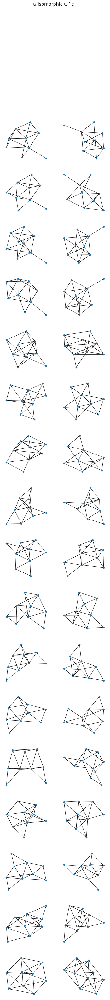

In [155]:
demonstrate(first,2,title='G isomorphic G^c')

### same on top b 10v

In [ ]:
vertices = 10
h_list = []
f = open('/home/dmitrii/Documents/TI lab/Graphs/graph'+str(vertices), 'r')
graphs=[]
cur_graph={}
for index,line in tqdm(enumerate(f)):
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
        h = Graph(cur_graph).adjacency_dict()
        c,h_d = check_cdc(h,True)
        h_d = hypergraph_to_graph(h_d)
        cc = check_cdc(h_d.adjacency_dict())
        if check_for_many_twin_vertices(Graph(h).edges(),vertices)  or check_for_many_twin_vertices(h_d.edges(),vertices):
            continue
        if c:
            h_list.append(Graph(h).edges())
            h_list.append(h_d.edges())

98797524it [13:14:40, 4304.01it/s]

### Same on 10 v

In [ ]:
vertices = 10
f = open('/home/dmitrii/Documents/TI lab/Graphs/graph'+str(vertices), 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
        visited={'1':True}
        color={'1':0}
        if isBipartite(cur_graph,visited,color):
            continue
        graphs.append(cur_graph)
        h_bar = Graph(cur_graph).make_antigraph().edges()
        h = cur_graph
        if check_cdc(cur_graph):
            _,h_d = check_cdc(h,True)
            h_d = hypergraph_to_graph(h_d).edges()
            h_c_bar = hypergraph_to_graph(h_d).make_antigraph().edges()
            _, h_bar_c = check_cdc(h_bar,True)
            h_bar_c = hypergraph_to_graph(h_bar_c).edges()
            h = Graph(h).edges()
            if check_cdc(h_bar) and check_cdc(h_c_bar):
                    #print("second pair")
                    third=[]
                    third.append(h)
                    third.append(h_d)
                    third.append(h_bar)
                    third.append(h_c_bar)
                    third.append(h_bar_c)
                    #demonstrate(third,5)
                    if not isomorphic(h_c_bar,h_bar_c,vertices):
                        print('!!!!!!')
                        second=[]
                        second.append(h)
                        second.append(h_d)
                        second.append(h_bar)
                        second.append(h_c_bar)
                        second.append(h_bar_c)
                        demonstrate(second,5)

## Simmetrical difference

### bi_cdc_graphs and 2_clique_cdc_\bar

In [ ]:
vertices = 10
f = open('/home/dmitrii/Documents/TI lab/Graphs/bigraph'+str(vertices), 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
        graphs.append(cur_graph)

In [ ]:
h_2_s = []
h_2_bar = []
for h in graphs:
    h = Graph(h).make_antigraph().edges()
    check, size, _ = check_two_cliques(h,vertices)
    c,h_d = check_cdc(h,True)
    h_d = hypergraph_to_graph(h_d).edges()
    if size == vertices - size and c and not check_for_many_twin_vertices(h,vertices) and not check_for_many_twin_vertices(h_d,vertices):
        h_2_s.append(Graph(h).edges())
        h_2_bar.append(Graph(h).make_antigraph().edges())
plot_graphs(h_2_s, figsize=14, dotsize=20)
plot_graphs(h_2_bar, figsize=14, dotsize=20)

In [ ]:
h_bi_s = []
h_bi_bar = []
for h in graphs:
    c,h_d = check_cdc(h,True)
    h_d = hypergraph_to_graph(h_d).edges()
    if c and not check_for_many_twin_vertices(h,vertices) and not check_for_many_twin_vertices(h_d,vertices):
        h_bi_s.append(Graph(h).edges())
        h_bi_bar.append(Graph(h).make_antigraph().edges())
plot_graphs(h_bi_s, figsize=14, dotsize=20)
plot_graphs(h_bi_bar, figsize=14, dotsize=20)

In [ ]:
diff1 = [item for item in h_2_bar if not any(list(map(lambda x: isomorphic(x,item,vertices),h_bi_s)))]
diff2 = [item for item in h_bi_s if not any(list(map(lambda x: isomorphic(x,item,vertices),h_2_bar)))]

In [ ]:
n = len(diff1)
fig = plt.figure(figsize=(20,20))
fig.patch.set_facecolor('white') # To make copying possible (white background)

k = int(np.sqrt(n))
for i in range(n):
    plt.subplot(k+1,k+1,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in diff1[i]:            
        g.add_edge(e[0],e[1])
    try:
        nx.draw(g, pos=nx.bipartite_layout(g, nx.bipartite.sets(g)[0]))
    except:
        nx.draw_kamada_kawai(g, node_size=dotsize)
    print('.', end='')

In [ ]:
n = len(diff2)
fig = plt.figure(figsize=(20,20))
fig.patch.set_facecolor('white') # To make copying possible (white background)

k = int(np.sqrt(n))
for i in range(n):
    plt.subplot(k+1,k+1,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in diff2[i]:            
        g.add_edge(e[0],e[1])
    try:
        nx.draw(g, pos=nx.bipartite_layout(g, nx.bipartite.sets(g)[0]))
    except:
        nx.draw_kamada_kawai(g, node_size=dotsize)
    print('.', end='')

### ON TWO CLIQUES

In [ ]:
def bip_from_two_cliques(graph,clique1,clique2,n):
    actual_g = graph.adjacency_dict().copy()
    for vertex in clique1:
        actual_g[vertex] = sorted(list(set(actual_g[vertex]) - set(clique1)))
    for vertex in clique2:
        actual_g[vertex] = sorted(list(set(actual_g[vertex]) - set(clique2)))
    return Graph(actual_g).edges()

In [ ]:
def check_two_cliques(graph,n):
    actual_g = full_graph(Graph(graph),n)
    max_cliques = actual_g.max_cliques()
    for clique in max_cliques:
        if len(clique) == 1 or len(clique) >= n-1:
            continue
        vertics = set(map(str,list(range(0,n))))
        addition = vertics - clique
        #print(clique,vertics,addition)
        if check_for_anticlique(actual_g.make_antigraph(),addition):
            return True,min(len(clique),len(addition)),bip_from_two_cliques(actual_g,clique,addition,n)
    return False,0,[]

In [ ]:
vertices = 9
f = open('/home/dmitrii/Documents/TI lab/Graphs/graph'+str(vertices), 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
        graphs.append(cur_graph)

In [ ]:
h_s = []
h_cdc_s = []
h_list = []
type_of_split = {}
type_of_split_n = {}
for h in graphs:
    c,l,h_n = check_two_cliques(h,vertices)
    if check_cdc(h) and c:
        h_s.append(Graph(h).edges())
        h_list.append(Graph(h).edges())
        _,h_d = check_cdc(h,True)
        h_cdc_s.append(hypergraph_to_graph(h_d).edges())
        h_list.append(hypergraph_to_graph(h_d).edges())
        ###
        if type_of_split_n.get(l) == None:
            type_of_split_n[l] = []
        type_of_split_n[l].append(Graph(h_n).edges())
        type_of_split_n[l].append(hypergraph_to_graph(h_d).edges())
        ###
        if type_of_split.get(l) == None:
            type_of_split[l] = []
        type_of_split[l].append(Graph(h).edges())
        type_of_split[l].append(hypergraph_to_graph(h_d).edges())
        ###
plot_graphs(h_s, figsize=14, dotsize=20)
plot_graphs(h_cdc_s, figsize=14, dotsize=20)

#### SIFT PIcture

In [ ]:
for key in type_of_split.keys():
    print(key,vertices-key)
    pic_sifted = []
    n_graphs = []
    for index,(i,k) in enumerate2(zip(type_of_split_n[key][0::2], type_of_split_n[key][1::2]),start=0,step=2):
        if  not check_for_many_twin_vertices(type_of_split[key][index],vertices) and not check_for_many_twin_vertices(type_of_split[key][index+1],vertices):
            pic_sifted.append(i)
            pic_sifted.append(k)
            n_graphs.append(type_of_split[key][index])
            n_graphs.append(type_of_split[key][index+1])
    n = len(pic_sifted)
    fig = plt.figure(figsize=(2*3,3*n//2))
    fig.patch.set_facecolor('white') # To make copying possible (white background)

    for i in range(n):
        plt.subplot(n//2,2,i+1)
        g = nx.Graph() # Generate a Networkx object

        for e in pic_sifted[i]:            
            g.add_edge(e[0],e[1])
        nx.draw_kamada_kawai(g, node_size=20)
        print('.', end='')

In [ ]:
graphs[0]

In [ ]:
for i,k in zip(n_graphs[0::2], n_graphs[1::2]):
    visited={'1':True}
    color={'1':0}
    b_t = isBipartite(Graph(k).adjacency_dict(),visited,color)
    if  not b_t:
        plot_graphs([i,k], figsize=14, dotsize=20)

In [ ]:
pic_sifted = []
for i,k in zip(h_list[0::2], h_list[1::2]):
    if  not check_for_many_twin_vertices(i,vertices) and not check_for_many_twin_vertices(k,vertices):
        pic_sifted.append(i)
        pic_sifted.append(k)
n = len(pic_sifted)
fig = plt.figure(figsize=(2*3,3*n//2))
fig.patch.set_facecolor('white') # To make copying possible (white background)

for i in range(n):
    plt.subplot(n//2,2,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in pic_sifted[i]:            
        g.add_edge(e[0],e[1])
    nx.draw_kamada_kawai(g, node_size=20)
    print('.', end='')

### Check if h^d from two cliques -> h bip

In [ ]:
vertices = 6
f = open('/home/dmitrii/Documents/TI lab/Graphs/bigraph'+str(vertices), 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
        graphs.append(cur_graph)

In [ ]:
h_s = []
h_cdc_s = []
h_list = []
for h in graphs:
    h_d
    if check_cdc(h):
        h_s.append(Graph(h).edges())
        h_list.append(Graph(h).edges())
        _,h_d = check_cdc(h,True)
        h_cdc_s.append(hypergraph_to_graph(h_d).edges())
        h_list.append(hypergraph_to_graph(h_d).edges())
plot_graphs(h_s, figsize=14, dotsize=20)
plot_graphs(h_cdc_s, figsize=14, dotsize=20)

### Clique and Route

In [ ]:
def check_clique_n_path(graph,n):
    actual_g = full_graph(Graph(graph),n)
    max_cliques = actual_g.max_cliques()
    for clique in max_cliques:
        vertics = set(map(str,list(range(0,n))))
        addition = vertics - clique
        #print(clique,vertics,addition)
        if len(addition) == 0:
            return True
        if find_longest_path(full_graph(actual_g.get_subgraph(addition),n).edges(),n) >= len(addition):
            return True
    return False

In [ ]:
check_clique_n_path(hypergraph_to_graph([['0','1','2'],['4','5','3']]).edges(),6)

In [ ]:
vertices = 8
f = open('/home/dmitrii/Documents/TI lab/Graphs/graph'+str(vertices), 'r')
graphs=[]
cur_graph={}
for index,line in enumerate(f):
    if index%(vertices+2)==0:
        continue
    if index%(vertices+2)==1:
        cur_graph={}
    if vertices+1>=index%(vertices+2)>=2:
        head,tails = line.split(":")
        cur_graph[str(head.split()[0])] = tails[:-2].split()
    if index%(vertices+2) == vertices+1:
        graphs.append(cur_graph)

In [ ]:
h_s = []
h_cdc_s = []
h_list = []
for h in graphs:
    if check_cdc(h) and check_clique_n_path(h,vertices):
        h_s.append(Graph(h).edges())
        h_list.append(Graph(h).edges())
        _,h_d = check_cdc(h,True)
        h_cdc_s.append(hypergraph_to_graph(h_d).edges())
        h_list.append(hypergraph_to_graph(h_d).edges())
plot_graphs(h_s, figsize=14, dotsize=20)
plot_graphs(h_cdc_s, figsize=14, dotsize=20)

In [ ]:
n = len(h_list)
fig = plt.figure(figsize=(2*3,3*n//2))
fig.patch.set_facecolor('white') # To make copying possible (white background)

for i in range(n):
    plt.subplot(n//2,2,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in h_list[i]:            
        g.add_edge(e[0],e[1])
    nx.draw_kamada_kawai(g, node_size=20)
    print('.', end='')

#### SIFT PIcture

In [ ]:
pic_sifted = []
for i,k in zip(h_list[0::2], h_list[1::2]):
    if  not check_for_many_twin_vertices(i,vertices) and not check_for_many_twin_vertices(k,vertices):
        pic_sifted.append(i)
        pic_sifted.append(k)
n = len(pic_sifted)
fig = plt.figure(figsize=(2*3,3*n//2))
fig.patch.set_facecolor('white') # To make copying possible (white background)

for i in range(n):
    plt.subplot(n//2,2,i+1)
    g = nx.Graph() # Generate a Networkx object

    for e in pic_sifted[i]:            
        g.add_edge(e[0],e[1])
    nx.draw_kamada_kawai(g, node_size=20)
    print('.', end='')

# Check subtansvertial of specific graphs

In [ ]:
vertices = 5
graphs = Create_Graphs(vertices)

In [ ]:
def check_transversal(hypergraph):
    graph = hypergraph_to_graph(hypergraph).edges()
    g = nx.Graph()
    for e in Graph(graph).edges():            
        g.add_edge(e[0],e[1])
    all_cliques= nx.enumerate_all_cliques(g)
    triad_cliques=[x for x in all_cliques if len(x)==3 ]
    tri_diff = set(map(lambda x: str(sorted(x)),triad_cliques)) - set(map(lambda x: str(sorted(x)),hypergraph))
    if len(set(map(lambda x: str(sorted(x)),triad_cliques)) - set([str(sorted(list(x))) for x in hypergraph if len(x) == 3])) > 0:
        print(tri_diff)
        return False
    return True

In [ ]:
h_s = []
h_cdc_s = []
h_list = []
for h in graphs:
    #h = Graph(h).make_antigraph().adjacency_dict()
    if not check_cdc(h):
        _,h_d = check_cdc(h,True)
        if check_transversal(h_d):
            h_s.append(Graph(h).edges())
            h_list.append(Graph(h).edges())
            h_cdc_s.append(hypergraph_to_graph(h_d).edges())
            h_list.append(hypergraph_to_graph(h_d).edges())
plot_graphs(h_s, figsize=14, dotsize=20)
plot_graphs(h_cdc_s, figsize=14, dotsize=20)

In [ ]:
h = [['1','4'],['1','6'],['1','8'],['3','2'],['3','6'],['3','8'],['5','2'],['5','4'],['5','8'],['7','2'],['7','4'],['7','6']]
c,h_d = check_cdc(h,True)
plot_graphs([h,hypergraph_to_graph(h_d).edges()], figsize=14, dotsize=20)
print(c,check_transversal(h_d))

In [ ]:
#%history -g -f Task

# SUBTRANSVERSAL CRITERIA

In [210]:
def covering_check(S,selection,H):
    selection_v = set()
    for edge in selection:
        selection_v |= edge
    selection_v -= S
    for edge in H:
        if edge.issubset(selection_v):
            return True
    return False
# False - not_covering exists True - not covering not exists -> False - transv, True - subtransvers
def subselection(edges,S_last,S_took,H):
    if len(S_last) == 0:
        if not covering_check(S_took | S_last,edges,H):
            #print(edges)
            return False
        return True
    Took_vertex = next(iter(S_last))
    S_last.remove(Took_vertex)
    S_took.add(Took_vertex)
    _S = S_took | S_last
    _S.remove(Took_vertex)
    for edge in H:
        if len(edge & _S) != 0 or Took_vertex not in edge:
            continue
        edges.append(edge)
        if not subselection(edges,S_last,S_took,H):
            return False
        edges.pop()
    return True
#существует ненакрывающая выборка размера size на гиперграфе H, в котором n вершин
def create_all_selections(H,n,size=None):
    if size == None:
        size = n
    for S in list(powerset(list(map(str,list(range(n)))))):
        if len(S) > size:
            return False,[]
        if len(S) == size and not subselection([],set(S),set(),H):
            return True,S
    return False,[]
print(create_all_selections([{'1', '4'}, {'3', '0', '4'}],5,2))

(True, ('0', '1'))


In [211]:
subselection([],{'1','2','5'},set(),[{'1','2'},{'2','3'},{'3','4'},{'4','5'}])

True

In [633]:
vertices = 8
graphs = Create_Graphs(vertices)
h_list = []
for g in tqdm(graphs):
    c,h_d = check_cdc(g,True)
    g=Graph(g).edges()
    g_d = hypergraph_to_graph(h_d).edges()
    # and not check_for_many_twin_vertices(Graph(g).edges(),vertices)
    if not c:
        h = Graph(g).max_cliques()
        vertices_l = list(map(str,list(range(vertices))))
        g_n = list(map(set,[edge for edge in list(itertools.combinations(vertices_l, 2)) if subselection([],set(edge),set(),h)]))
        graph = nx.Graph()
        for e in Graph(g_n).edges():            
            graph.add_edge(e[0],e[1])
        all_cliques= nx.enumerate_all_cliques(graph)
        triad_cliques=[x for x in all_cliques if len(x)==3 ]
        for triangle in triad_cliques:
            if not subselection([],set(triangle),set(),h):
                print(triangle)
                h_list.append(g)


 36%|█████████████▏                       | 4386/12346 [00:04<00:08, 969.30it/s]

['6', '2', '5']


 74%|██████████████████████████▋         | 9149/12346 [00:08<00:02, 1081.63it/s]

['6', '2', '5']


 77%|████████████████████████████▋        | 9560/12346 [00:09<00:02, 942.10it/s]

['6', '2', '5']
['6', '2', '5']


 93%|█████████████████████████████████▌  | 11519/12346 [00:11<00:00, 964.67it/s]

['6', '2', '5']


100%|███████████████████████████████████| 12346/12346 [00:12<00:00, 1017.86it/s]


In [630]:
len(h_list)

5

.

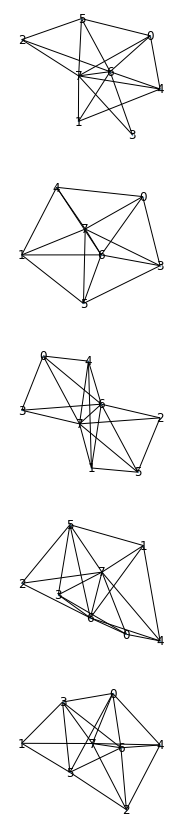

In [631]:
demonstrate(h_list,1,with_labels=True)

In [259]:
# return True if exists edge of size=size+1, that all subedges of size=size are transversal while edge is subtransversal
def check_transversal2(graph,n,size):
    hypergraph = list(map(set,graph))
    vertices_l = list(map(str,list(range(n))))
    edges_little = list(map(set,[edge for edge in list(itertools.combinations(vertices_l, size)) if not subselection([],set(edge),set(),hypergraph)]))
    edges_big = [edge for edge in list(itertools.combinations(vertices_l, size+1)) if subselection([],set(edge),set(),hypergraph)]
    #print(edges_little,edges_big)
    if edges_big==[]:
        return False,[]
    for edge in edges_big:
        edge_true = set(edge)
#         ###
#         print(edge)
#         if edge == ('0', '1', '4'):
#             print(all(map(lambda x: set(x) in edges_little,list(itertools.combinations(edge_true, len(edge_true)-1)))))
#             print(list(itertools.combinations(edge_true, len(edge_true)-1)))
#             for i in list(itertools.combinations(edge_true, len(edge_true)-1)):
#                 print(set(i) in edges_little)
#         ###
        if all(map(lambda x: x in edges_little,list(itertools.combinations(edge_true, len(edge_true)-1)))):
            return True, edge
    return False, []

In [260]:
check_transversal2([{'0','3'},{'0','5'},{'0','7'},{'2','1'},{'2','5'},{'2','7'},{'4','1'},{'4','3'},{'4','7'},{'6','1'},{'6','3'},{'6','5'}],8,2)

(False, [])

In [261]:
check_transversal2([{'0','1'},{'1','2'},{'2','3'},{'3','4'}],5,2)

(False, [])

In [268]:
vertices = 8
graphs = Create_Graphs(vertices)

In [269]:
h_s = []
h_cdc_s = []
h_list = []
h_list_of_lists = [[] for i in range(vertices)]

for h in graphs:
    #h = Graph(h).make_antigraph().adjacency_dict()
    c,h_d = check_cdc(h,True)
    if not c:
        size = 2
        subtransv,S = check_transversal2(Graph(h).edges(),vertices,size)
        #if subtransv:
            #print(h_d,S)
        while subtransv:
                print(subtransv)
                size+=1
                subtransv,S = check_transversal2(Graph(h).edges(),vertices,size)
        subtransv,S = check_transversal2(Graph(h).edges(),vertices,size-1)
        h_list_of_lists[size].append(Graph(h).edges())
        h_list_of_lists[size].append(hypergraph_to_graph(h_d).edges())
        if size >=3:
            print(h,h_d,subtransv,S)
        """
        if not subtransv:
            h_s.append(Graph(h).edges())
            h_list.append(Graph(h).edges())
            h_cdc_s.append(hypergraph_to_graph(h_d).edges())
            h_list.append(hypergraph_to_graph(h_d).edges())
            size = 4
            subtransv,S = create_all_selections(h_d,vertices,size)
            while not subtransv:
                size+=1
                subtransv,S = create_all_selections(h_d,vertices,size)
            h_list_of_lists[size-1].append(Graph(h).edges())
            h_list_of_lists[size-1].append(hypergraph_to_graph(h_d).edges())
        """
plot_graphs(h_s, figsize=14, dotsize=20)
plot_graphs(h_cdc_s, figsize=14, dotsize=20)

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

In [219]:
check_transversal2(Graph({'0': ['2', '4', '5', '6'], '1': ['3', '4', '5'], '2': ['0', '4', '6'], '3': ['1', '5', '6'], '4': ['0', '1', '2', '6'], '5': ['0', '1', '3'], '6': ['0', '2', '3', '4']}).edges(),6,2)

(False, [])

In [217]:
h_s = []
h_cdc_s = []
h_list = []
h_list_of_lists = [[] for i in range(vertices)]

for h in graphs:
    #h = Graph(h).make_antigraph().adjacency_dict()
    if not check_cdc(h):
        _,h_d = check_cdc(h,True)
        size = 2
        subtransv,S = create_all_selections(list(map(set,Graph(h).edges())),vertices,size)
        #if subtransv:
            #print(h_d,S)
        while subtransv:
                size+=1
                subtransv,S = create_all_selections(h_d,vertices,size)
        subtransv,S = create_all_selections(h_d,vertices,size-1)
        #print(h_d,S,size)
        h_list_of_lists[size-1].append(Graph(h).edges())
        h_list_of_lists[size-1].append(hypergraph_to_graph(h_d).edges())
        if len(S) == 3:
            print(h,h_d,subtransv,S,size)
        """
        if not subtransv:
            h_s.append(Graph(h).edges())
            h_list.append(Graph(h).edges())
            h_cdc_s.append(hypergraph_to_graph(h_d).edges())
            h_list.append(hypergraph_to_graph(h_d).edges())
            size = 4
            subtransv,S = create_all_selections(h_d,vertices,size)
            while not subtransv:
                size+=1
                subtransv,S = create_all_selections(h_d,vertices,size)
            h_list_of_lists[size-1].append(Graph(h).edges())
            h_list_of_lists[size-1].append(hypergraph_to_graph(h_d).edges())
        """
plot_graphs(h_s, figsize=14, dotsize=20)
plot_graphs(h_cdc_s, figsize=14, dotsize=20)

{'0': ['4', '6'], '1': ['5', '6'], '2': ['5'], '3': [], '4': ['0'], '5': ['1', '2'], '6': ['0', '1']} [{'5', '0', '3', '6'}, {'5', '3', '4', '6'}, {'5', '0', '3', '1'}, {'2', '1', '0', '3'}, {'2', '6', '4', '1', '3'}] True ('0', '2', '4') 4
{'0': ['4', '6'], '1': ['5', '6'], '2': ['5'], '3': [], '4': ['0'], '5': ['1', '2', '6'], '6': ['0', '1', '5']} [{'5', '0', '3'}, {'5', '4', '3', '6'}, {'2', '0', '3', '6'}, {'2', '1', '0', '3'}, {'2', '4', '3', '6'}] True ('0', '1', '4') 4
{'0': ['4', '6'], '1': ['5', '6'], '2': ['5'], '3': [], '4': ['0', '6'], '5': ['1', '2'], '6': ['0', '1', '4']} [{'5', '6', '3'}, {'5', '1', '0', '3'}, {'5', '4', '1', '3'}, {'2', '6', '1', '3'}, {'2', '1', '0', '3'}, {'2', '4', '1', '3'}] True ('0', '4', '6') 4
{'0': ['4', '6'], '1': ['5', '6'], '2': ['5'], '3': ['6'], '4': ['0'], '5': ['1', '2'], '6': ['0', '1', '3']} [{'6', '0', '5'}, {'6', '4', '5'}, {'6', '2', '1', '0'}, {'6', '2', '4', '1'}, {'5', '1', '0', '3'}, {'2', '1', '0', '3'}] True ('0', '2', '4') 4

{'0': ['3', '5'], '1': ['4', '5'], '2': ['5', '6'], '3': ['0', '6'], '4': ['1', '6'], '5': ['0', '1', '2'], '6': ['2', '3', '4']} [{'0', '5', '4', '6'}, {'0', '5', '1', '6'}, {'5', '3', '4', '6'}, {'5', '3', '1', '6'}, {'5', '2', '4', '3'}, {'2', '6', '1', '0'}, {'2', '4', '1', '0', '3'}] True ('0', '1', '3') 4
{'0': ['3', '5'], '1': ['4', '5'], '2': ['5', '6'], '3': ['0', '6'], '4': ['1', '6'], '5': ['0', '1', '2', '6'], '6': ['2', '3', '4', '5']} [{'5', '4', '3'}, {'6', '0', '1'}, {'5', '6', '4', '0'}, {'5', '3', '1', '6'}, {'2', '4', '1', '0', '3'}] True ('0', '2', '3') 4
{'0': ['3', '5'], '1': ['4', '5', '6'], '2': ['5', '6'], '3': ['0', '6'], '4': ['1'], '5': ['0', '1', '2', '6'], '6': ['1', '2', '3', '5']} [{'5', '3', '4'}, {'5', '3', '1'}, {'6', '0', '4'}, {'6', '0', '1'}, {'2', '1', '0', '3'}] True ('0', '2', '3') 4
{'0': ['3', '5', '6'], '1': ['4', '5'], '2': ['5'], '3': ['0', '6'], '4': ['1', '6'], '5': ['0', '1', '2', '6'], '6': ['0', '3', '4', '5']} [{'6', '5', '4'}, {'6', 

{'0': ['3', '4', '5'], '1': ['4', '5'], '2': ['5', '6'], '3': ['0', '4', '6'], '4': ['0', '1', '3', '6'], '5': ['0', '1', '2', '6'], '6': ['2', '3', '4', '5']} [{'5', '4'}, {'6', '0', '1'}, {'5', '1', '3'}, {'2', '0', '4', '1'}, {'2', '0', '3', '1'}] True ('0', '2', '5') 4
{'0': ['3', '4', '5'], '1': ['4', '5', '6'], '2': ['5', '6'], '3': ['0', '4', '6'], '4': ['0', '1', '3'], '5': ['0', '1', '2', '6'], '6': ['1', '2', '3', '5']} [{'5', '6', '4'}, {'5', '4', '3'}, {'5', '1', '3'}, {'6', '1', '0'}, {'6', '4', '0'}, {'2', '1', '0', '3'}] True ('0', '1', '5') 4
{'0': ['3', '4', '5'], '1': ['4', '5', '6'], '2': ['5', '6'], '3': ['0', '4', '6'], '4': ['0', '1', '3', '6'], '5': ['0', '1', '2'], '6': ['1', '2', '3', '4']} [{'6', '5', '4'}, {'6', '5', '0'}, {'6', '5', '3'}, {'2', '4', '5'}, {'6', '0', '2', '1'}, {'2', '0', '4', '1'}, {'2', '0', '3', '1'}, {'2', '5', '1', '3'}] True ('0', '1', '4') 4
{'0': ['3', '4', '5', '6'], '1': ['4', '5', '6'], '2': ['5', '6'], '3': ['0', '4'], '4': ['0', 

<Figure size 1008x1008 with 0 Axes>

<Figure size 1008x1008 with 0 Axes>

# CDC CHECK

In [ ]:
vertices=10
check_cdc([{'0','2'},{'2','4'},{'4','6'},{'1','3'},{'3','5'},{'5','7'},{'2','8'},{'3','8'},{'8','9'}],True)

In [ ]:
check_for_many_twin_vertices(hypergraph_to_graph([{'1', '2', '4', '7'},
  {'1', '2', '5', '7'},
  {'1', '2', '4', '6'},
  {'1', '2', '5', '6'},
  {'1', '3', '4', '6'},
  {'1', '3', '5', '6'},
  {'0', '2', '4', '7'},
  {'0', '2', '4', '6'}]).edges(),8)

In [ ]:
13 35 57  24 46 68  39 49  910